### DLPG on Snapbot

In [1]:
import numpy as np
import torch
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'
from mujoco_parser import MuJoCoParserClass
from pid import PID_ControllerClass
from grp import GaussianRandomPathClass,kernel_se,kernel_levse
from snapbot_util import get_snapbot_q,wait_until_snapbot_on_ground,snapbot_rollout
from util import soft_squash_multidim,get_colors,r2rpy,plot_topdown_trajectory_and_joint_trajectory,\
    get_anchors_from_traj,torch2np,np2torch,NormalizerClass,whitening,whitening_torch,ikdpp,TicTocClass
from dlpg import DeepLatentPolicyGradientClass
print ("Done.")

Done.


### Hyperparameters

In [2]:
# Basic configuration
n_update              = 1000 # total number of updates (outer loop)
n_rollout_per_update  = 5    # number of rollouts per update
dur_sec               = 1.0  # duration (sec) of a trajectory
n_traj_repeat         = 5
print_every_update    = 5
evaluate_every_update = 20
n_rollout_per_eval    = 3
DO_RENDER_WHILE_EVAL  = False
# DLPG configuration
n_anchor              = 20    # number of anchors
n_iter_per_update     = 100   # number of iterations per update
n_dpp_subset          = 50
batch_size            = 32
Q_RENORMALIZE         = True
# Reward
fwd_gain     = 1.0
side_penalty = 1.0
rot_penalty  = 0.5
print ("Done.")

Done.


### Instantiate

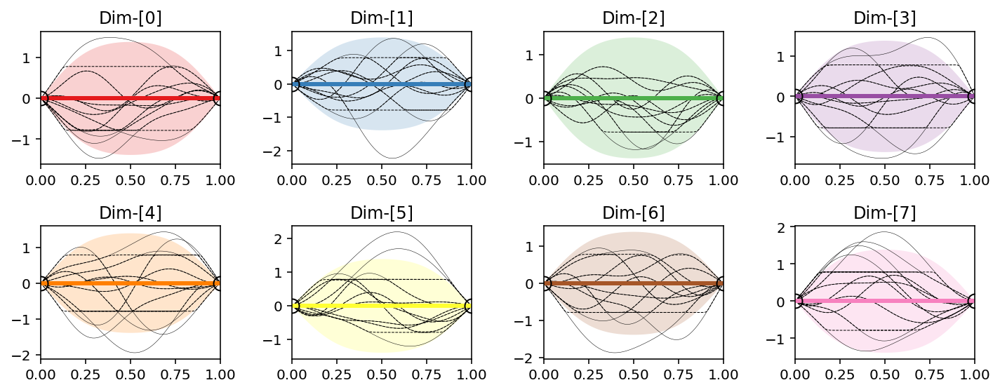

<bound method Module.parameters of DeepLatentPolicyGradientClass(
  (actv_enc): ReLU()
  (actv_dec): ReLU()
  (actv_q): Softplus(beta=1, threshold=20)
  (cvae_parameters): ParameterDict(
      (dec_00_lin_b): Parameter containing: [torch.FloatTensor of size 128]
      (dec_00_lin_w): Parameter containing: [torch.FloatTensor of size 128x2]
      (dec_01_lin_b): Parameter containing: [torch.FloatTensor of size 128]
      (dec_01_lin_w): Parameter containing: [torch.FloatTensor of size 128x128]
      (enc_00_lin_b): Parameter containing: [torch.FloatTensor of size 128]
      (enc_00_lin_w): Parameter containing: [torch.FloatTensor of size 128x160]
      (enc_01_lin_b): Parameter containing: [torch.FloatTensor of size 128]
      (enc_01_lin_w): Parameter containing: [torch.FloatTensor of size 128x128]
      (out_lin_b): Parameter containing: [torch.FloatTensor of size 160]
      (out_lin_w): Parameter containing: [torch.FloatTensor of size 160x128]
      (z_mu_lin_b): Parameter containing:

In [3]:
env = MuJoCoParserClass(name='Snapbot',rel_path='../asset/snapbot/robot_4_1245.xml',VERBOSE=False)
ss_range  = 45*np.pi/180*np.concatenate((-np.ones((env.n_torque,1)),np.ones((env.n_torque,1))),axis=1)
ss_margin = 5*np.pi/180
PID = PID_ControllerClass(
    name    = 'PID',
    k_p     = 30.0,
    k_i     = 0.1,
    k_d     = 1.0,
    dim     = env.n_torque,
    out_min = env.torque_range[:,0],
    out_max = env.torque_range[:,1])
GRP_prior = GaussianRandomPathClass(name='GRP Prior',kernel=kernel_levse)
GRP_prior.set_prior(q_init=np.zeros(env.n_torque),dur_sec=dur_sec,HZ=env.HZ,eps_sec=0.0,
                    hyp={'g':1/2,'l':1/4,'w':1e-8})
GRP_prior.plot(figsize=(10,4),subplot_rc=(2,4),tfs=12,
               ss_x_min=ss_range[:,0],ss_x_max=ss_range[:,1],ss_margin=ss_margin)
GRP_posterior = GaussianRandomPathClass(name='GRP Posterior',kernel=kernel_levse)
DLPG = DeepLatentPolicyGradientClass(
    name='DLPG',x_dim=env.n_torque*n_anchor,c_dim=0,z_dim=2,h_dims=[128,128],
    actv_enc=torch.nn.ReLU(),actv_dec=torch.nn.ReLU(),actv_q=torch.nn.Softplus(),
    actv_out=None,var_max=0.1,device='cpu')
optm = torch.optim.Adam(params=DLPG.parameters(),lr=0.001,betas=(0.9,0.99),eps=1e-4)
print (DLPG.parameters)

### Loop

In [4]:
def get_snapbot_reward(xyrad_list,fwd_gain=1.0,side_penalty=0.5,rot_penalty=0.5):
    """
        Sequence of (x,y,rad)
    """
    x_diff_mm = (xyrad_list[-1,0]-xyrad_list[0,0])*1000.0
    y_diff_mm = (xyrad_list[-1,1]-xyrad_list[0,1])*1000.0
    deg_diff  = (xyrad_list[-1,2]-xyrad_list[0,2])*180/np.pi
    reward    = fwd_gain*x_diff_mm-side_penalty*np.abs(y_diff_mm)-rot_penalty*np.abs(deg_diff)
    return reward
print ("Done.")

Done.


### Train

[0/1000] wall:[1.19]sec. [5] rollouts. Total loss:[0.519] (recon:[0.491] kl:[0.028])


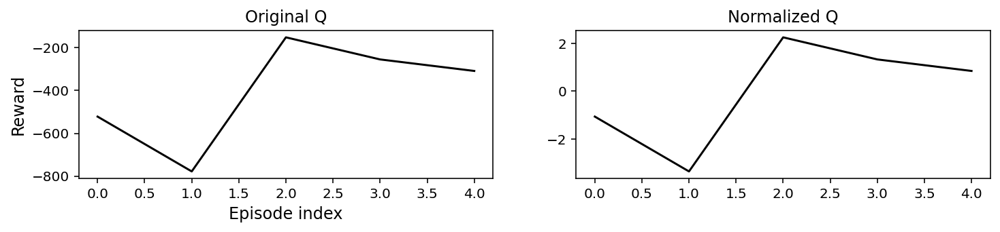

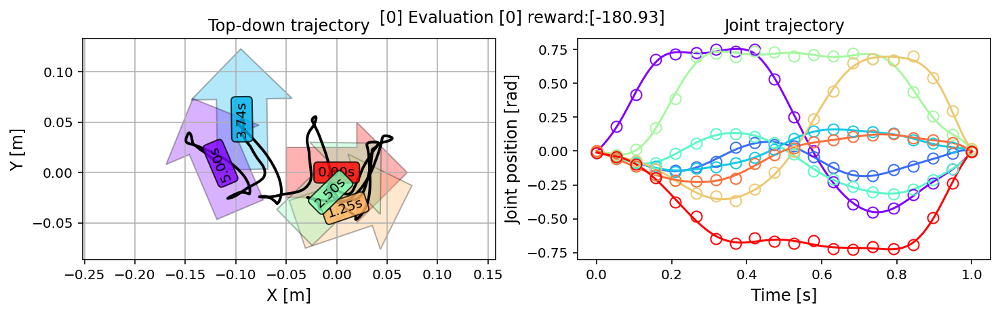

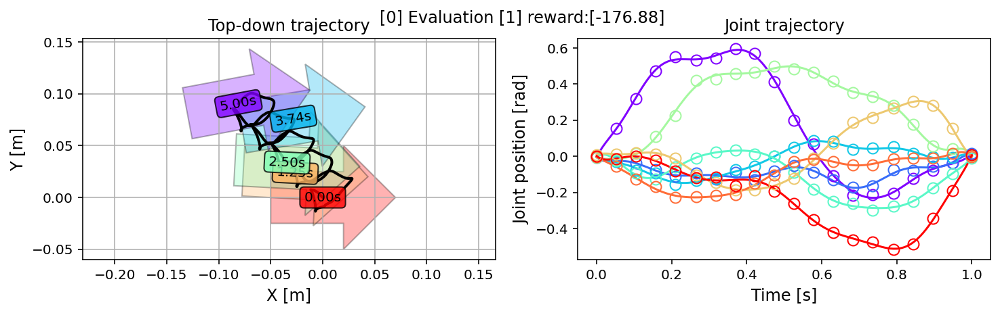

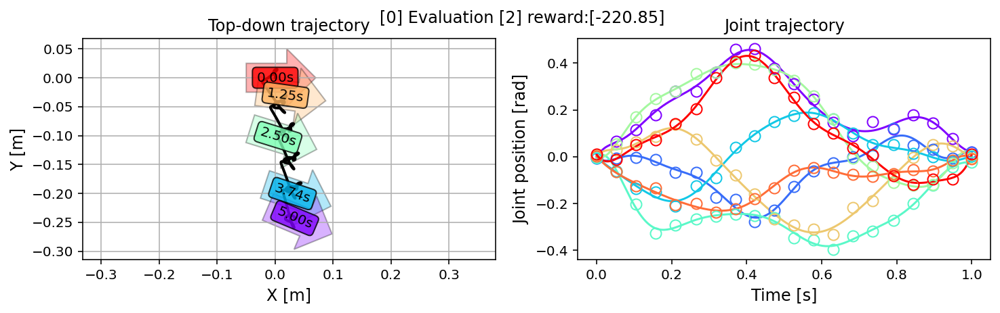

  [0/1000][Eval] reward_avg:[-192.89]
[5/1000] wall:[8.15]sec. [30] rollouts. Total loss:[3.018] (recon:[2.892] kl:[0.127])
[10/1000] wall:[13.89]sec. [55] rollouts. Total loss:[1.960] (recon:[1.842] kl:[0.119])
[15/1000] wall:[19.69]sec. [80] rollouts. Total loss:[3.008] (recon:[2.906] kl:[0.102])
[20/1000] wall:[25.47]sec. [105] rollouts. Total loss:[2.289] (recon:[2.176] kl:[0.114])


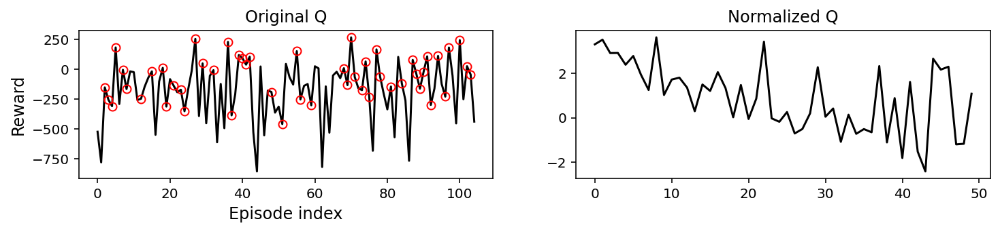

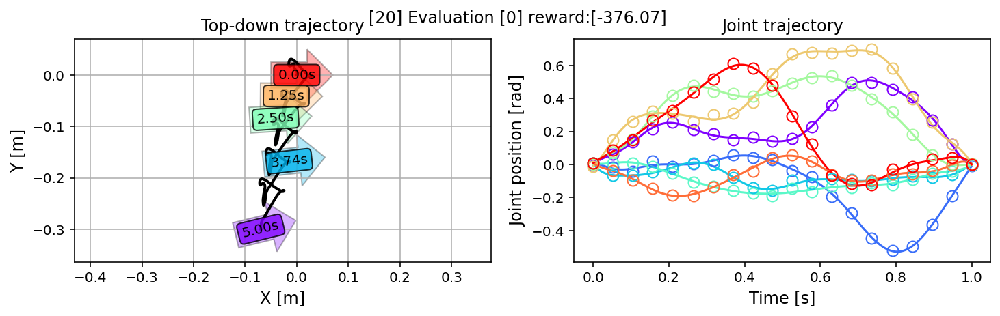

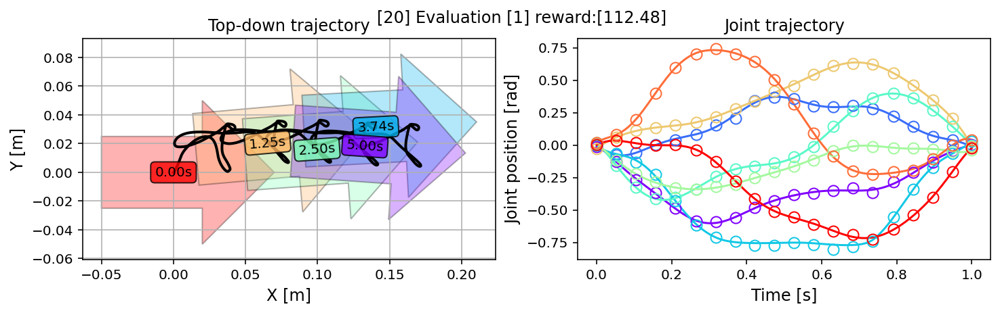

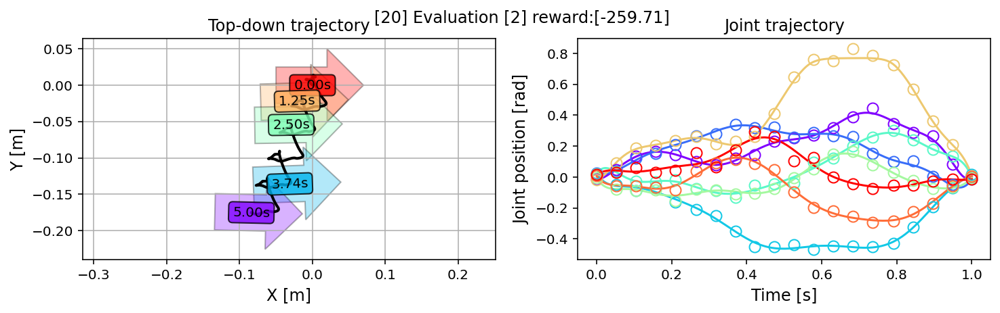

  [20/1000][Eval] reward_avg:[-174.43]
[25/1000] wall:[32.44]sec. [130] rollouts. Total loss:[1.562] (recon:[1.437] kl:[0.125])
[30/1000] wall:[38.22]sec. [155] rollouts. Total loss:[1.688] (recon:[1.563] kl:[0.125])
[35/1000] wall:[44.06]sec. [180] rollouts. Total loss:[1.164] (recon:[1.056] kl:[0.108])
[40/1000] wall:[49.97]sec. [205] rollouts. Total loss:[1.173] (recon:[1.075] kl:[0.098])


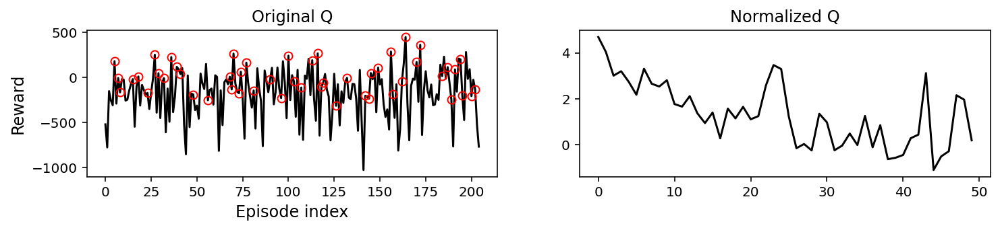

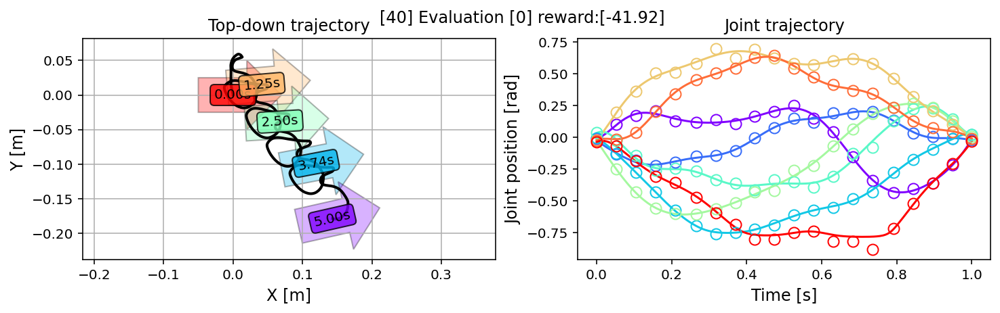

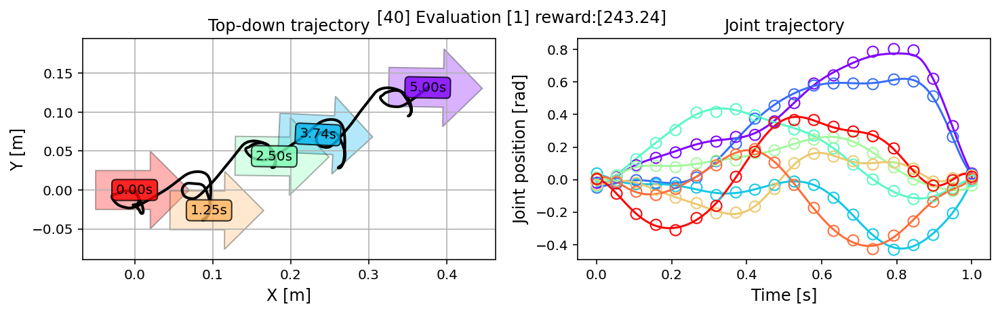

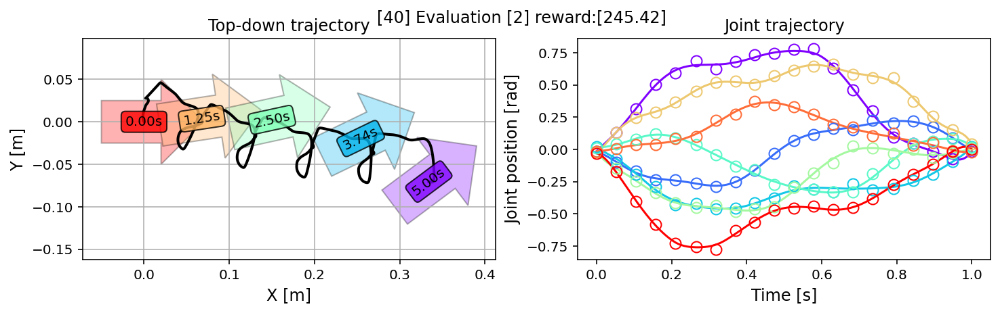

  [40/1000][Eval] reward_avg:[148.91]
[45/1000] wall:[57.00]sec. [230] rollouts. Total loss:[1.015] (recon:[0.920] kl:[0.095])
[50/1000] wall:[62.92]sec. [255] rollouts. Total loss:[1.021] (recon:[0.926] kl:[0.096])
[55/1000] wall:[68.89]sec. [280] rollouts. Total loss:[0.898] (recon:[0.808] kl:[0.090])
[60/1000] wall:[74.67]sec. [305] rollouts. Total loss:[1.229] (recon:[1.147] kl:[0.082])


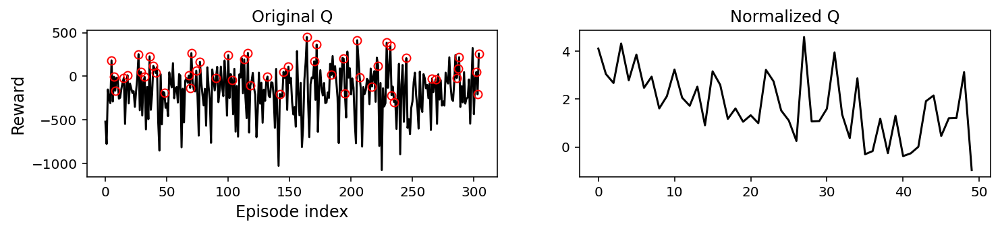

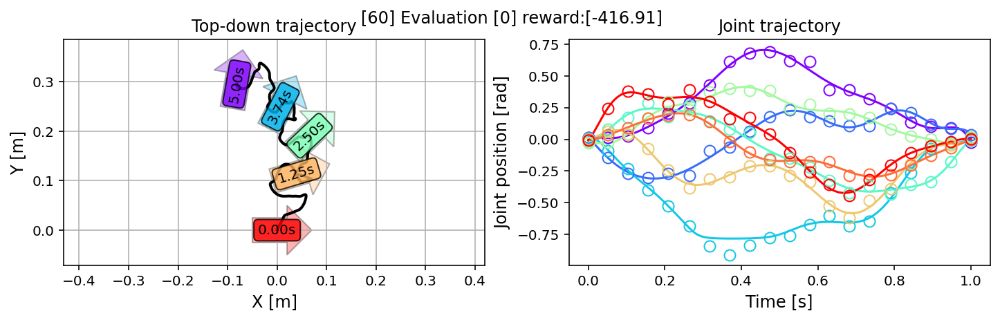

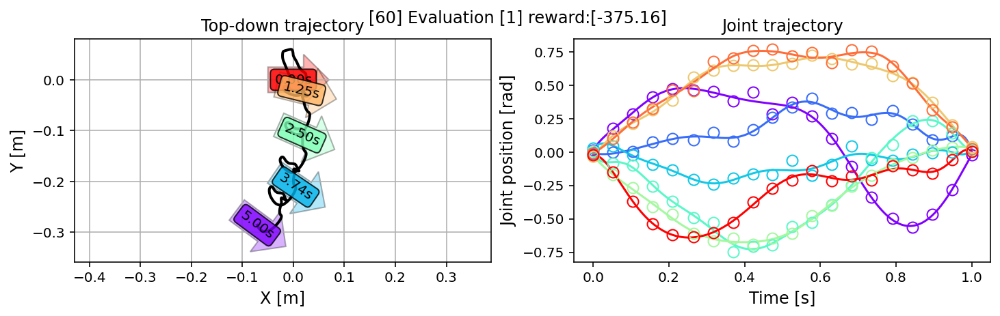

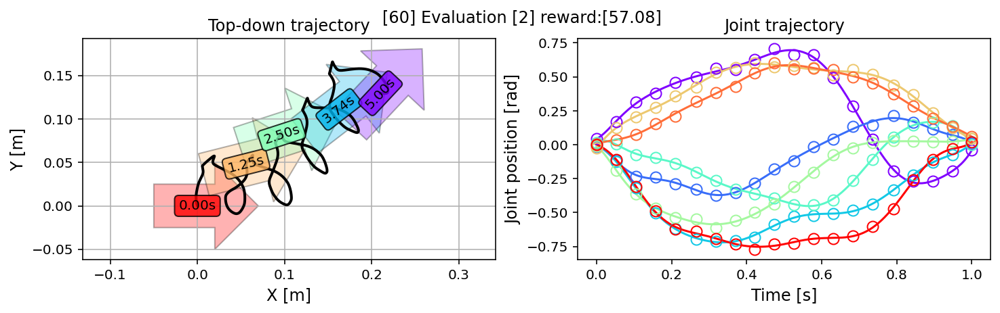

  [60/1000][Eval] reward_avg:[-245.00]
[65/1000] wall:[81.74]sec. [330] rollouts. Total loss:[1.190] (recon:[1.102] kl:[0.088])
[70/1000] wall:[87.51]sec. [355] rollouts. Total loss:[1.372] (recon:[1.280] kl:[0.092])
[75/1000] wall:[93.35]sec. [380] rollouts. Total loss:[0.872] (recon:[0.782] kl:[0.090])
[80/1000] wall:[99.15]sec. [405] rollouts. Total loss:[0.986] (recon:[0.898] kl:[0.089])


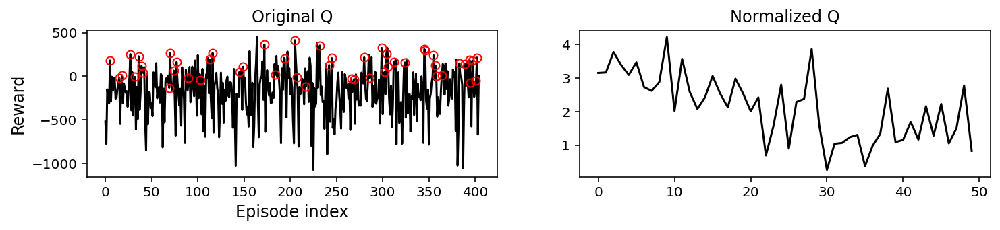

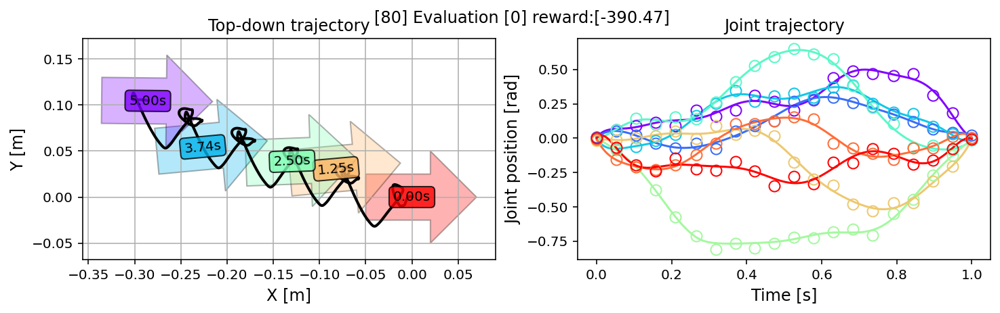

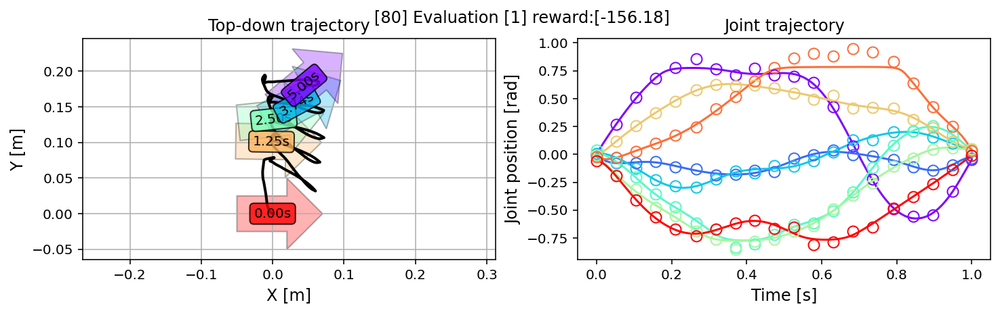

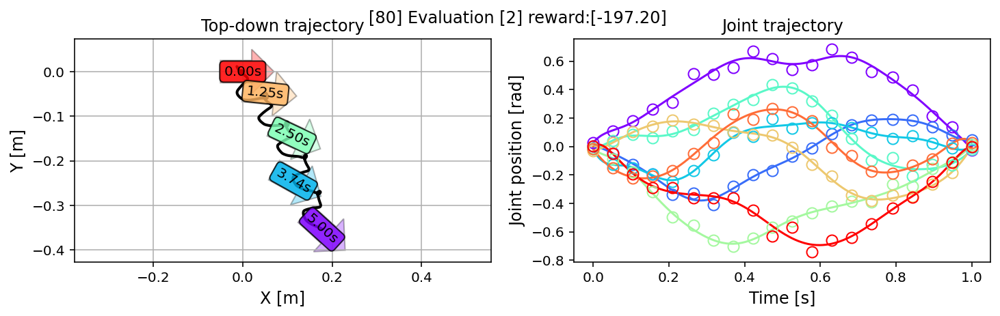

  [80/1000][Eval] reward_avg:[-247.95]
[85/1000] wall:[106.13]sec. [430] rollouts. Total loss:[0.834] (recon:[0.749] kl:[0.086])
[90/1000] wall:[112.03]sec. [455] rollouts. Total loss:[0.791] (recon:[0.706] kl:[0.085])
[95/1000] wall:[117.93]sec. [480] rollouts. Total loss:[0.652] (recon:[0.572] kl:[0.080])
[100/1000] wall:[123.78]sec. [505] rollouts. Total loss:[1.025] (recon:[0.943] kl:[0.082])


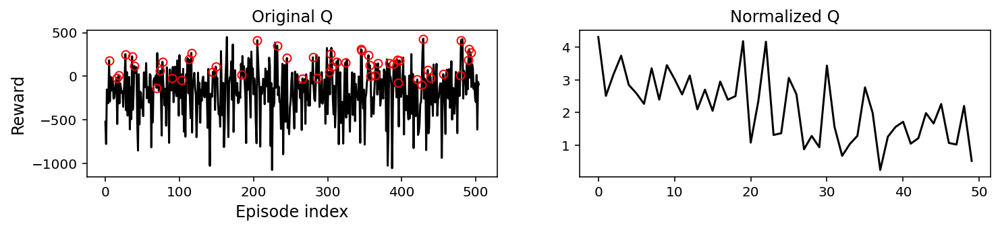

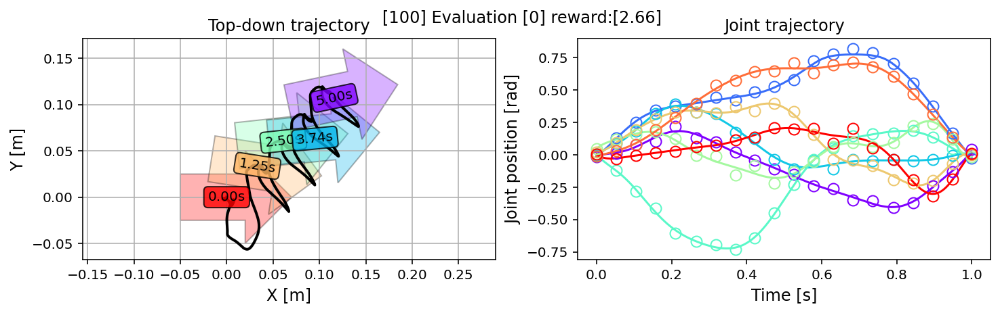

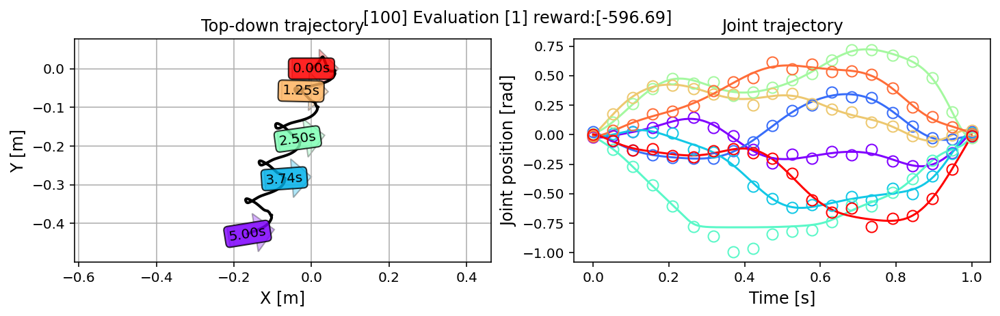

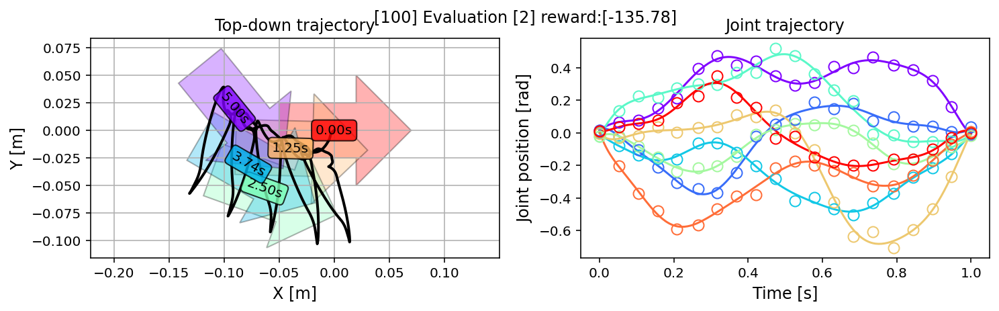

  [100/1000][Eval] reward_avg:[-243.27]
[105/1000] wall:[131.04]sec. [530] rollouts. Total loss:[0.819] (recon:[0.735] kl:[0.085])
[110/1000] wall:[136.93]sec. [555] rollouts. Total loss:[0.694] (recon:[0.608] kl:[0.086])
[115/1000] wall:[142.81]sec. [580] rollouts. Total loss:[1.355] (recon:[1.275] kl:[0.080])
[120/1000] wall:[148.69]sec. [605] rollouts. Total loss:[0.861] (recon:[0.785] kl:[0.077])


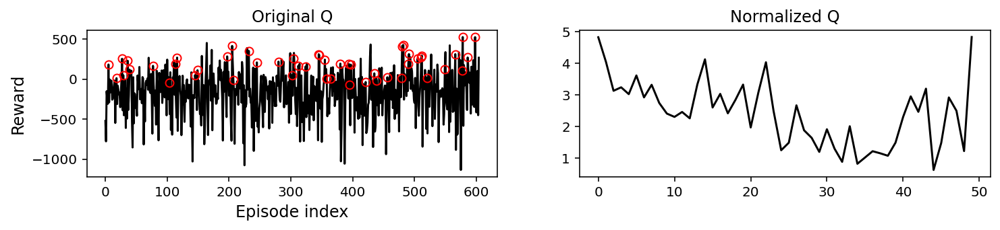

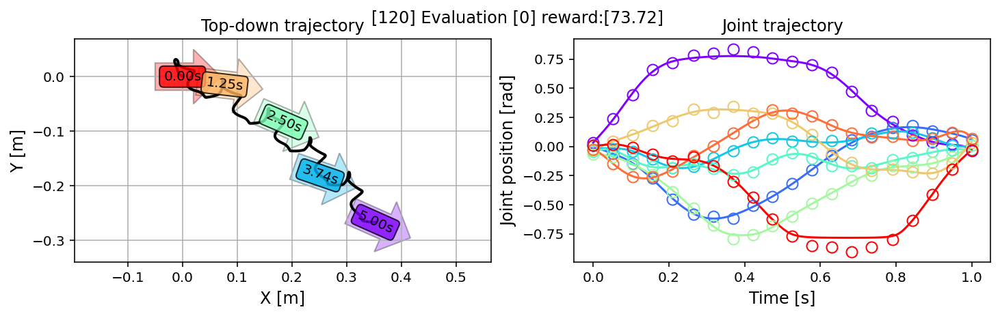

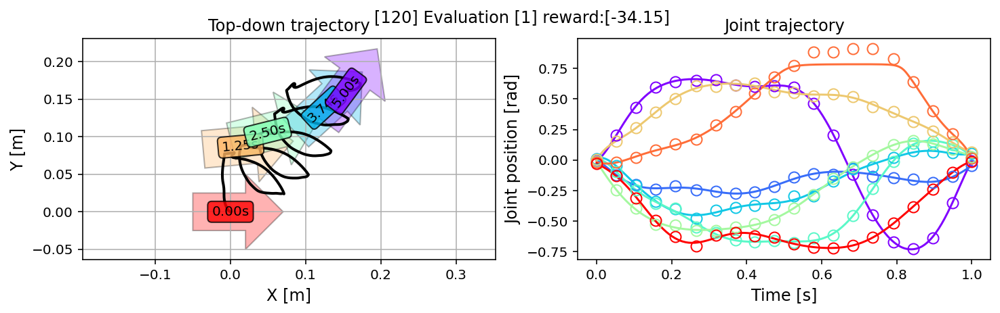

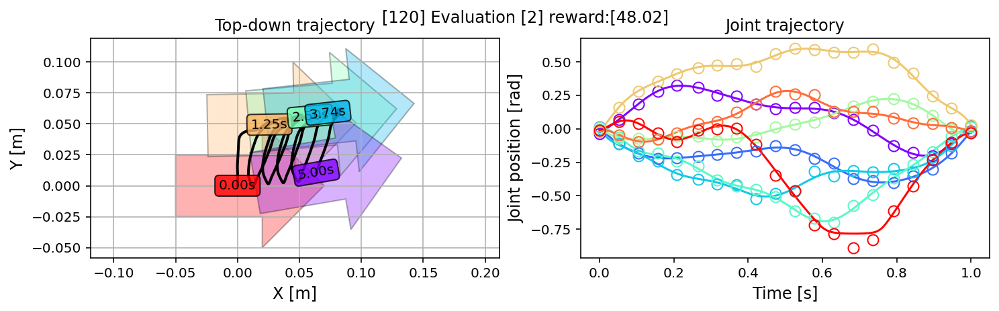

  [120/1000][Eval] reward_avg:[29.20]
[125/1000] wall:[155.71]sec. [630] rollouts. Total loss:[0.967] (recon:[0.894] kl:[0.072])
[130/1000] wall:[161.53]sec. [655] rollouts. Total loss:[0.774] (recon:[0.703] kl:[0.072])
[135/1000] wall:[167.41]sec. [680] rollouts. Total loss:[0.843] (recon:[0.767] kl:[0.076])
[140/1000] wall:[173.23]sec. [705] rollouts. Total loss:[0.856] (recon:[0.779] kl:[0.077])


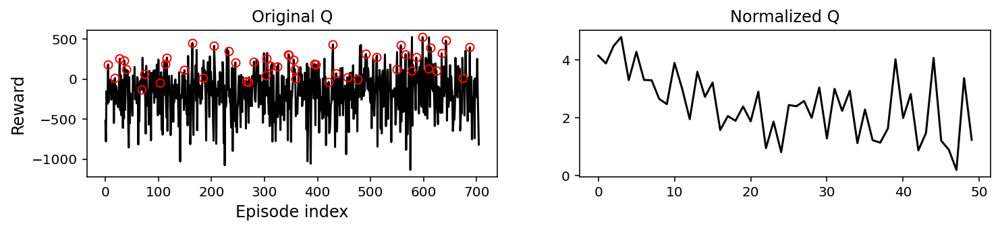

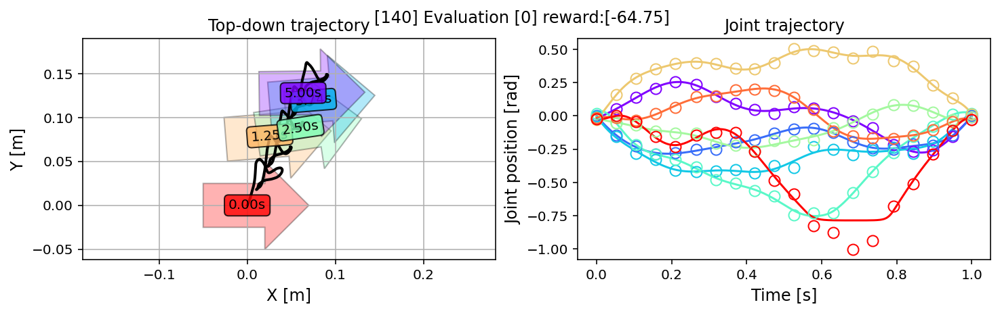

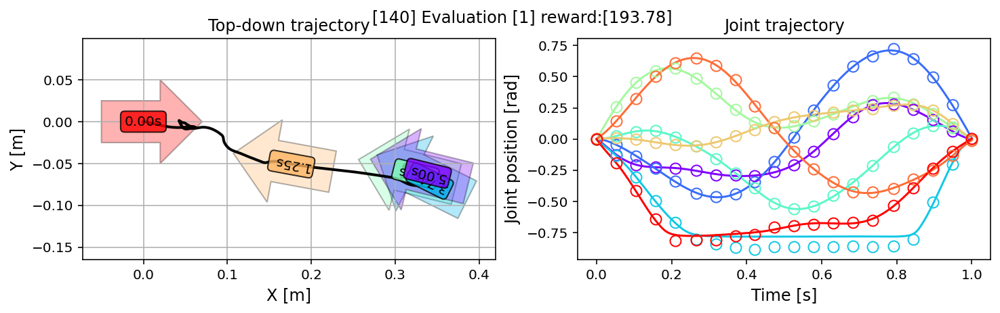

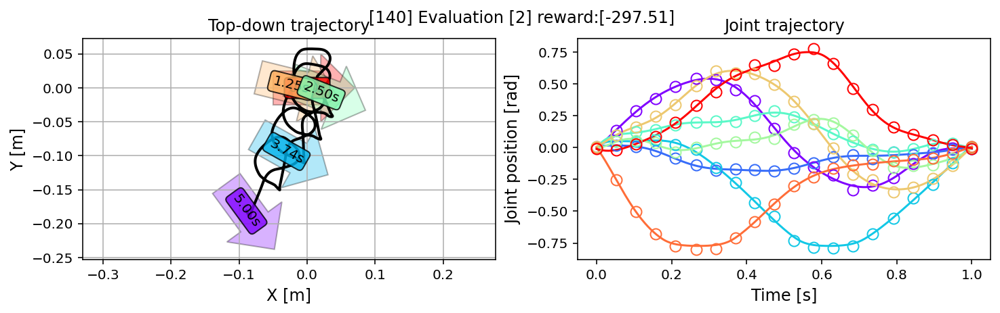

  [140/1000][Eval] reward_avg:[-56.16]
[145/1000] wall:[180.24]sec. [730] rollouts. Total loss:[0.817] (recon:[0.742] kl:[0.075])
[150/1000] wall:[186.02]sec. [755] rollouts. Total loss:[0.697] (recon:[0.620] kl:[0.077])
[155/1000] wall:[191.82]sec. [780] rollouts. Total loss:[0.603] (recon:[0.527] kl:[0.076])
[160/1000] wall:[197.66]sec. [805] rollouts. Total loss:[0.921] (recon:[0.847] kl:[0.074])


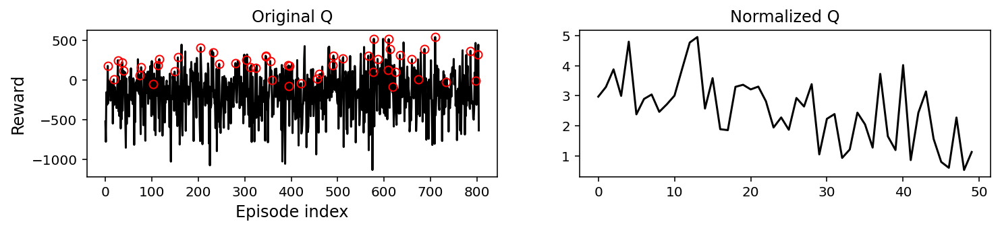

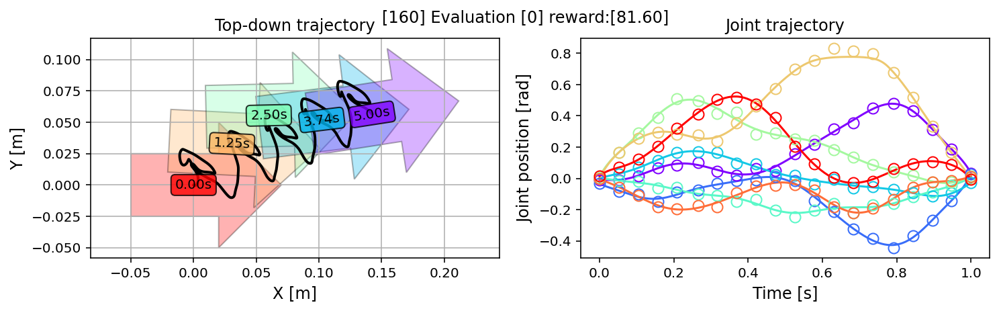

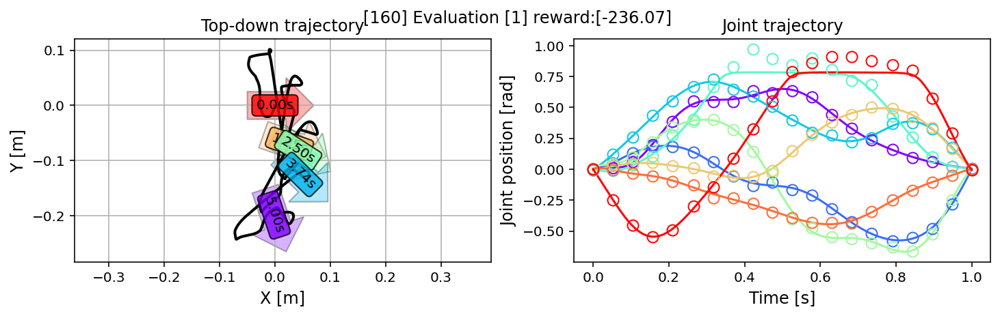

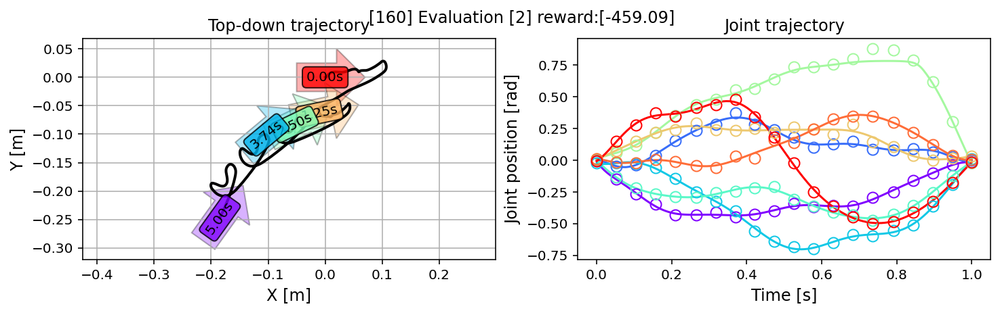

  [160/1000][Eval] reward_avg:[-204.52]
[165/1000] wall:[204.57]sec. [830] rollouts. Total loss:[0.670] (recon:[0.597] kl:[0.073])
[170/1000] wall:[210.35]sec. [855] rollouts. Total loss:[1.044] (recon:[0.968] kl:[0.077])
[175/1000] wall:[216.15]sec. [880] rollouts. Total loss:[0.858] (recon:[0.776] kl:[0.082])
[180/1000] wall:[221.92]sec. [905] rollouts. Total loss:[0.828] (recon:[0.749] kl:[0.079])


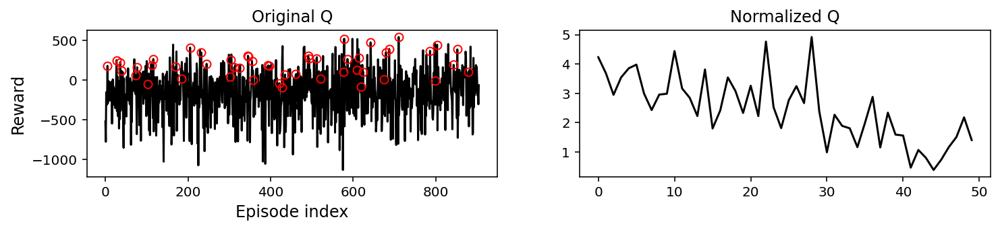

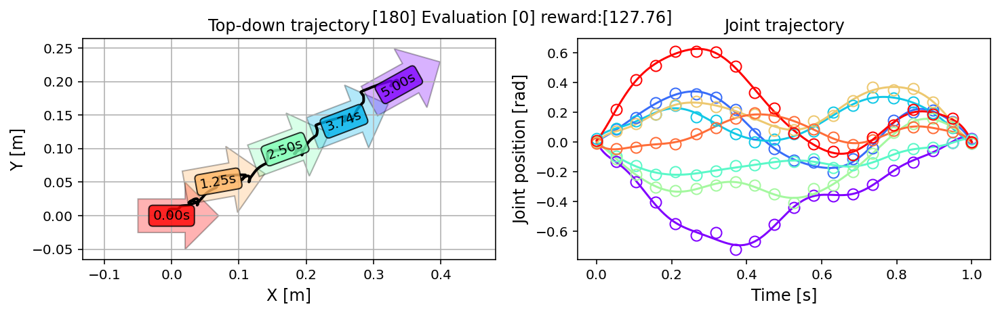

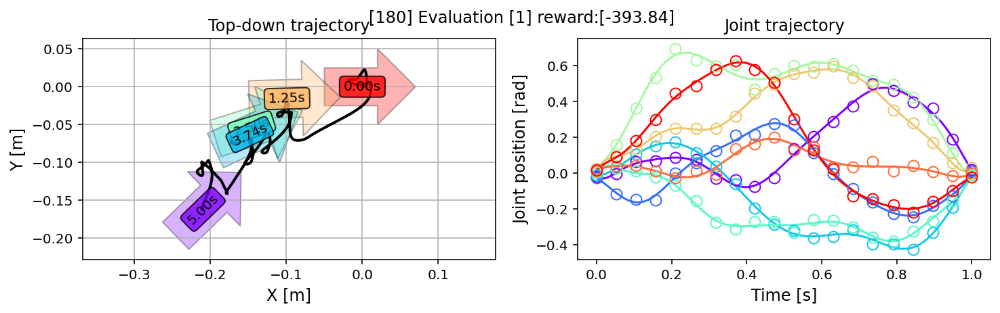

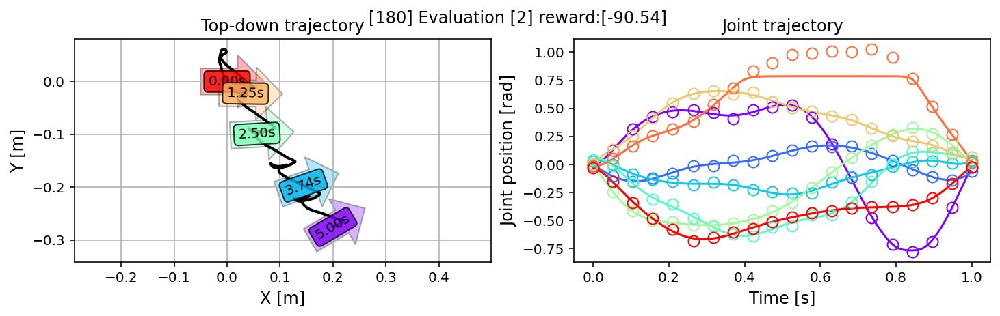

  [180/1000][Eval] reward_avg:[-118.87]
[185/1000] wall:[229.03]sec. [930] rollouts. Total loss:[0.979] (recon:[0.902] kl:[0.076])
[190/1000] wall:[234.83]sec. [955] rollouts. Total loss:[0.721] (recon:[0.647] kl:[0.074])
[195/1000] wall:[240.64]sec. [980] rollouts. Total loss:[0.756] (recon:[0.682] kl:[0.074])
[200/1000] wall:[246.44]sec. [1005] rollouts. Total loss:[0.608] (recon:[0.536] kl:[0.073])


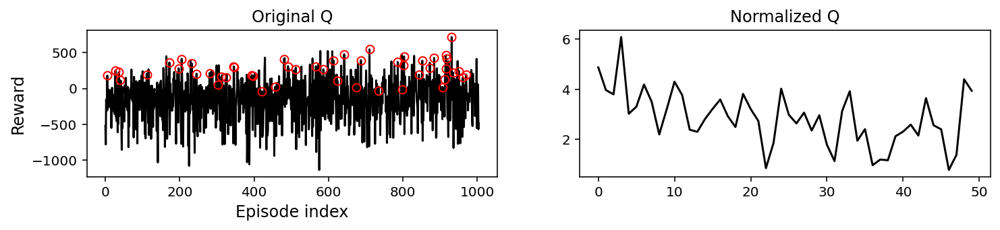

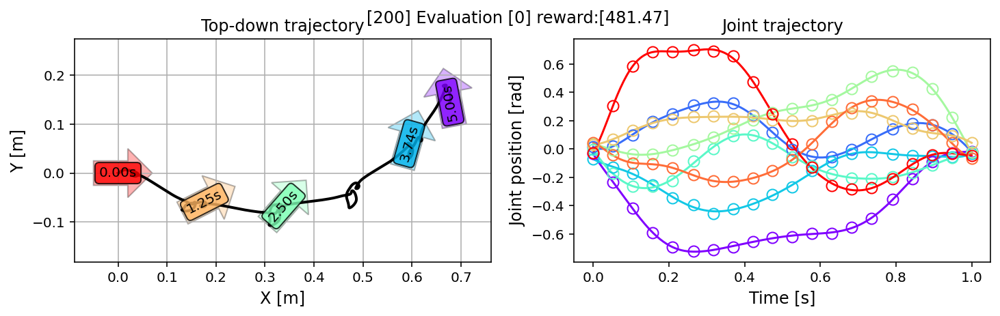

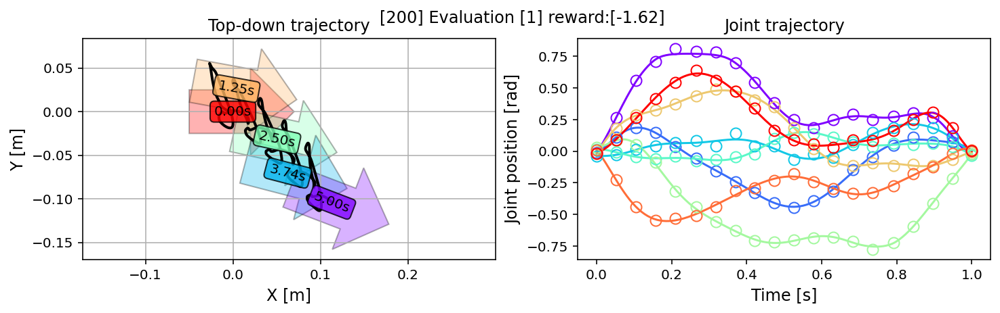

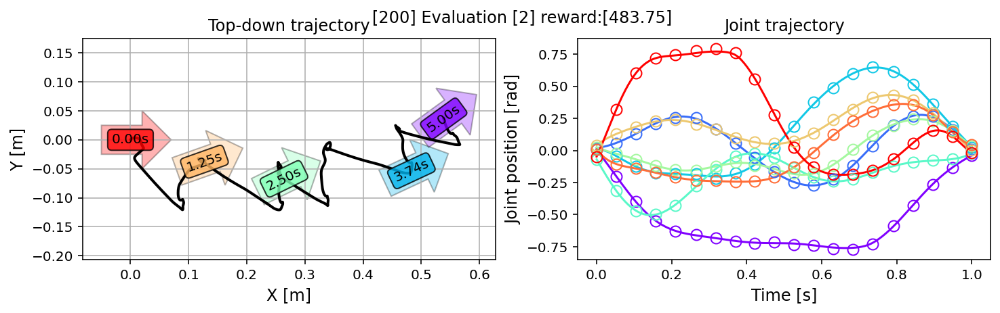

  [200/1000][Eval] reward_avg:[321.20]
[205/1000] wall:[253.42]sec. [1030] rollouts. Total loss:[0.758] (recon:[0.683] kl:[0.075])
[210/1000] wall:[259.25]sec. [1055] rollouts. Total loss:[0.576] (recon:[0.500] kl:[0.076])
[215/1000] wall:[264.95]sec. [1080] rollouts. Total loss:[0.732] (recon:[0.658] kl:[0.075])
[220/1000] wall:[270.90]sec. [1105] rollouts. Total loss:[0.508] (recon:[0.433] kl:[0.075])


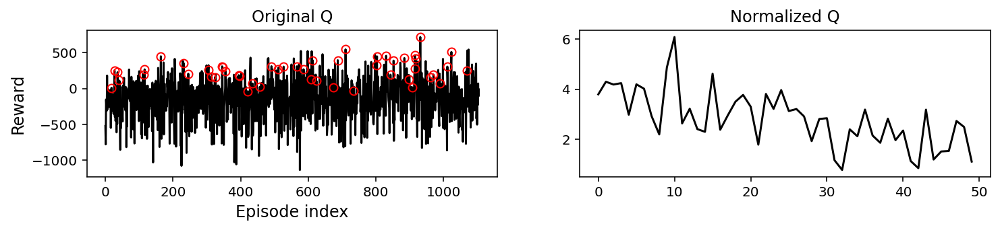

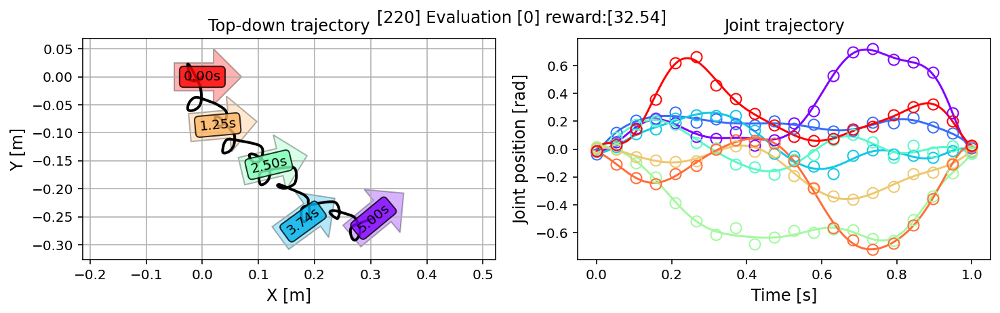

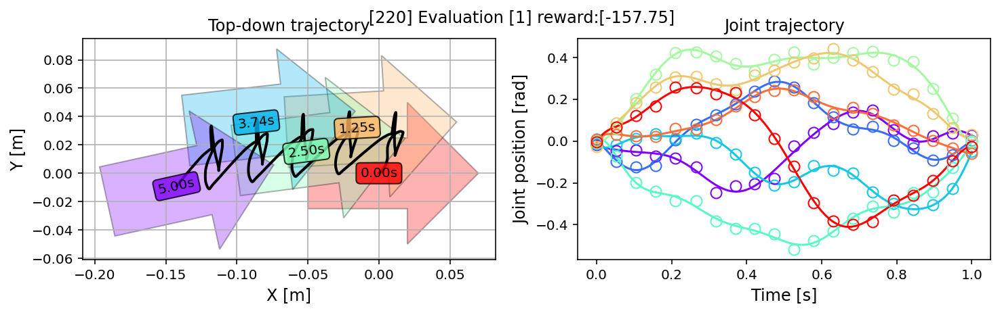

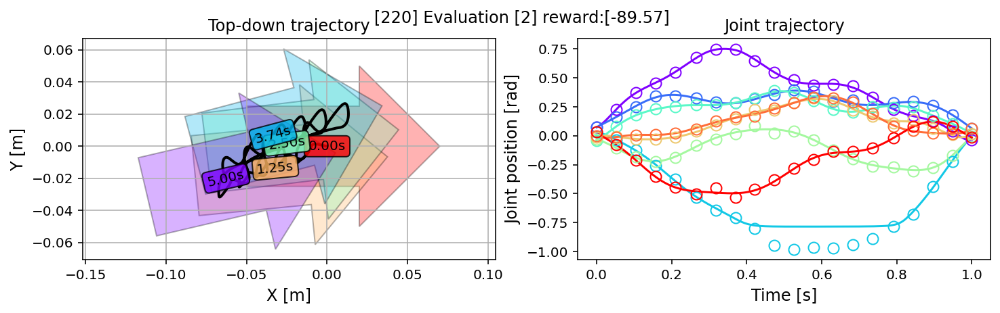

  [220/1000][Eval] reward_avg:[-71.59]
[225/1000] wall:[277.91]sec. [1130] rollouts. Total loss:[0.595] (recon:[0.527] kl:[0.068])
[230/1000] wall:[283.77]sec. [1155] rollouts. Total loss:[0.719] (recon:[0.645] kl:[0.075])
[235/1000] wall:[289.60]sec. [1180] rollouts. Total loss:[0.935] (recon:[0.867] kl:[0.067])
[240/1000] wall:[295.46]sec. [1205] rollouts. Total loss:[0.632] (recon:[0.563] kl:[0.069])


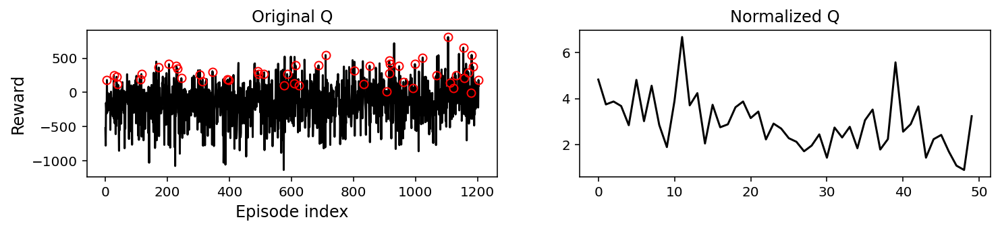

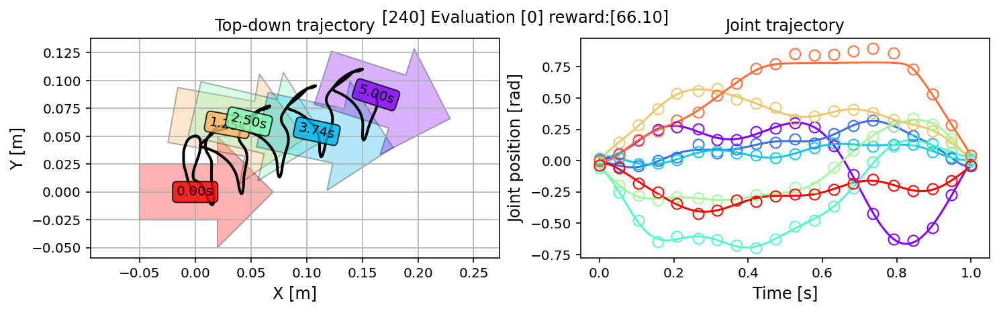

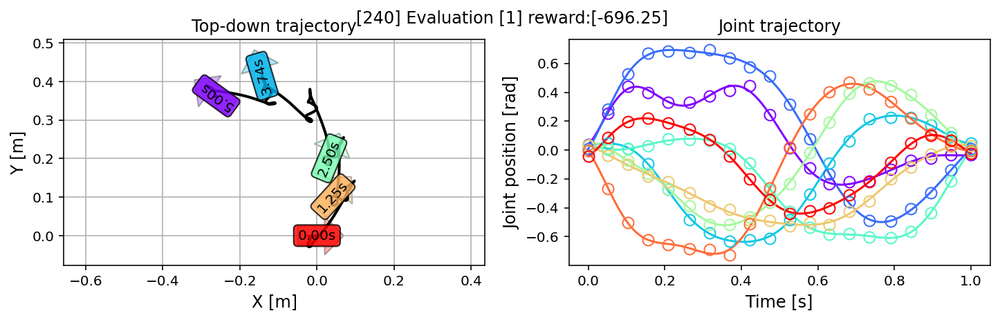

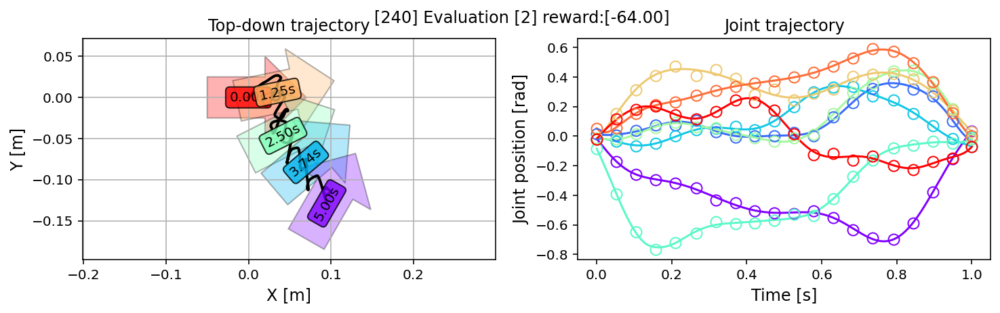

  [240/1000][Eval] reward_avg:[-231.38]
[245/1000] wall:[302.42]sec. [1230] rollouts. Total loss:[0.760] (recon:[0.693] kl:[0.067])
[250/1000] wall:[308.34]sec. [1255] rollouts. Total loss:[0.964] (recon:[0.897] kl:[0.067])
[255/1000] wall:[314.16]sec. [1280] rollouts. Total loss:[0.924] (recon:[0.857] kl:[0.068])
[260/1000] wall:[319.91]sec. [1305] rollouts. Total loss:[0.813] (recon:[0.747] kl:[0.066])


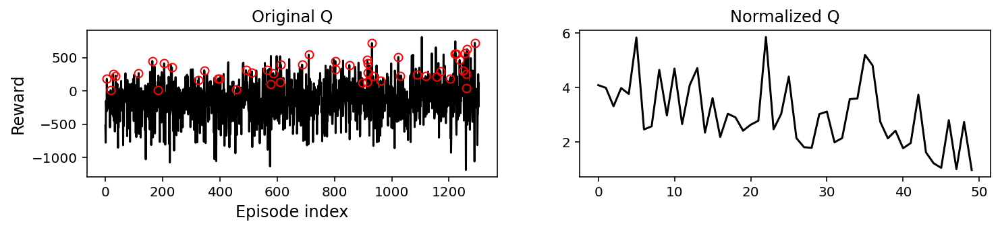

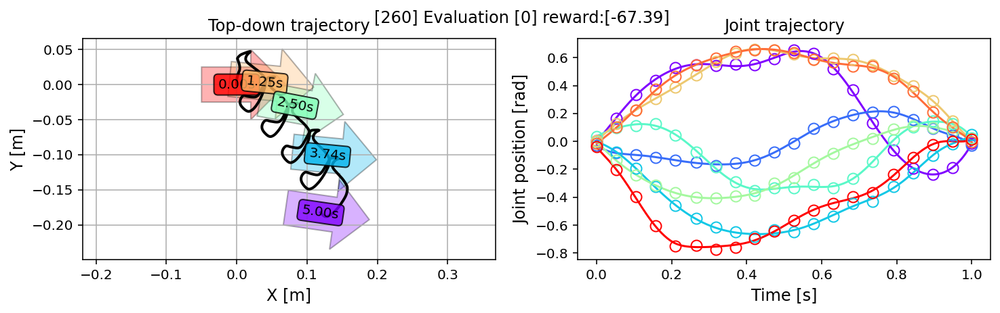

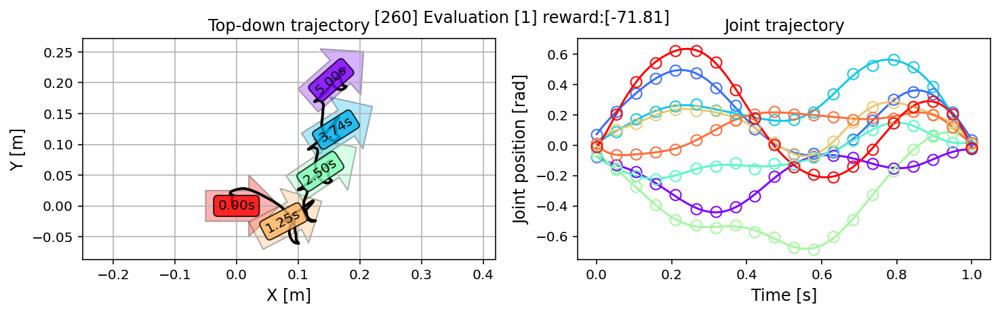

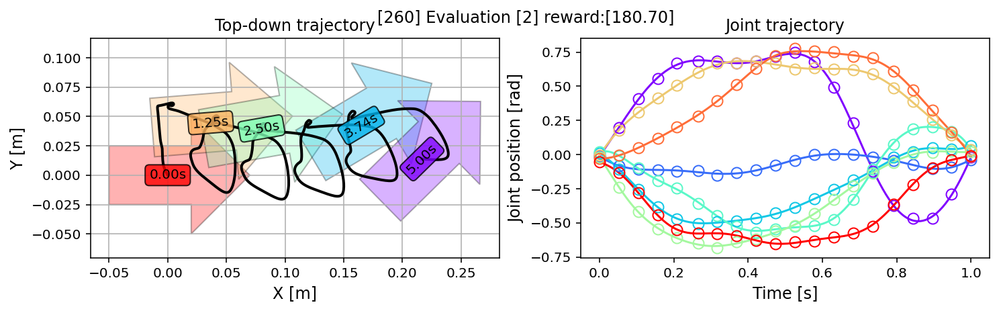

  [260/1000][Eval] reward_avg:[13.83]
[265/1000] wall:[326.88]sec. [1330] rollouts. Total loss:[0.742] (recon:[0.675] kl:[0.067])
[270/1000] wall:[332.66]sec. [1355] rollouts. Total loss:[0.772] (recon:[0.706] kl:[0.066])
[275/1000] wall:[338.46]sec. [1380] rollouts. Total loss:[0.702] (recon:[0.637] kl:[0.066])
[280/1000] wall:[344.25]sec. [1405] rollouts. Total loss:[0.700] (recon:[0.635] kl:[0.065])


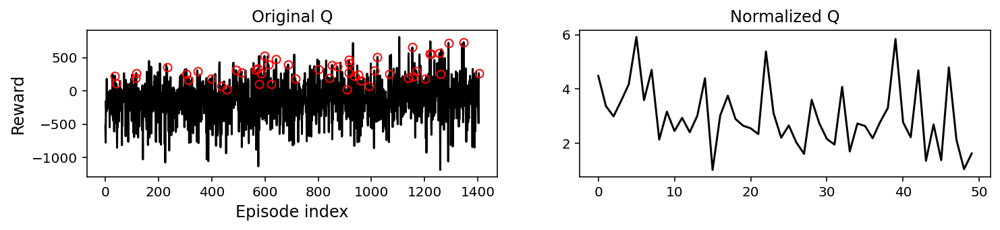

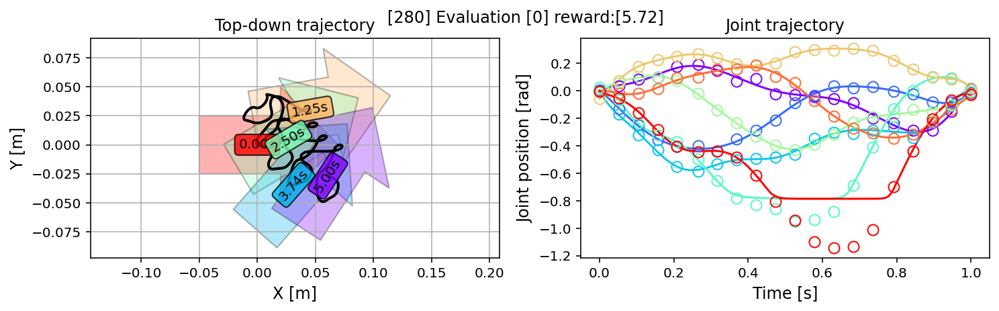

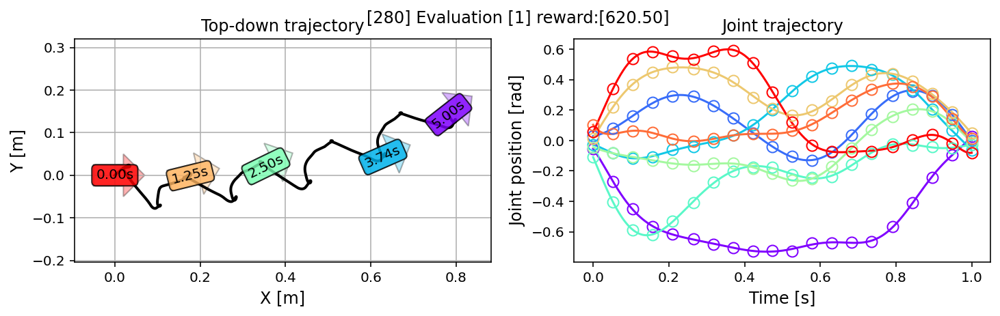

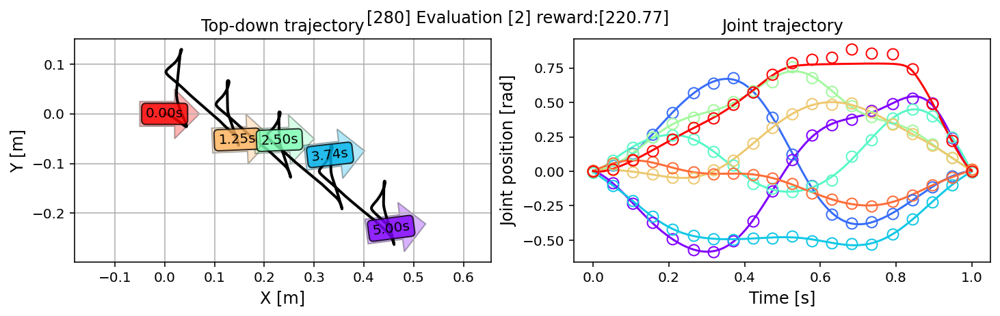

  [280/1000][Eval] reward_avg:[282.33]
[285/1000] wall:[351.21]sec. [1430] rollouts. Total loss:[0.791] (recon:[0.727] kl:[0.064])
[290/1000] wall:[356.92]sec. [1455] rollouts. Total loss:[0.802] (recon:[0.740] kl:[0.062])
[295/1000] wall:[362.66]sec. [1480] rollouts. Total loss:[0.944] (recon:[0.879] kl:[0.065])
[300/1000] wall:[368.46]sec. [1505] rollouts. Total loss:[0.952] (recon:[0.888] kl:[0.064])


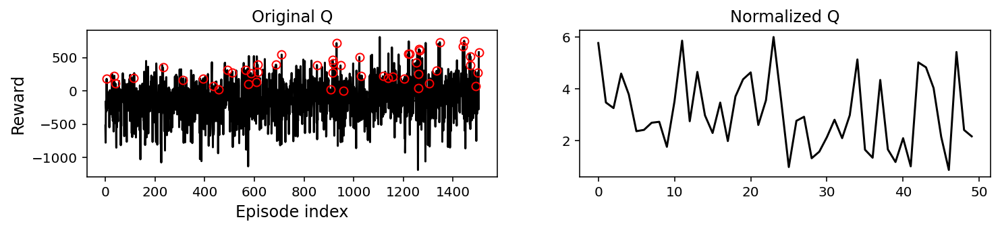

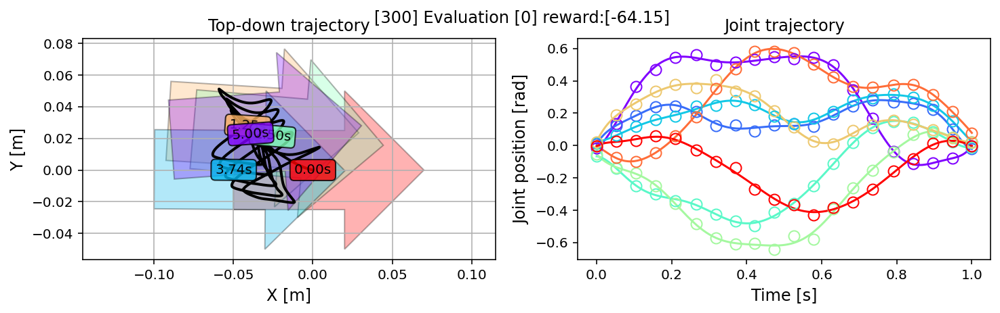

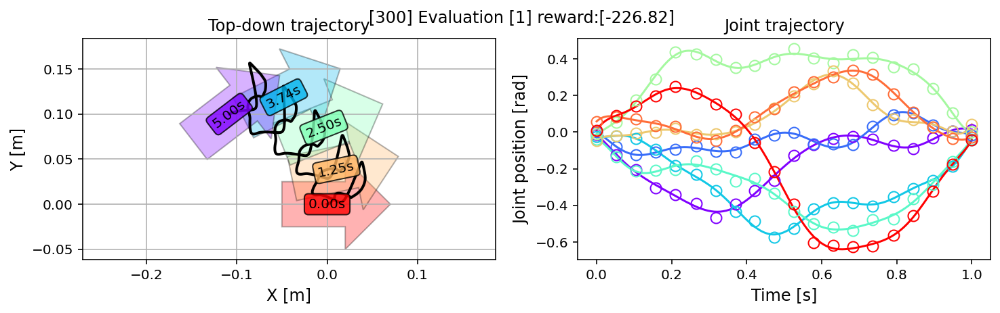

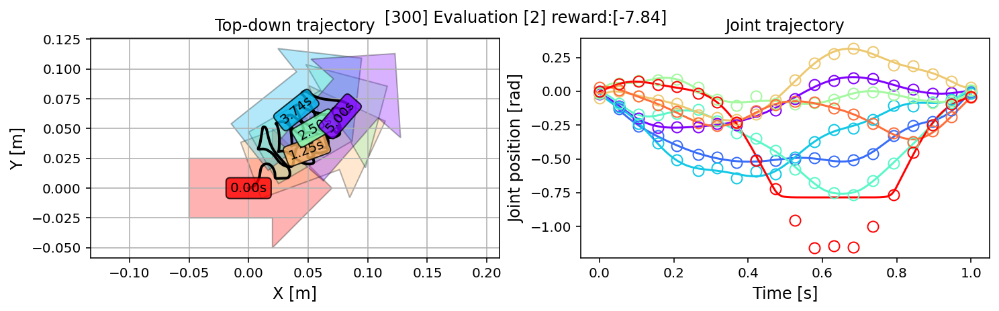

  [300/1000][Eval] reward_avg:[-99.60]
[305/1000] wall:[375.42]sec. [1530] rollouts. Total loss:[0.891] (recon:[0.825] kl:[0.066])
[310/1000] wall:[381.24]sec. [1555] rollouts. Total loss:[0.857] (recon:[0.794] kl:[0.063])
[315/1000] wall:[387.06]sec. [1580] rollouts. Total loss:[0.787] (recon:[0.724] kl:[0.063])
[320/1000] wall:[392.85]sec. [1605] rollouts. Total loss:[0.654] (recon:[0.589] kl:[0.065])


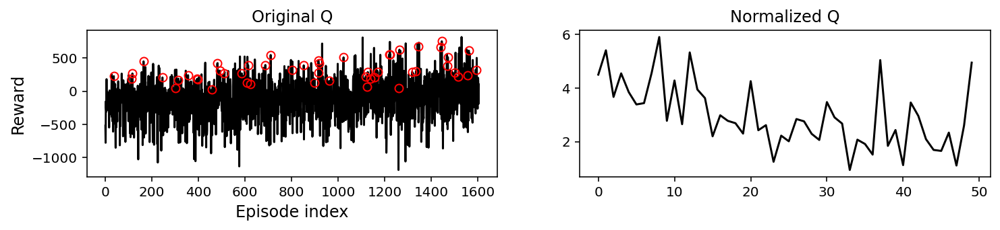

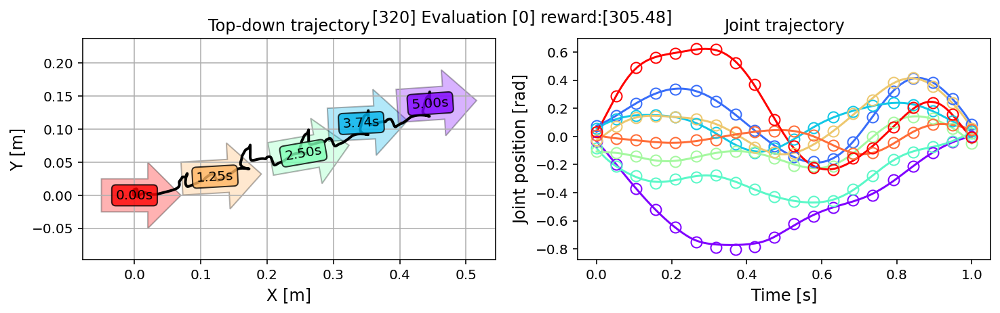

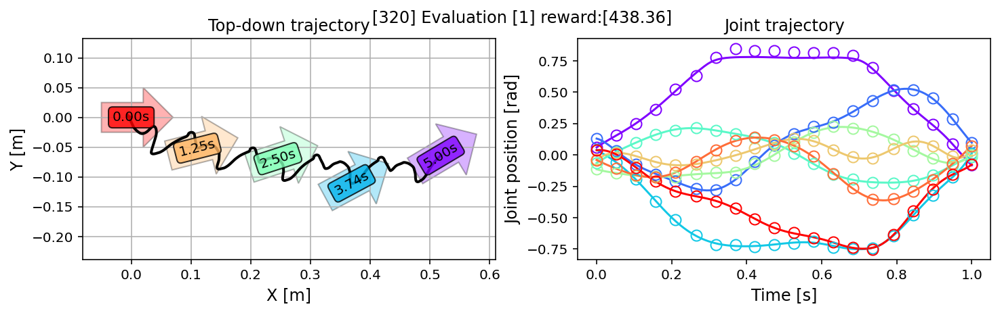

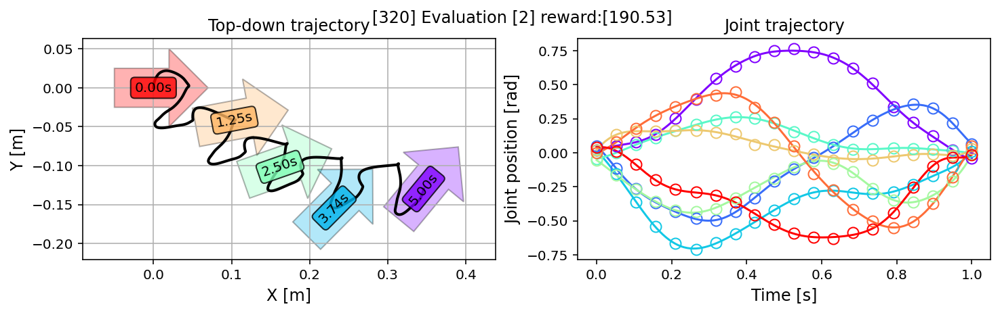

  [320/1000][Eval] reward_avg:[311.46]
[325/1000] wall:[399.82]sec. [1630] rollouts. Total loss:[0.880] (recon:[0.818] kl:[0.062])
[330/1000] wall:[405.67]sec. [1655] rollouts. Total loss:[0.951] (recon:[0.889] kl:[0.062])
[335/1000] wall:[411.62]sec. [1680] rollouts. Total loss:[0.796] (recon:[0.734] kl:[0.061])
[340/1000] wall:[417.53]sec. [1705] rollouts. Total loss:[0.827] (recon:[0.764] kl:[0.063])


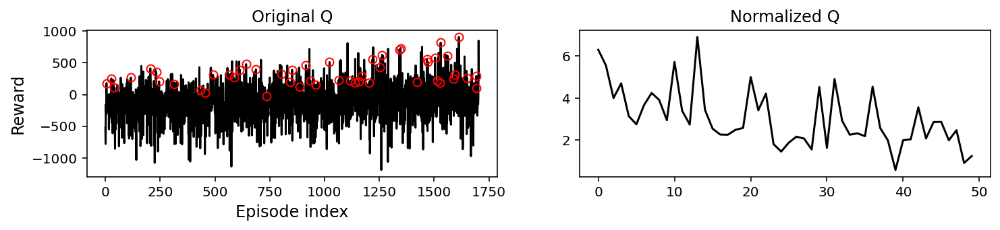

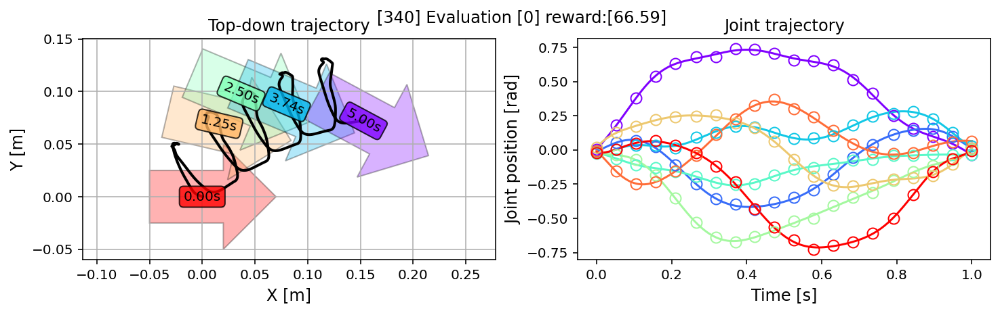

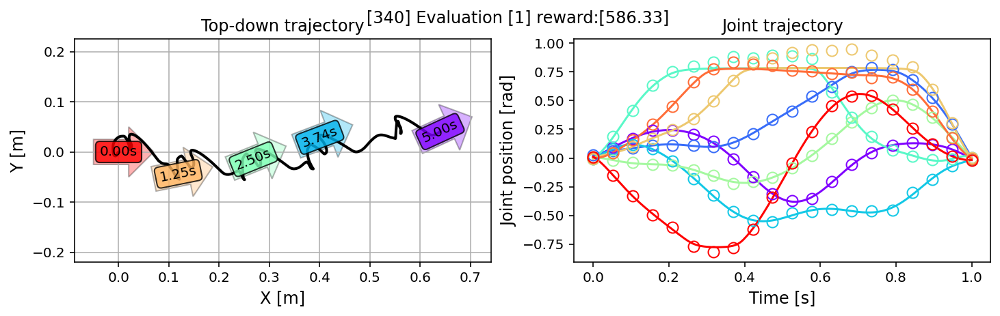

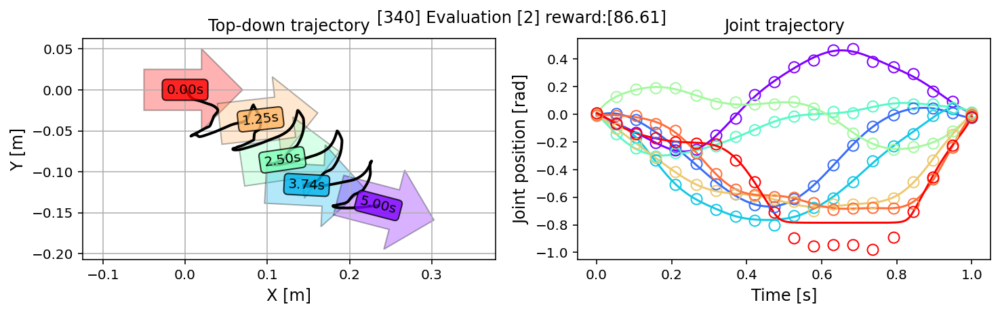

  [340/1000][Eval] reward_avg:[246.51]
[345/1000] wall:[424.52]sec. [1730] rollouts. Total loss:[0.885] (recon:[0.824] kl:[0.061])
[350/1000] wall:[430.33]sec. [1755] rollouts. Total loss:[0.651] (recon:[0.590] kl:[0.061])
[355/1000] wall:[436.24]sec. [1780] rollouts. Total loss:[0.739] (recon:[0.678] kl:[0.060])
[360/1000] wall:[442.02]sec. [1805] rollouts. Total loss:[0.884] (recon:[0.823] kl:[0.062])


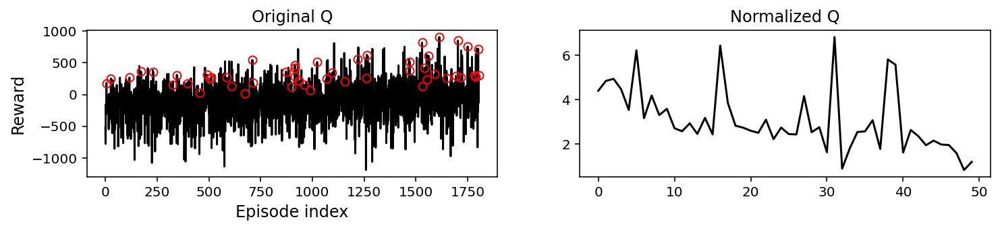

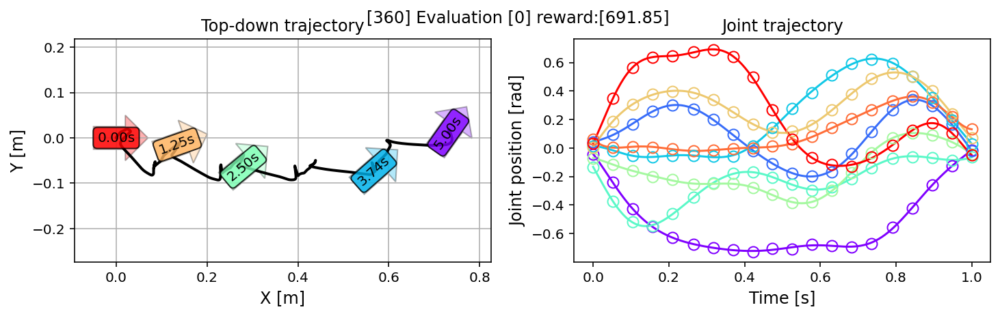

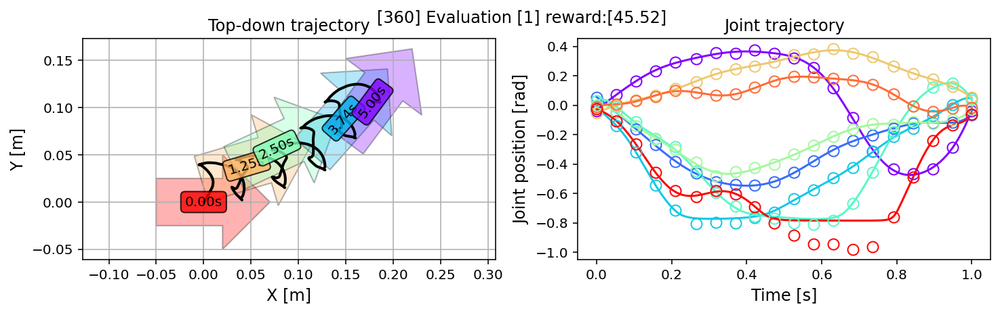

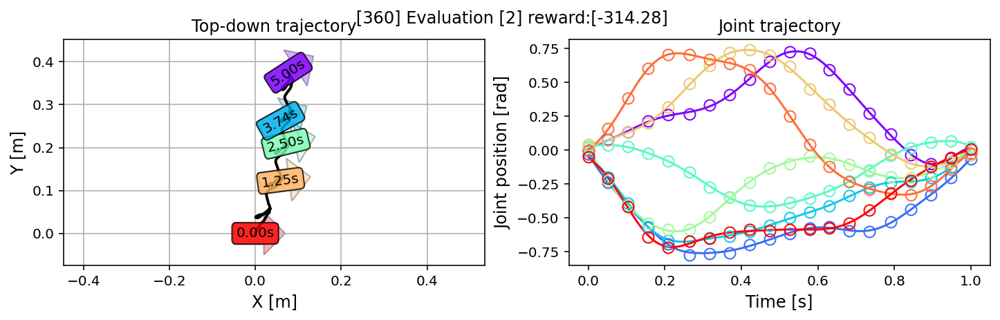

  [360/1000][Eval] reward_avg:[141.03]
[365/1000] wall:[449.00]sec. [1830] rollouts. Total loss:[0.655] (recon:[0.593] kl:[0.062])
[370/1000] wall:[454.86]sec. [1855] rollouts. Total loss:[0.844] (recon:[0.783] kl:[0.061])
[375/1000] wall:[460.69]sec. [1880] rollouts. Total loss:[0.778] (recon:[0.717] kl:[0.061])
[380/1000] wall:[466.53]sec. [1905] rollouts. Total loss:[1.013] (recon:[0.951] kl:[0.062])


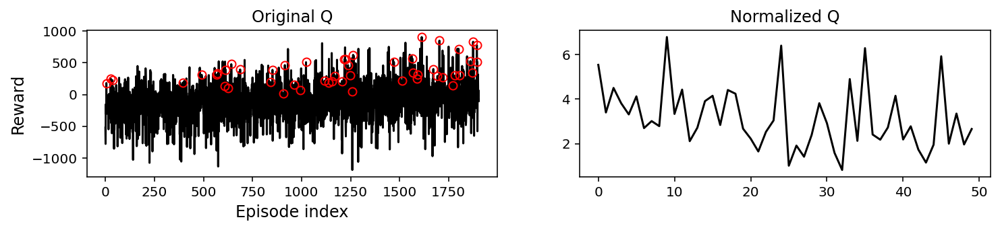

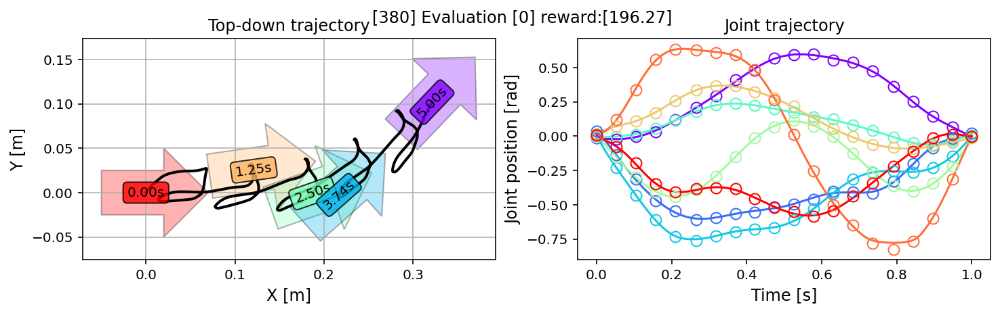

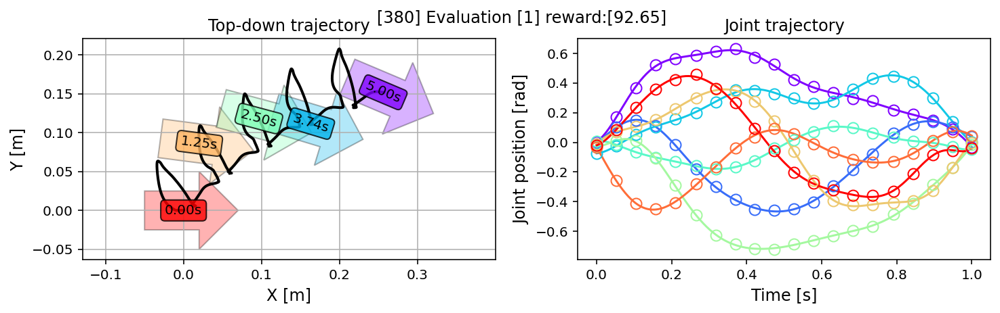

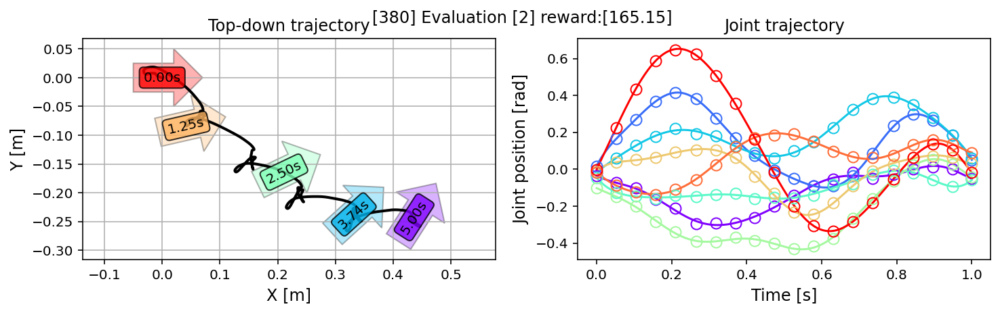

  [380/1000][Eval] reward_avg:[151.35]
[385/1000] wall:[473.59]sec. [1930] rollouts. Total loss:[0.738] (recon:[0.676] kl:[0.062])
[390/1000] wall:[479.44]sec. [1955] rollouts. Total loss:[0.834] (recon:[0.773] kl:[0.062])
[395/1000] wall:[485.29]sec. [1980] rollouts. Total loss:[0.676] (recon:[0.614] kl:[0.062])
[400/1000] wall:[491.07]sec. [2005] rollouts. Total loss:[0.605] (recon:[0.543] kl:[0.061])


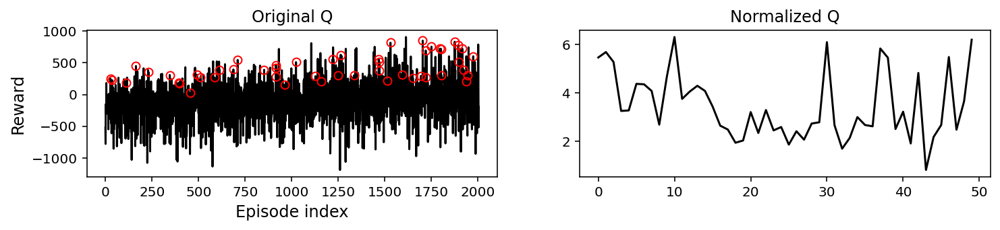

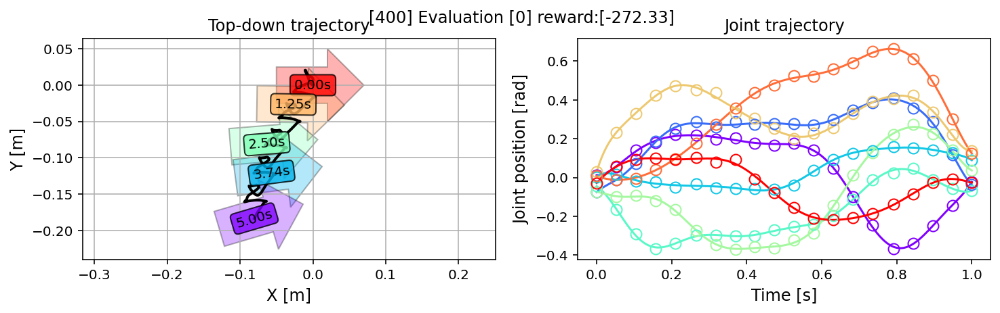

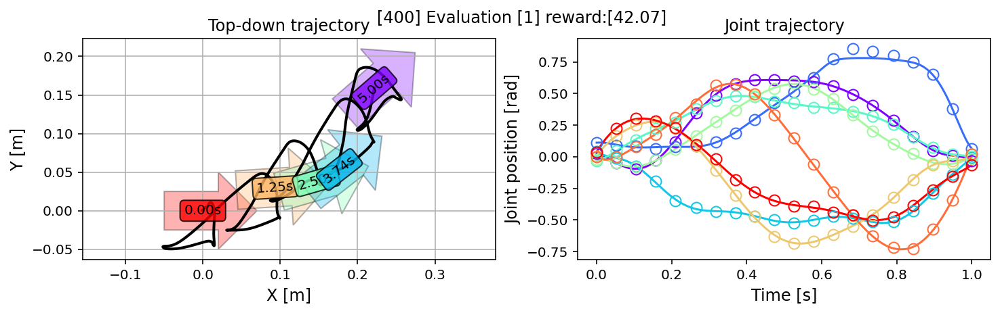

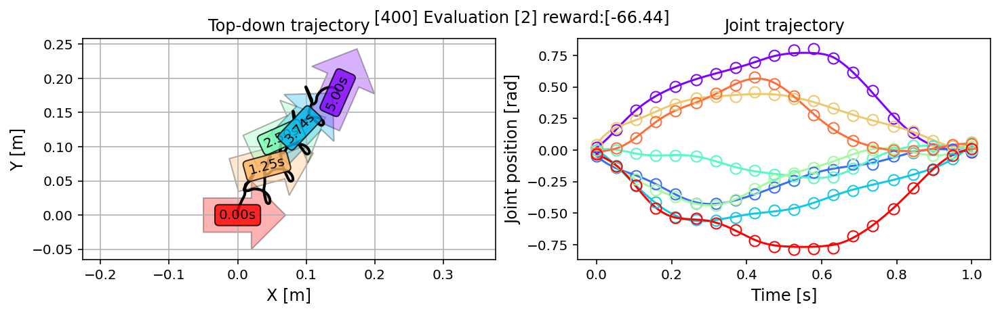

  [400/1000][Eval] reward_avg:[-98.90]
[405/1000] wall:[498.19]sec. [2030] rollouts. Total loss:[0.674] (recon:[0.612] kl:[0.062])
[410/1000] wall:[504.01]sec. [2055] rollouts. Total loss:[0.747] (recon:[0.687] kl:[0.060])
[415/1000] wall:[509.86]sec. [2080] rollouts. Total loss:[0.766] (recon:[0.704] kl:[0.062])
[420/1000] wall:[515.67]sec. [2105] rollouts. Total loss:[0.959] (recon:[0.897] kl:[0.061])


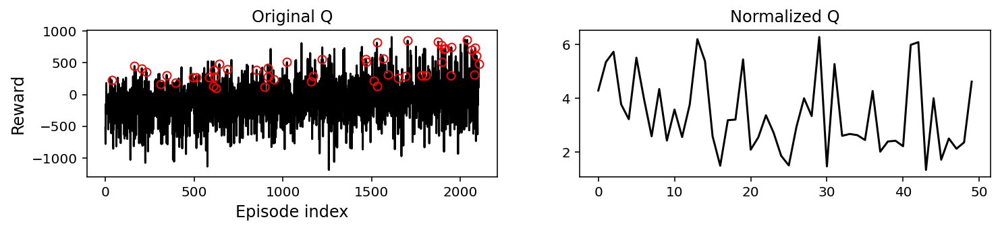

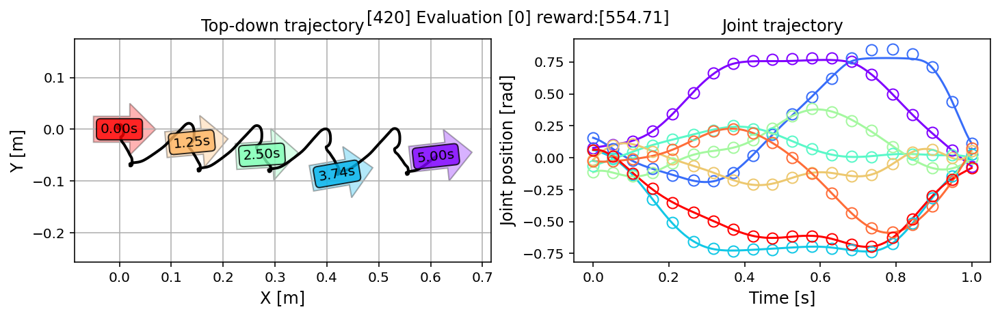

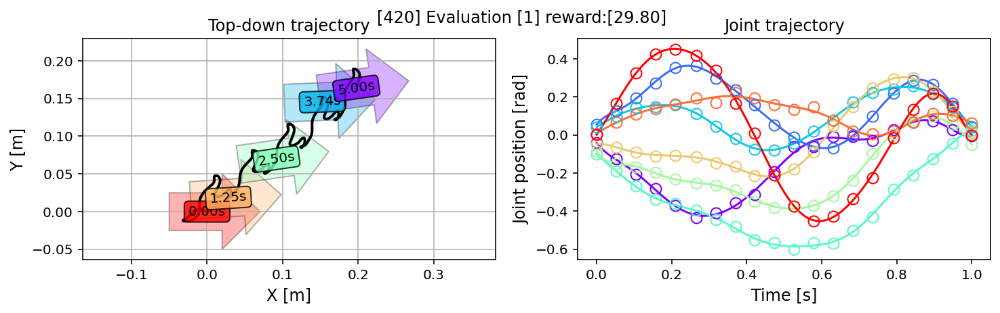

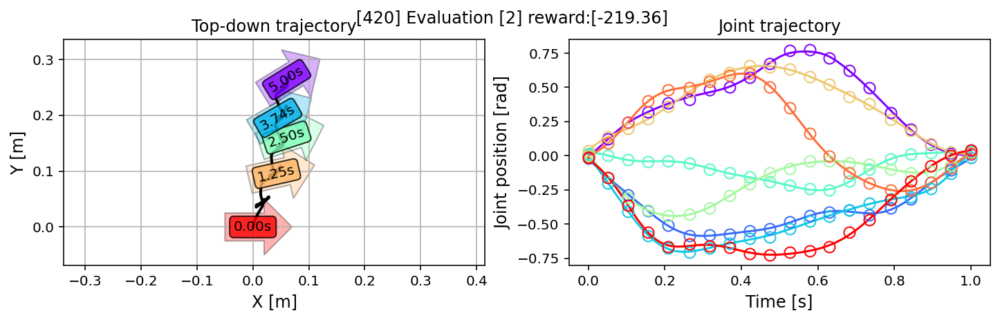

  [420/1000][Eval] reward_avg:[121.72]
[425/1000] wall:[522.67]sec. [2130] rollouts. Total loss:[1.034] (recon:[0.974] kl:[0.059])
[430/1000] wall:[528.64]sec. [2155] rollouts. Total loss:[0.659] (recon:[0.597] kl:[0.062])
[435/1000] wall:[534.51]sec. [2180] rollouts. Total loss:[0.676] (recon:[0.616] kl:[0.060])
[440/1000] wall:[540.32]sec. [2205] rollouts. Total loss:[0.913] (recon:[0.854] kl:[0.060])


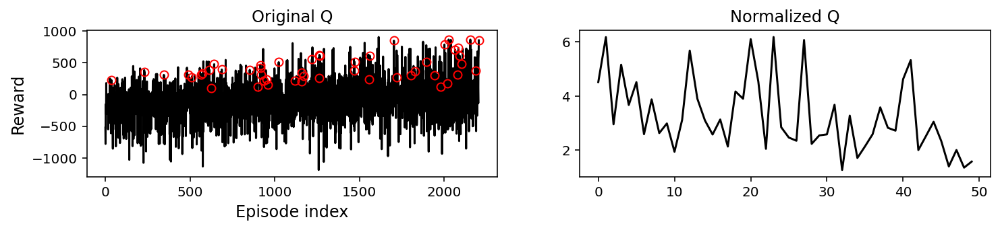

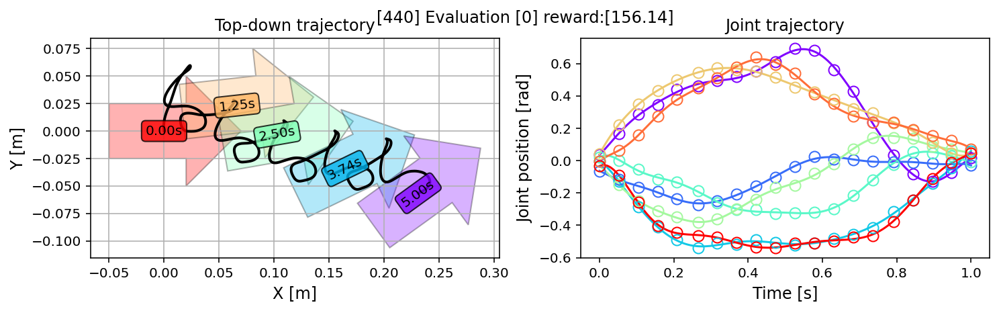

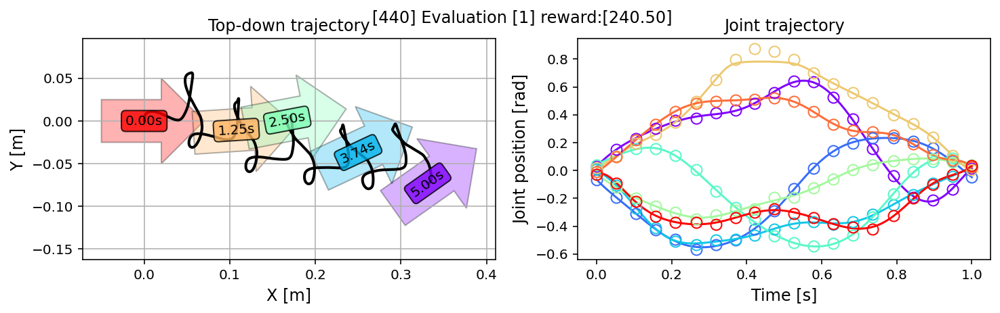

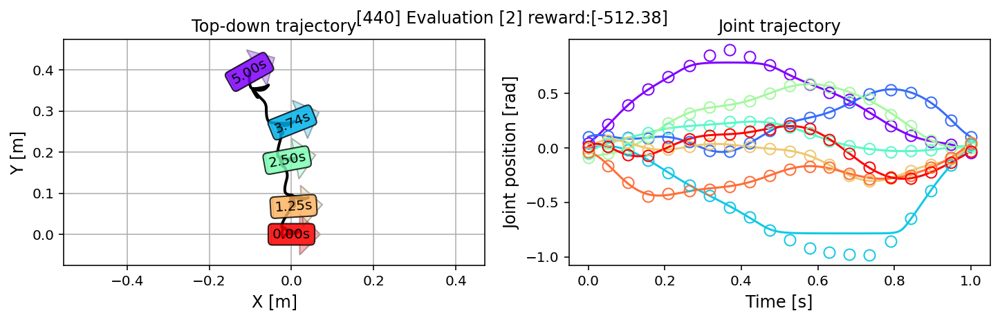

  [440/1000][Eval] reward_avg:[-38.58]
[445/1000] wall:[547.28]sec. [2230] rollouts. Total loss:[0.880] (recon:[0.819] kl:[0.061])
[450/1000] wall:[553.00]sec. [2255] rollouts. Total loss:[0.647] (recon:[0.586] kl:[0.061])
[455/1000] wall:[558.76]sec. [2280] rollouts. Total loss:[0.761] (recon:[0.697] kl:[0.063])
[460/1000] wall:[564.51]sec. [2305] rollouts. Total loss:[0.878] (recon:[0.818] kl:[0.060])


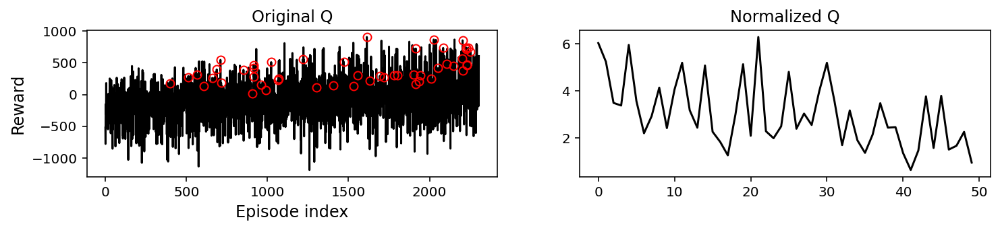

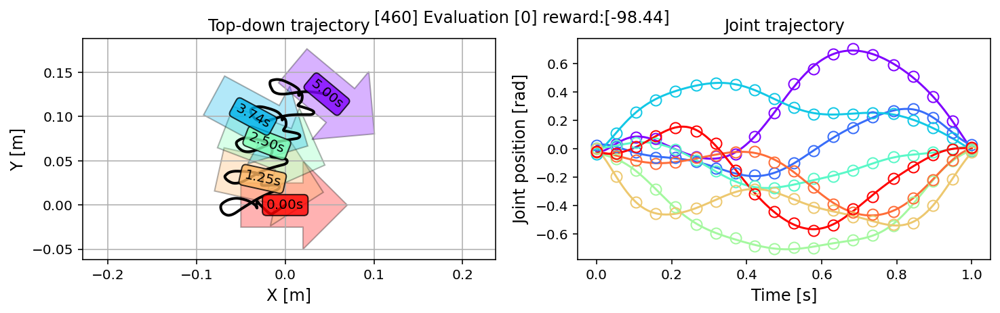

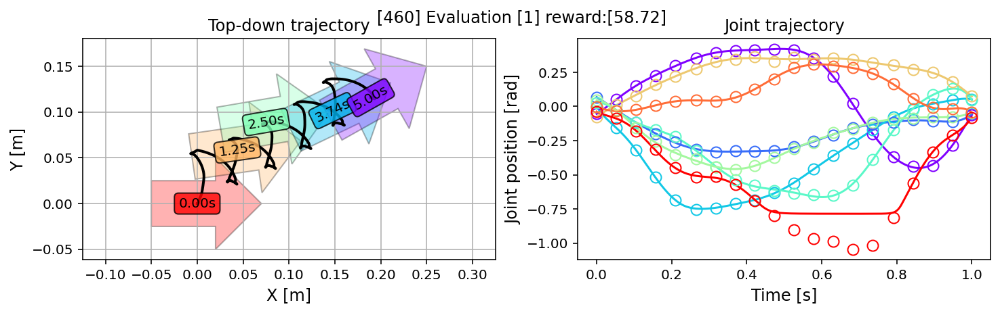

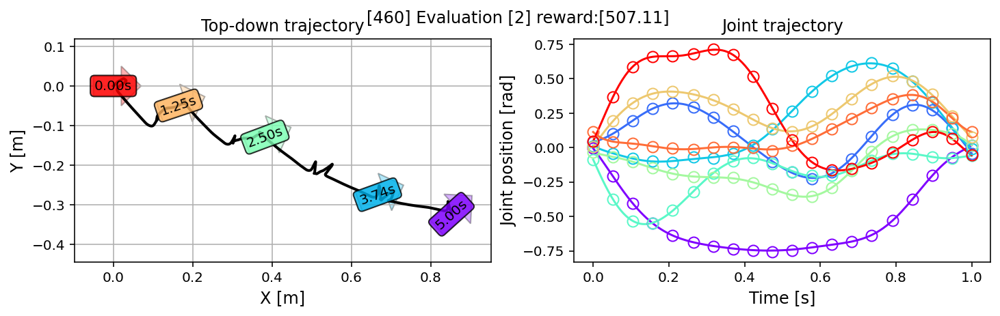

  [460/1000][Eval] reward_avg:[155.79]
[465/1000] wall:[571.52]sec. [2330] rollouts. Total loss:[0.831] (recon:[0.772] kl:[0.059])
[470/1000] wall:[577.33]sec. [2355] rollouts. Total loss:[0.785] (recon:[0.725] kl:[0.060])
[475/1000] wall:[583.08]sec. [2380] rollouts. Total loss:[0.884] (recon:[0.825] kl:[0.059])
[480/1000] wall:[588.85]sec. [2405] rollouts. Total loss:[0.770] (recon:[0.710] kl:[0.060])


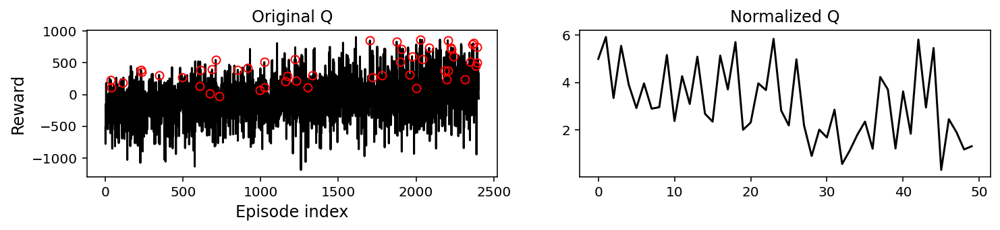

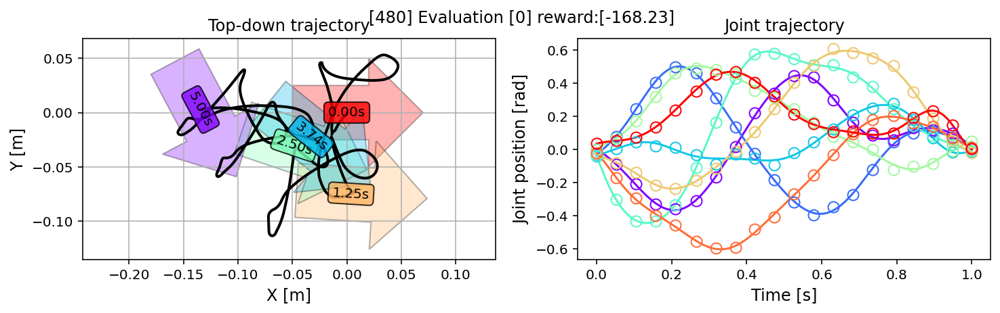

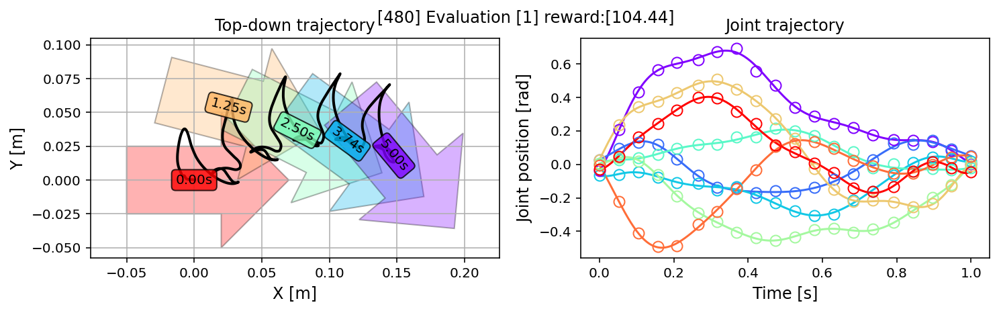

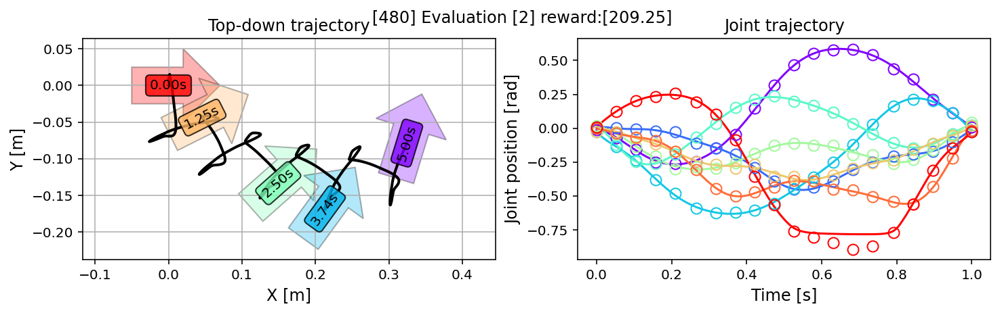

  [480/1000][Eval] reward_avg:[48.48]
[485/1000] wall:[595.85]sec. [2430] rollouts. Total loss:[0.730] (recon:[0.670] kl:[0.060])
[490/1000] wall:[601.67]sec. [2455] rollouts. Total loss:[0.855] (recon:[0.793] kl:[0.062])
[495/1000] wall:[607.52]sec. [2480] rollouts. Total loss:[0.822] (recon:[0.763] kl:[0.060])
[500/1000] wall:[613.34]sec. [2505] rollouts. Total loss:[0.817] (recon:[0.756] kl:[0.062])


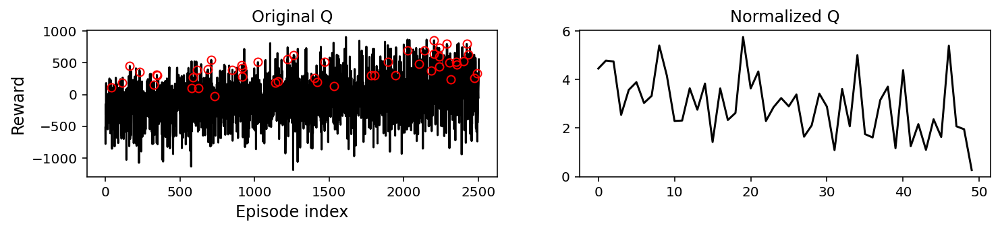

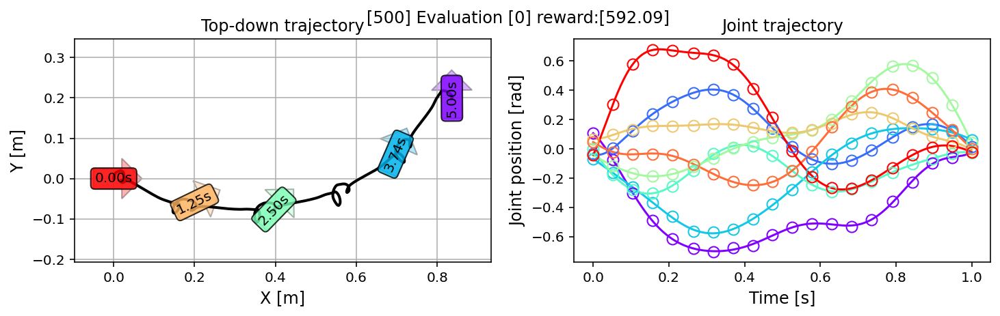

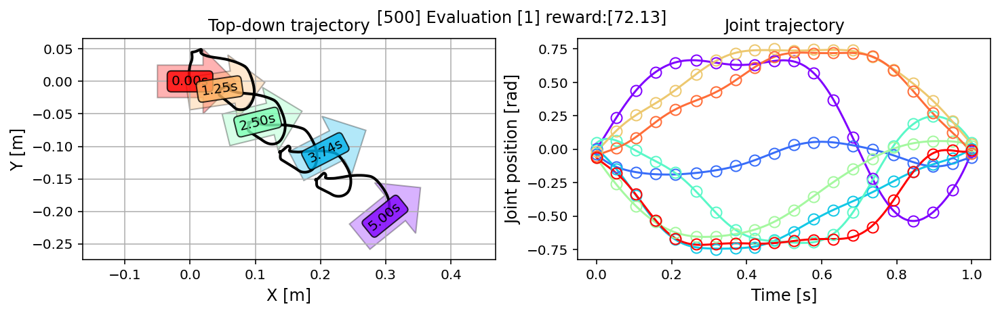

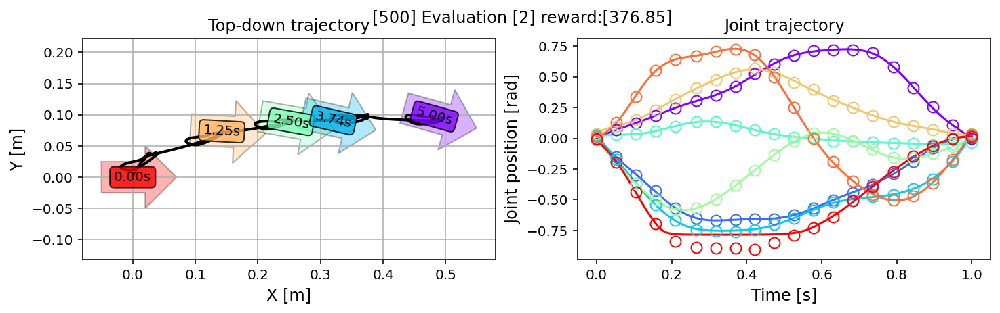

  [500/1000][Eval] reward_avg:[347.02]
[505/1000] wall:[620.39]sec. [2530] rollouts. Total loss:[0.732] (recon:[0.672] kl:[0.060])
[510/1000] wall:[626.20]sec. [2555] rollouts. Total loss:[0.852] (recon:[0.792] kl:[0.060])
[515/1000] wall:[631.96]sec. [2580] rollouts. Total loss:[0.817] (recon:[0.756] kl:[0.061])
[520/1000] wall:[637.71]sec. [2605] rollouts. Total loss:[0.765] (recon:[0.704] kl:[0.060])


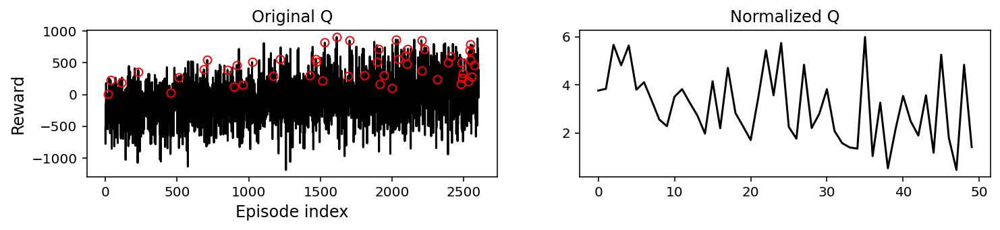

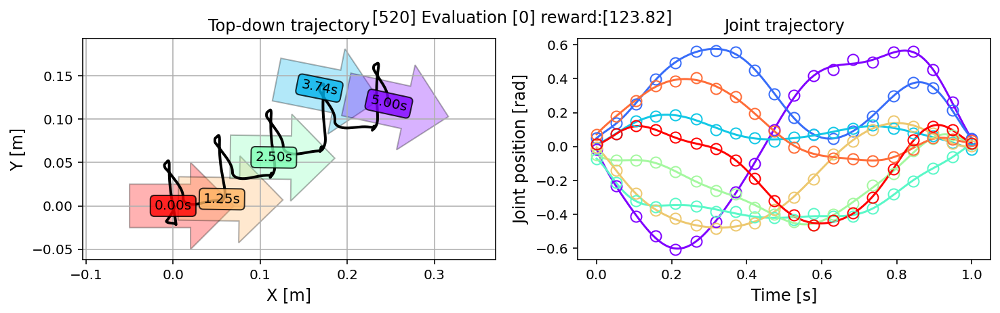

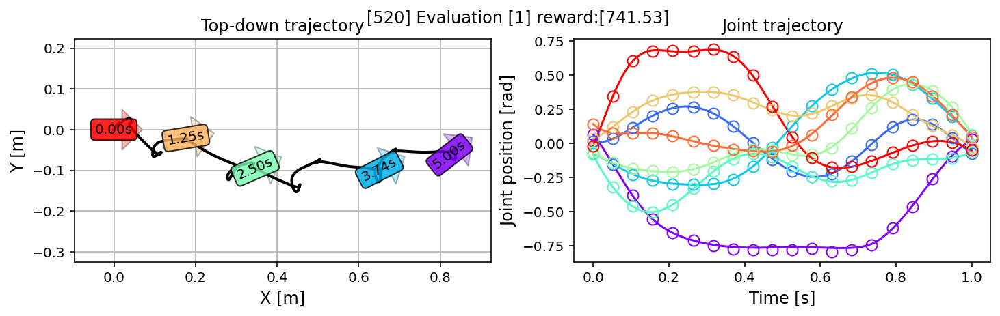

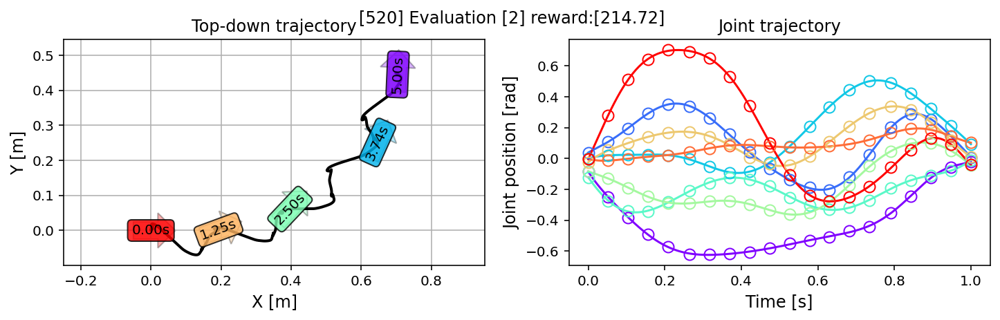

  [520/1000][Eval] reward_avg:[360.02]
[525/1000] wall:[644.77]sec. [2630] rollouts. Total loss:[0.800] (recon:[0.740] kl:[0.060])
[530/1000] wall:[650.83]sec. [2655] rollouts. Total loss:[0.869] (recon:[0.810] kl:[0.059])
[535/1000] wall:[656.82]sec. [2680] rollouts. Total loss:[0.806] (recon:[0.747] kl:[0.059])
[540/1000] wall:[662.60]sec. [2705] rollouts. Total loss:[1.000] (recon:[0.940] kl:[0.060])


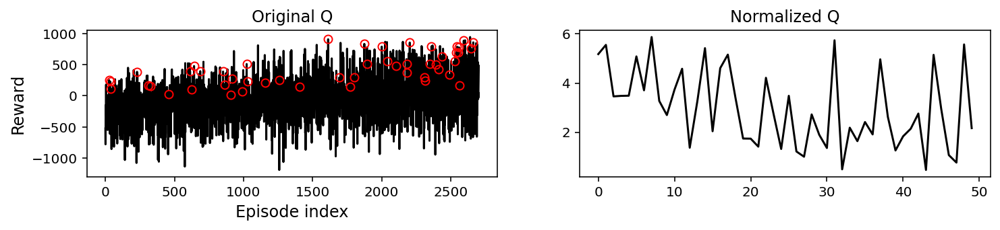

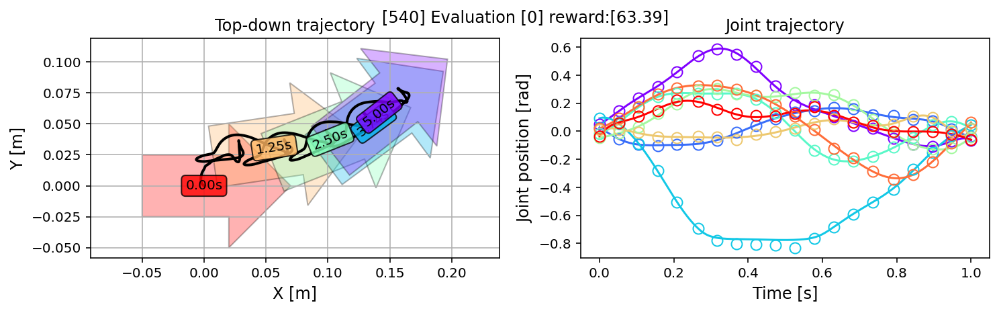

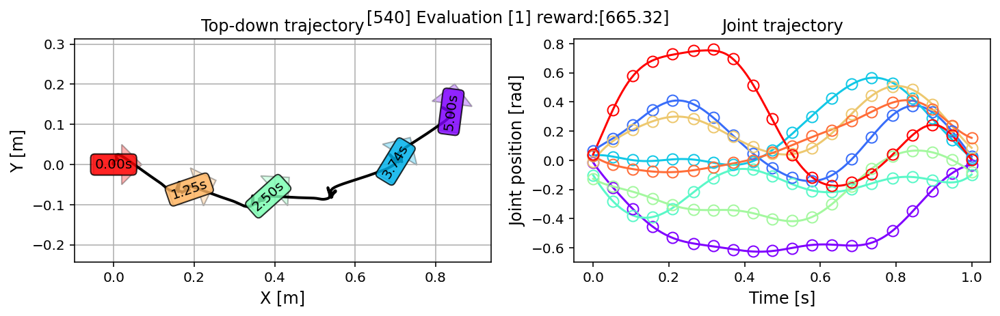

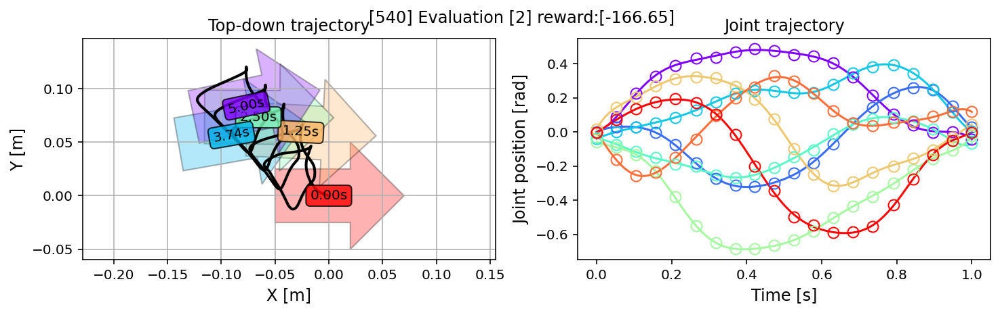

  [540/1000][Eval] reward_avg:[187.35]
[545/1000] wall:[669.52]sec. [2730] rollouts. Total loss:[0.976] (recon:[0.917] kl:[0.059])
[550/1000] wall:[675.27]sec. [2755] rollouts. Total loss:[0.967] (recon:[0.910] kl:[0.058])
[555/1000] wall:[681.09]sec. [2780] rollouts. Total loss:[0.780] (recon:[0.720] kl:[0.060])
[560/1000] wall:[686.91]sec. [2805] rollouts. Total loss:[1.033] (recon:[0.974] kl:[0.059])


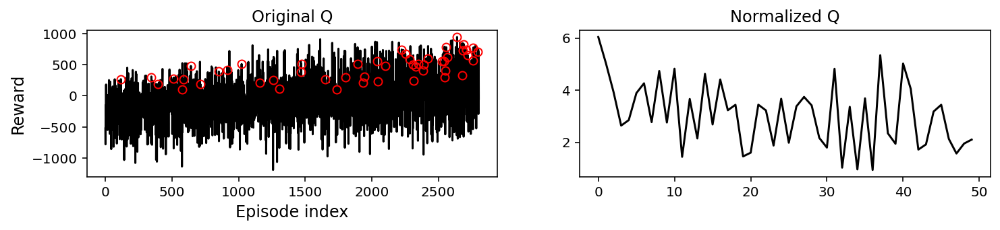

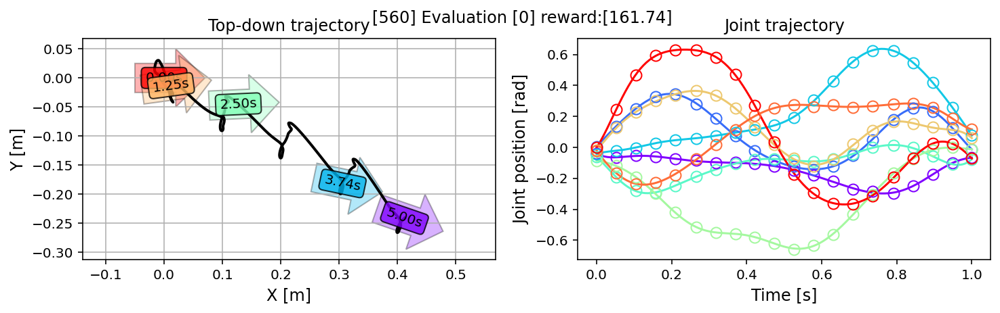

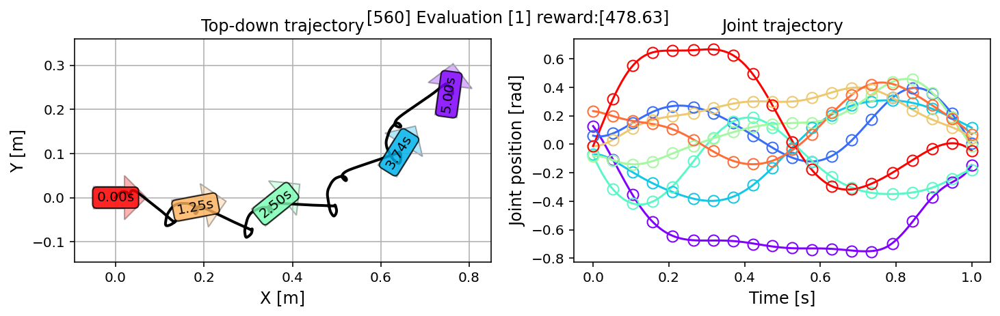

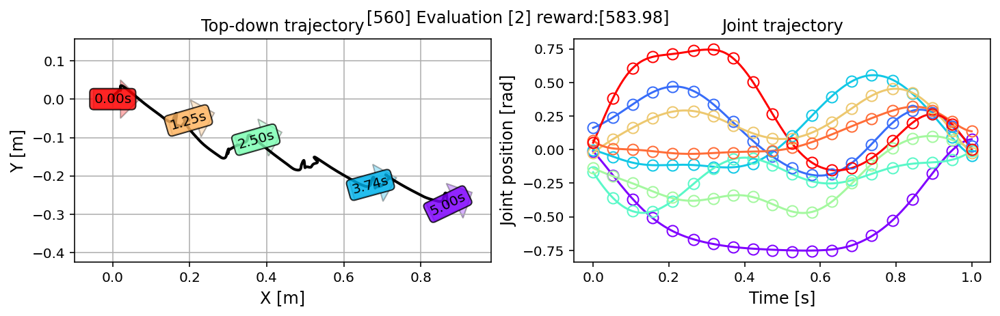

  [560/1000][Eval] reward_avg:[408.12]
[565/1000] wall:[693.97]sec. [2830] rollouts. Total loss:[0.915] (recon:[0.855] kl:[0.060])
[570/1000] wall:[699.68]sec. [2855] rollouts. Total loss:[0.813] (recon:[0.753] kl:[0.060])
[575/1000] wall:[705.56]sec. [2880] rollouts. Total loss:[0.897] (recon:[0.838] kl:[0.059])
[580/1000] wall:[711.35]sec. [2905] rollouts. Total loss:[1.114] (recon:[1.056] kl:[0.059])


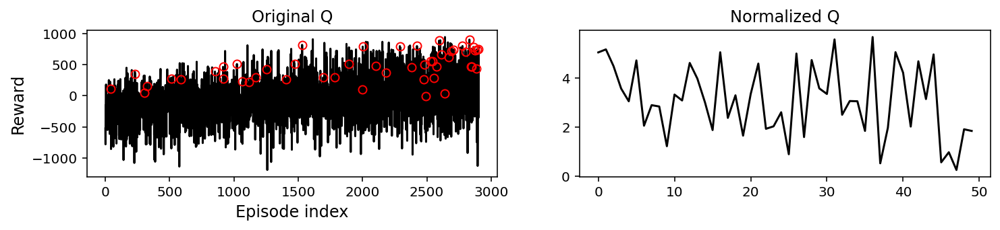

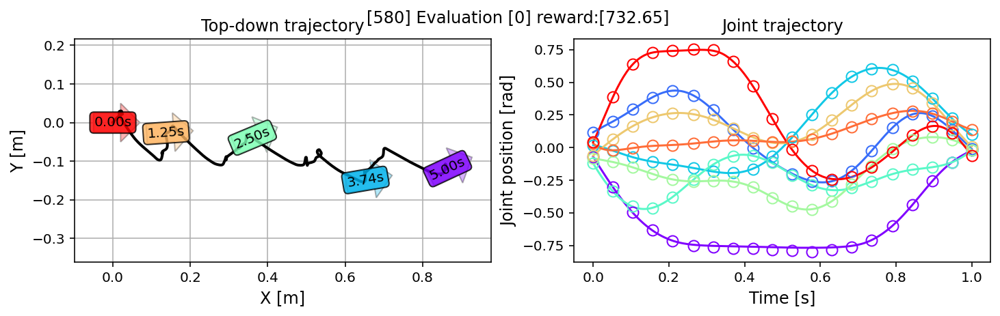

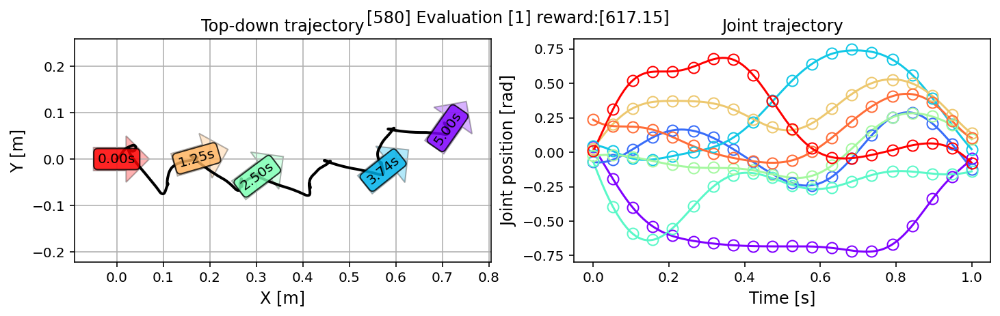

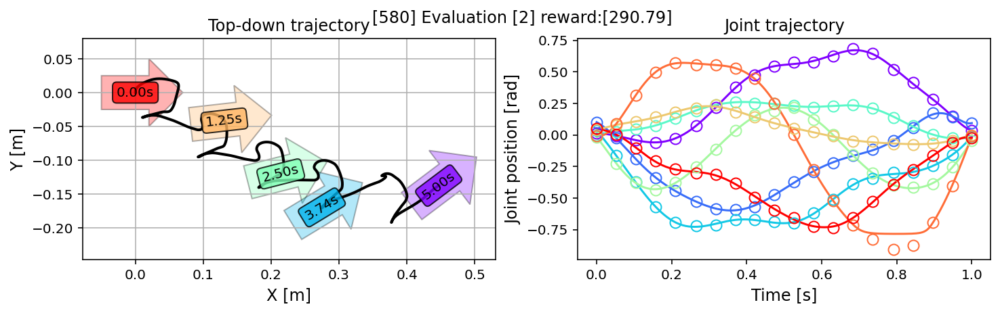

  [580/1000][Eval] reward_avg:[546.86]
[585/1000] wall:[718.27]sec. [2930] rollouts. Total loss:[0.785] (recon:[0.726] kl:[0.060])
[590/1000] wall:[724.12]sec. [2955] rollouts. Total loss:[0.859] (recon:[0.801] kl:[0.058])
[595/1000] wall:[729.96]sec. [2980] rollouts. Total loss:[0.998] (recon:[0.939] kl:[0.059])
[600/1000] wall:[735.79]sec. [3005] rollouts. Total loss:[1.000] (recon:[0.941] kl:[0.059])


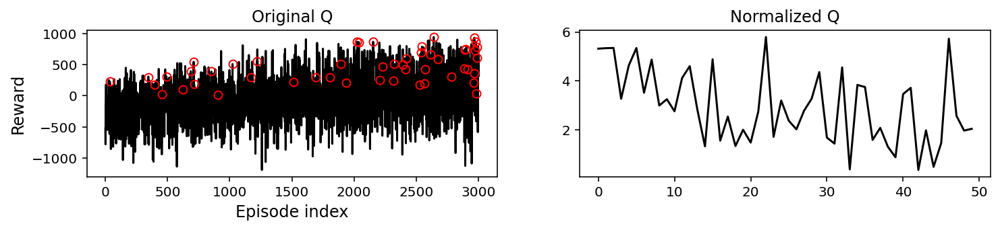

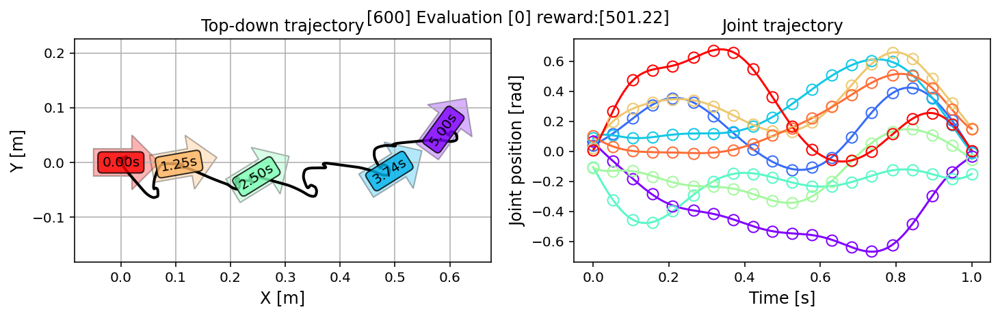

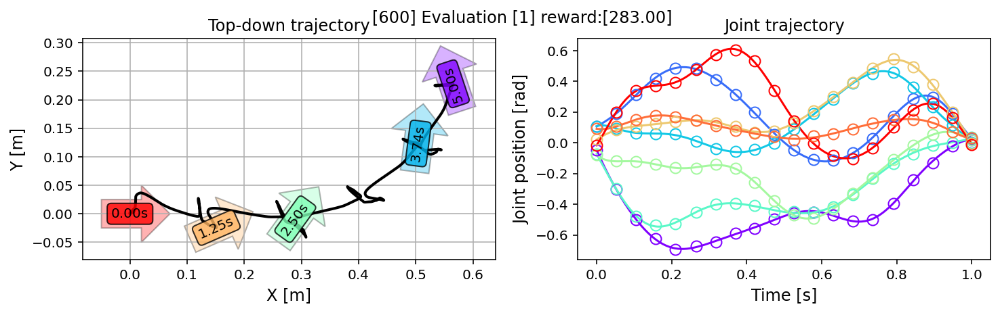

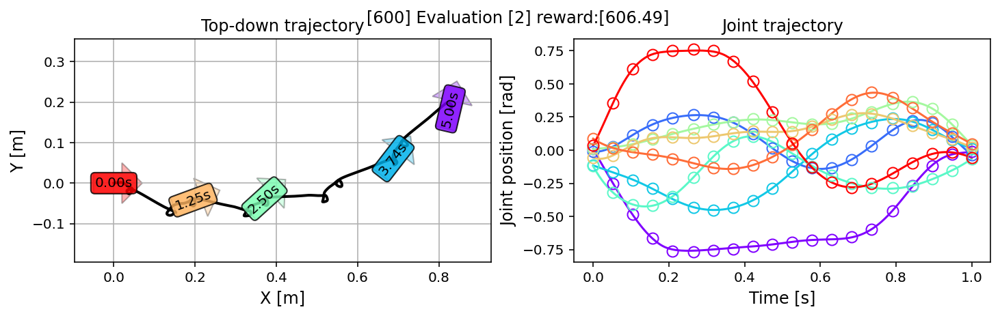

  [600/1000][Eval] reward_avg:[463.57]
[605/1000] wall:[742.78]sec. [3030] rollouts. Total loss:[0.907] (recon:[0.848] kl:[0.060])
[610/1000] wall:[748.53]sec. [3055] rollouts. Total loss:[0.883] (recon:[0.824] kl:[0.059])
[615/1000] wall:[754.46]sec. [3080] rollouts. Total loss:[0.809] (recon:[0.750] kl:[0.059])
[620/1000] wall:[760.25]sec. [3105] rollouts. Total loss:[1.019] (recon:[0.962] kl:[0.057])


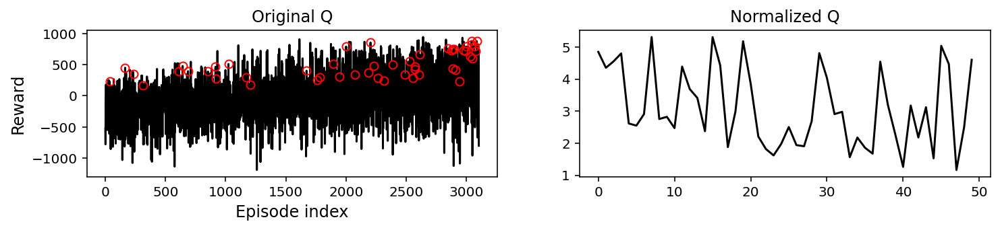

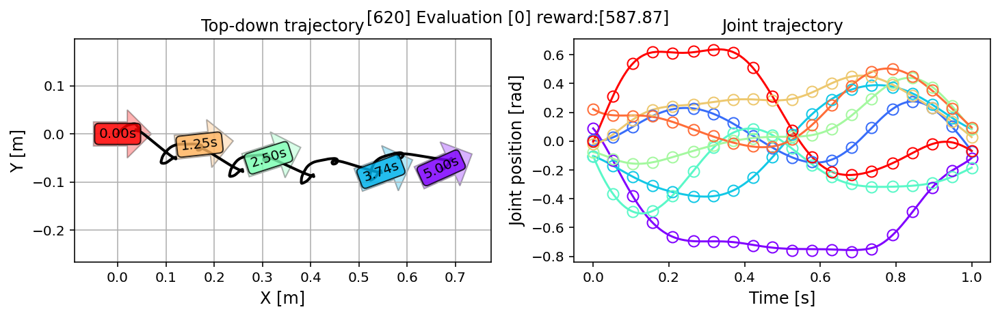

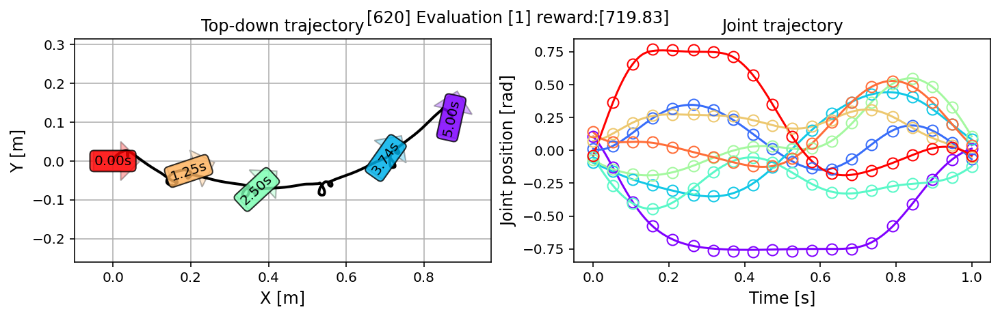

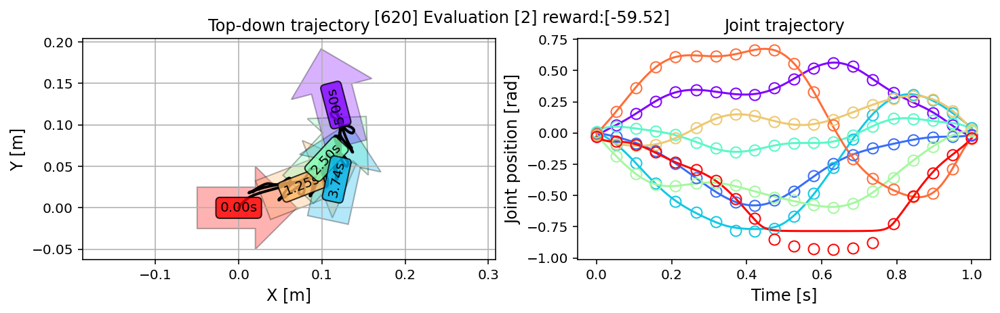

  [620/1000][Eval] reward_avg:[416.06]
[625/1000] wall:[767.04]sec. [3130] rollouts. Total loss:[0.924] (recon:[0.865] kl:[0.058])
[630/1000] wall:[773.01]sec. [3155] rollouts. Total loss:[0.869] (recon:[0.811] kl:[0.058])
[635/1000] wall:[778.92]sec. [3180] rollouts. Total loss:[1.019] (recon:[0.959] kl:[0.060])
[640/1000] wall:[784.74]sec. [3205] rollouts. Total loss:[0.879] (recon:[0.821] kl:[0.058])


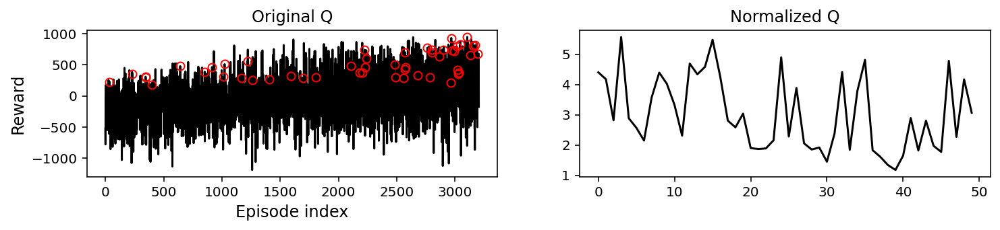

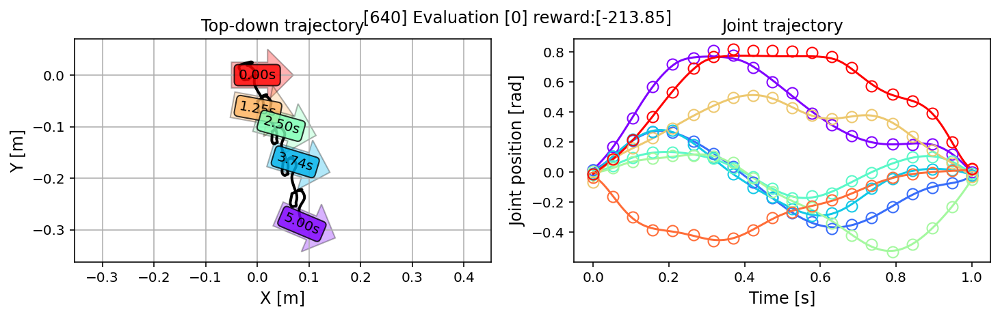

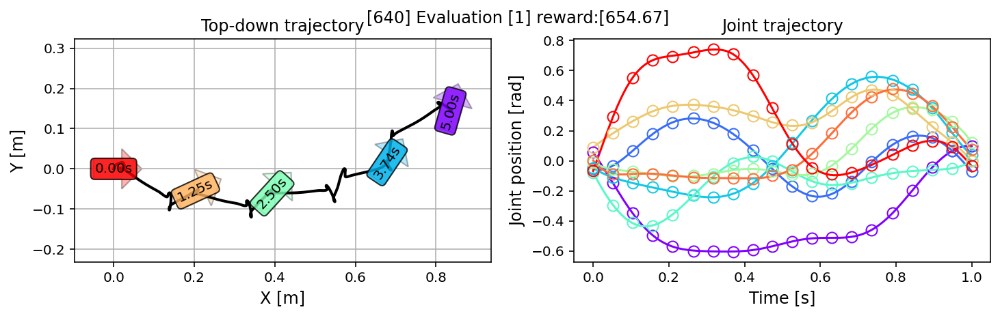

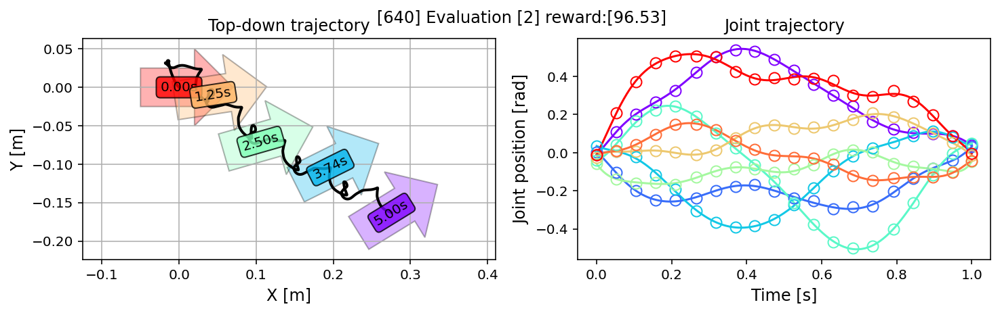

  [640/1000][Eval] reward_avg:[179.12]
[645/1000] wall:[791.68]sec. [3230] rollouts. Total loss:[0.790] (recon:[0.731] kl:[0.059])
[650/1000] wall:[797.43]sec. [3255] rollouts. Total loss:[1.038] (recon:[0.979] kl:[0.059])
[655/1000] wall:[803.16]sec. [3280] rollouts. Total loss:[0.930] (recon:[0.869] kl:[0.060])
[660/1000] wall:[808.87]sec. [3305] rollouts. Total loss:[0.935] (recon:[0.876] kl:[0.059])


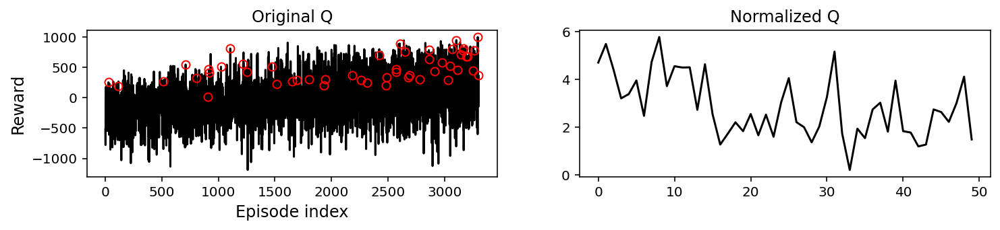

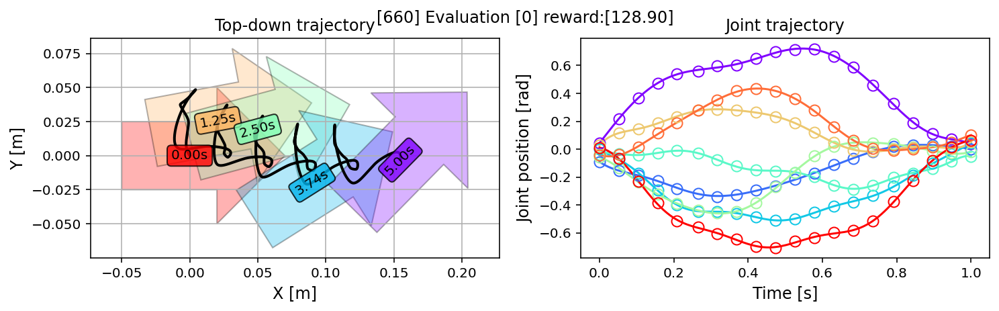

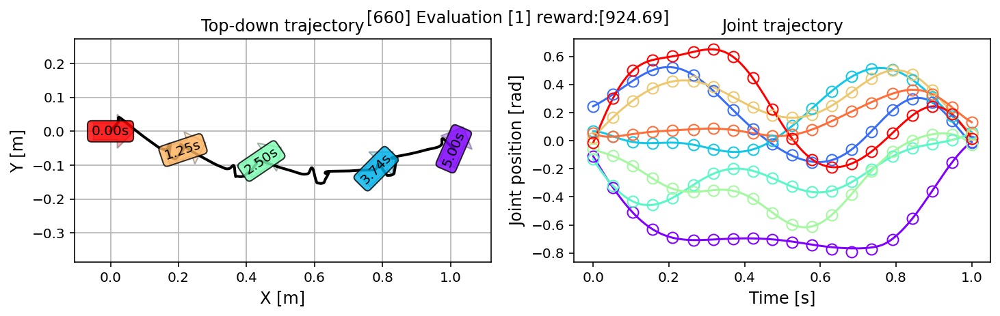

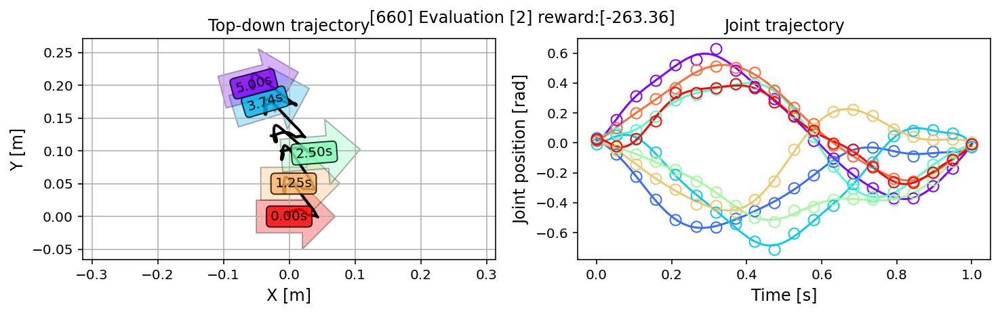

  [660/1000][Eval] reward_avg:[263.41]
[665/1000] wall:[815.97]sec. [3330] rollouts. Total loss:[0.928] (recon:[0.869] kl:[0.059])
[670/1000] wall:[821.84]sec. [3355] rollouts. Total loss:[1.027] (recon:[0.970] kl:[0.057])
[675/1000] wall:[827.54]sec. [3380] rollouts. Total loss:[0.849] (recon:[0.791] kl:[0.058])
[680/1000] wall:[833.35]sec. [3405] rollouts. Total loss:[0.900] (recon:[0.842] kl:[0.058])


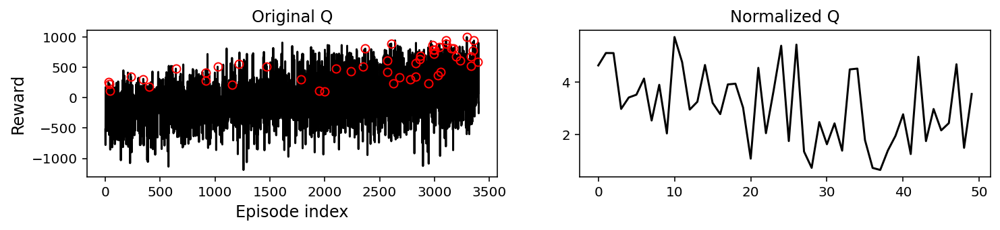

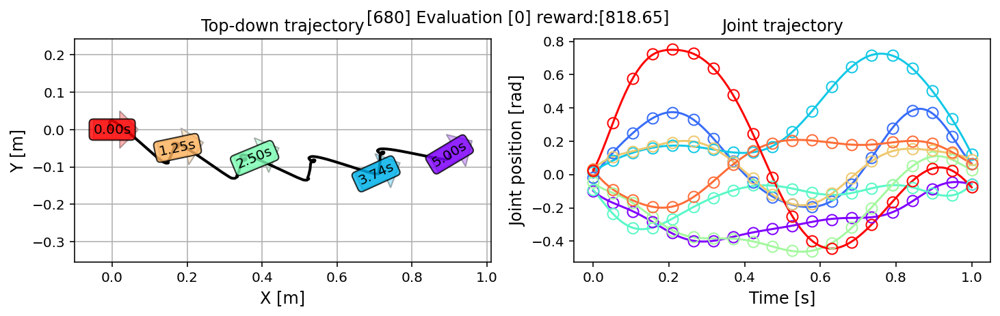

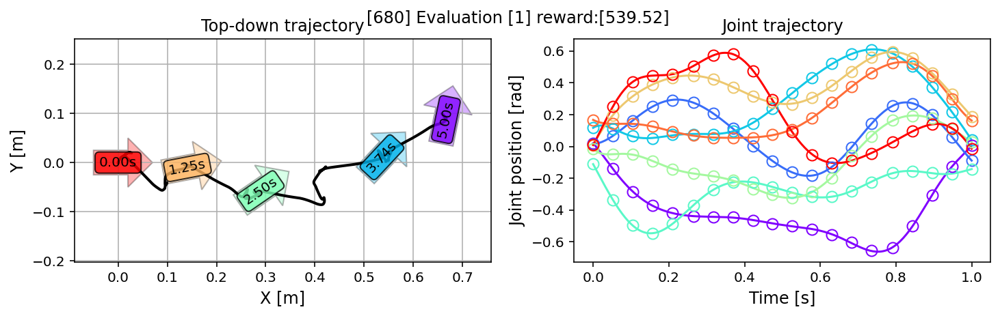

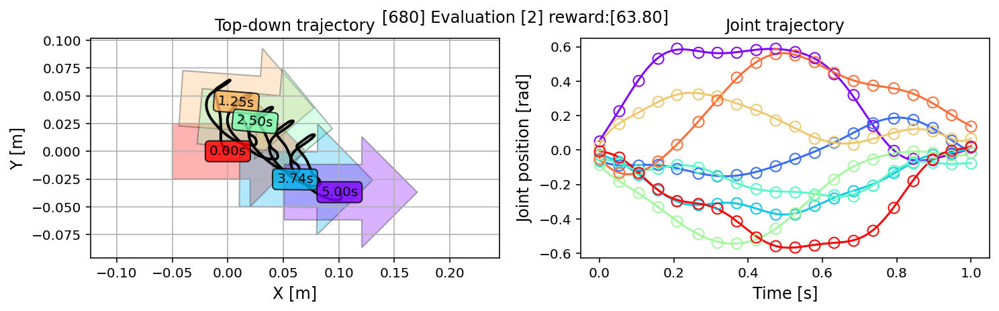

  [680/1000][Eval] reward_avg:[473.99]
[685/1000] wall:[840.31]sec. [3430] rollouts. Total loss:[0.750] (recon:[0.692] kl:[0.058])
[690/1000] wall:[846.14]sec. [3455] rollouts. Total loss:[0.929] (recon:[0.872] kl:[0.058])
[695/1000] wall:[851.98]sec. [3480] rollouts. Total loss:[0.985] (recon:[0.927] kl:[0.058])
[700/1000] wall:[857.84]sec. [3505] rollouts. Total loss:[0.963] (recon:[0.907] kl:[0.056])


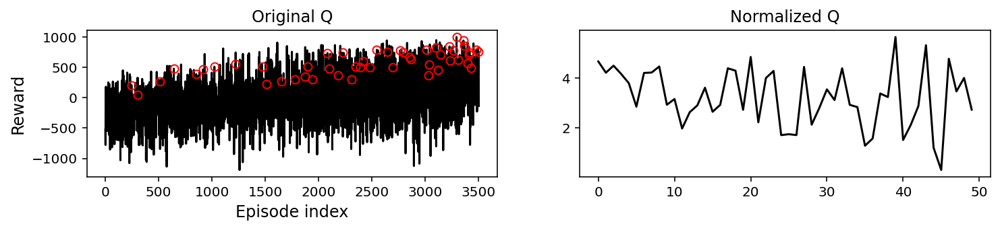

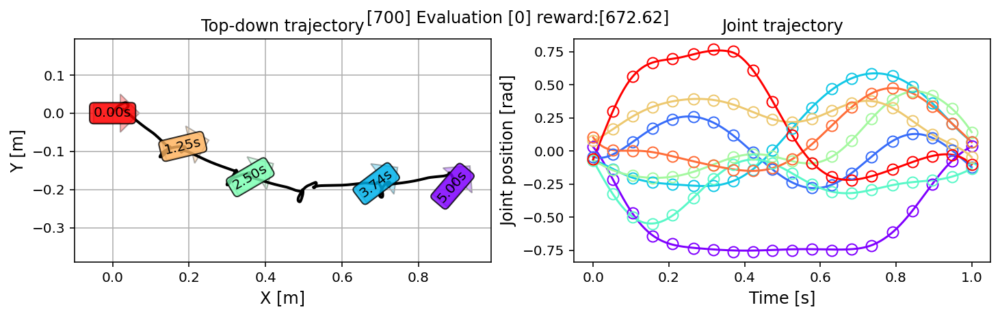

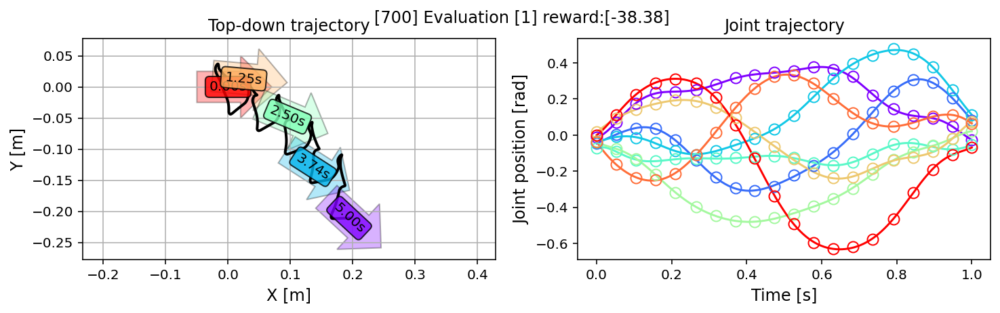

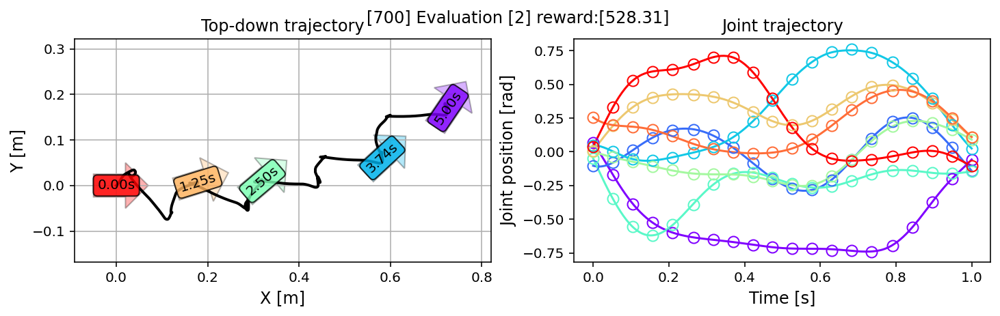

  [700/1000][Eval] reward_avg:[387.52]
[705/1000] wall:[864.75]sec. [3530] rollouts. Total loss:[0.933] (recon:[0.875] kl:[0.058])
[710/1000] wall:[870.50]sec. [3555] rollouts. Total loss:[1.086] (recon:[1.029] kl:[0.057])
[715/1000] wall:[876.27]sec. [3580] rollouts. Total loss:[0.924] (recon:[0.866] kl:[0.058])
[720/1000] wall:[882.06]sec. [3605] rollouts. Total loss:[1.021] (recon:[0.962] kl:[0.059])


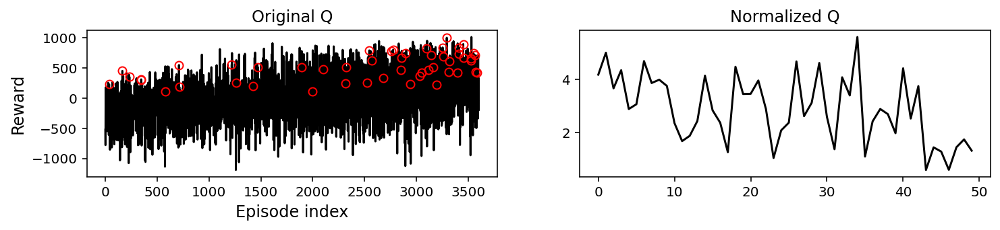

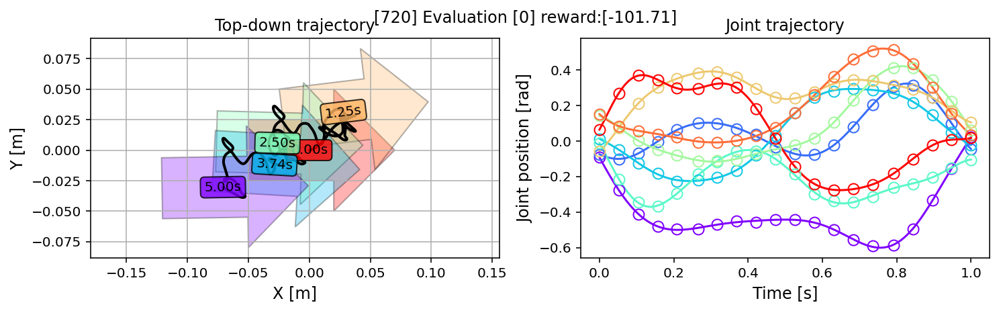

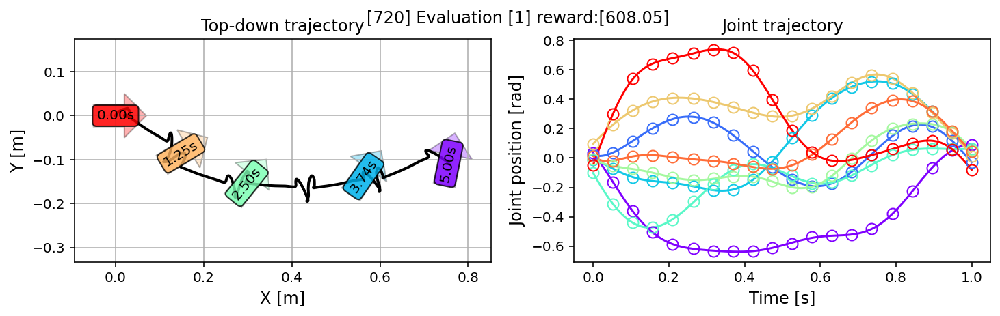

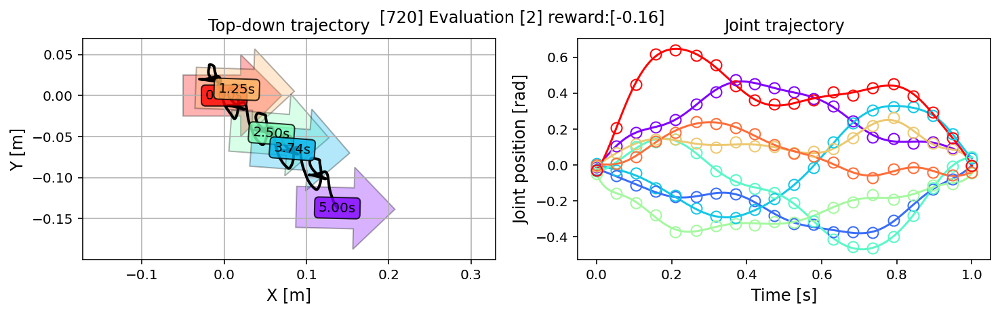

  [720/1000][Eval] reward_avg:[168.73]
[725/1000] wall:[889.14]sec. [3630] rollouts. Total loss:[0.975] (recon:[0.917] kl:[0.058])
[730/1000] wall:[895.06]sec. [3655] rollouts. Total loss:[0.925] (recon:[0.868] kl:[0.057])
[735/1000] wall:[902.08]sec. [3680] rollouts. Total loss:[0.951] (recon:[0.893] kl:[0.057])
[740/1000] wall:[908.54]sec. [3705] rollouts. Total loss:[0.995] (recon:[0.938] kl:[0.058])


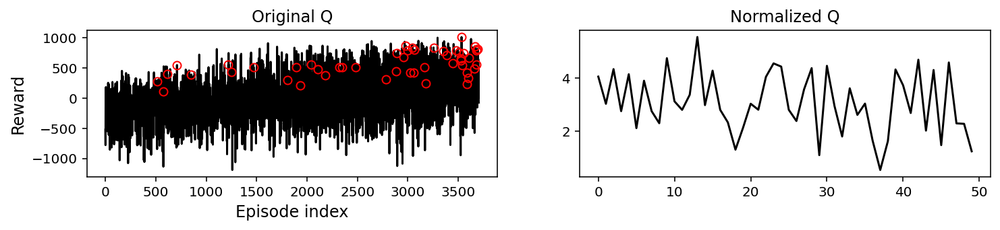

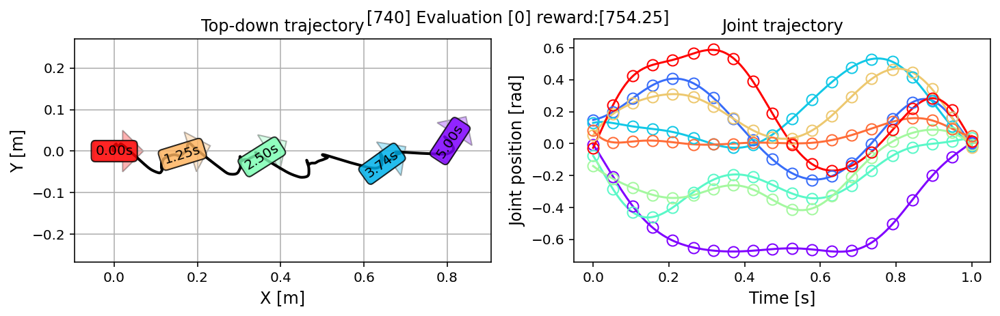

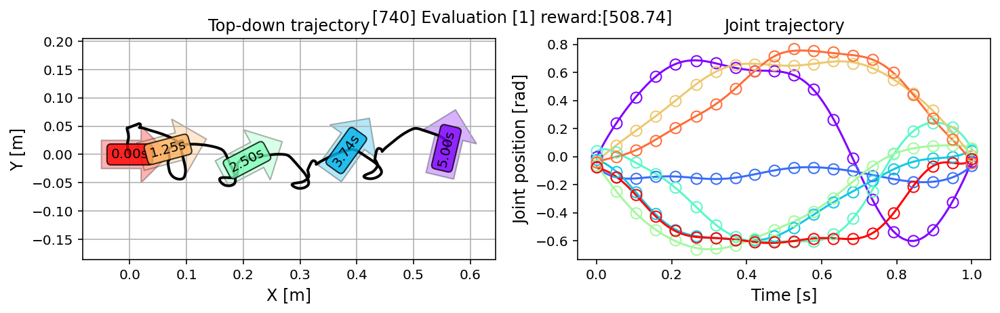

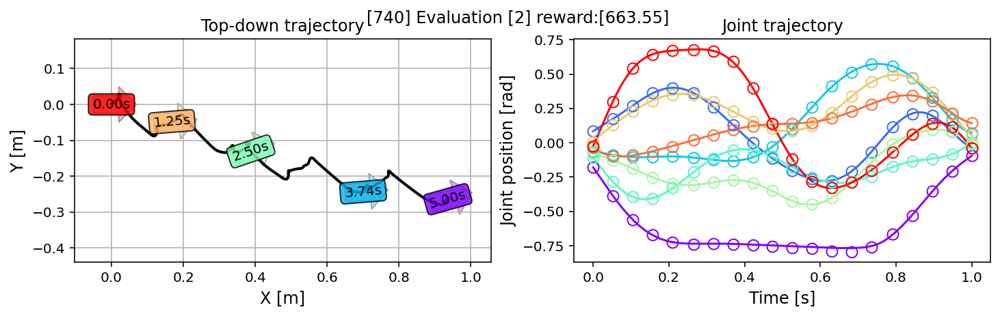

  [740/1000][Eval] reward_avg:[642.18]
[745/1000] wall:[916.49]sec. [3730] rollouts. Total loss:[1.091] (recon:[1.035] kl:[0.056])
[750/1000] wall:[922.28]sec. [3755] rollouts. Total loss:[1.136] (recon:[1.078] kl:[0.058])
[755/1000] wall:[928.07]sec. [3780] rollouts. Total loss:[0.995] (recon:[0.936] kl:[0.058])
[760/1000] wall:[933.82]sec. [3805] rollouts. Total loss:[0.959] (recon:[0.901] kl:[0.057])


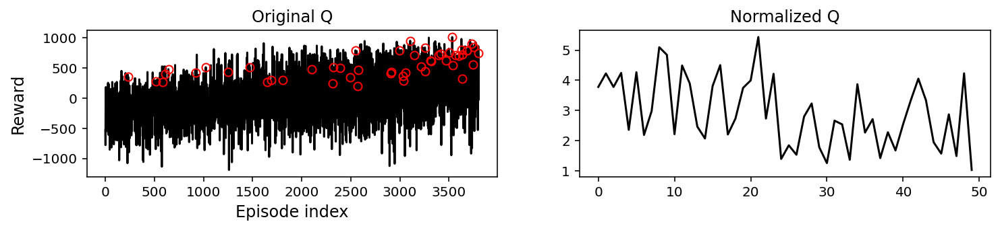

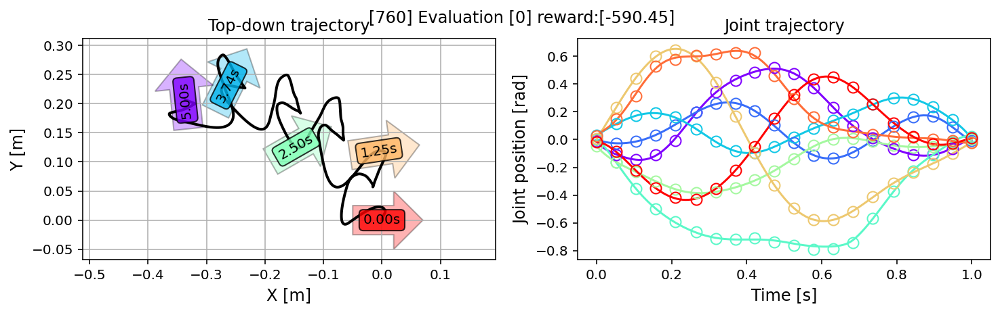

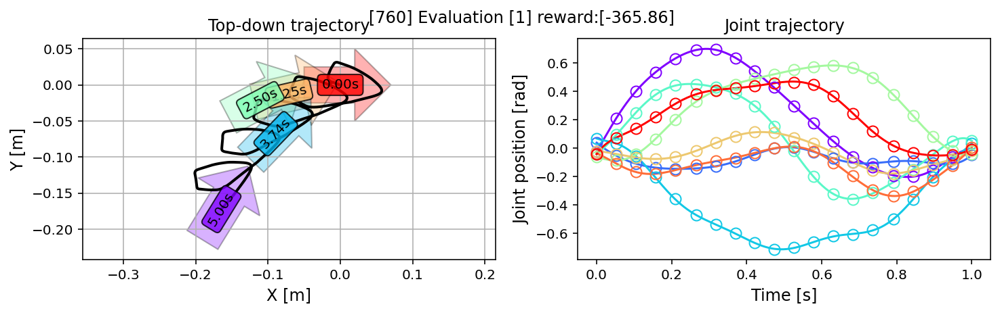

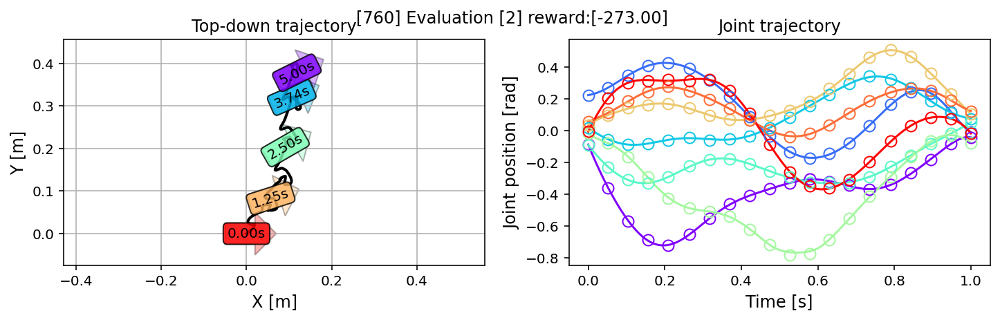

  [760/1000][Eval] reward_avg:[-409.77]
[765/1000] wall:[940.68]sec. [3830] rollouts. Total loss:[0.951] (recon:[0.892] kl:[0.059])
[770/1000] wall:[946.45]sec. [3855] rollouts. Total loss:[1.241] (recon:[1.183] kl:[0.058])
[775/1000] wall:[952.31]sec. [3880] rollouts. Total loss:[0.904] (recon:[0.847] kl:[0.057])
[780/1000] wall:[958.13]sec. [3905] rollouts. Total loss:[0.924] (recon:[0.867] kl:[0.057])


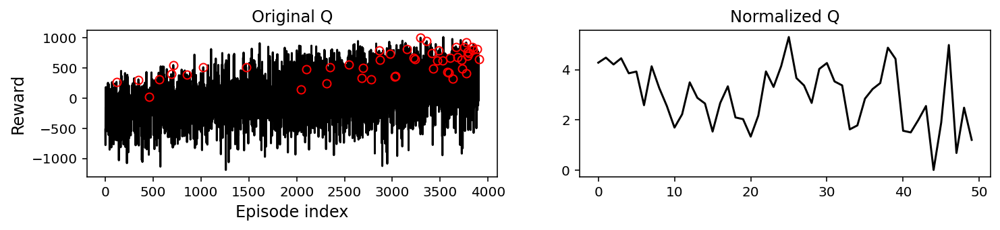

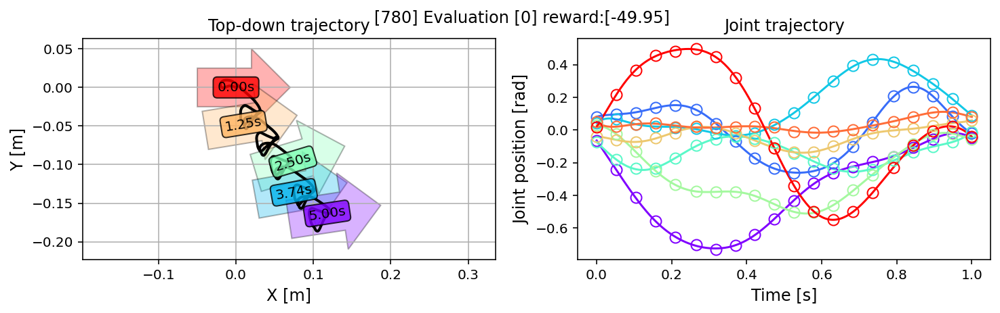

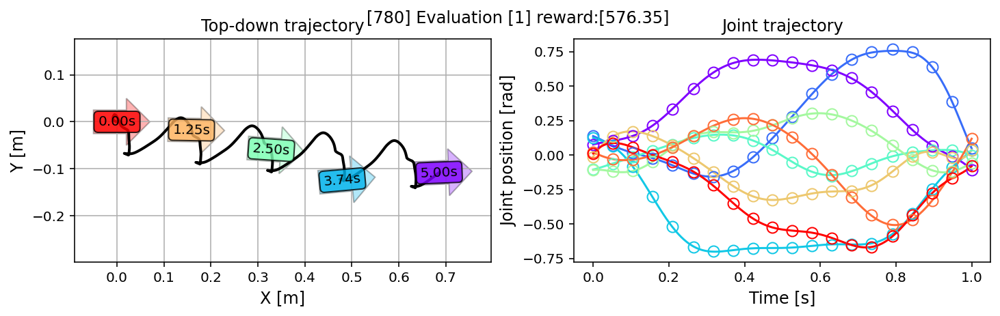

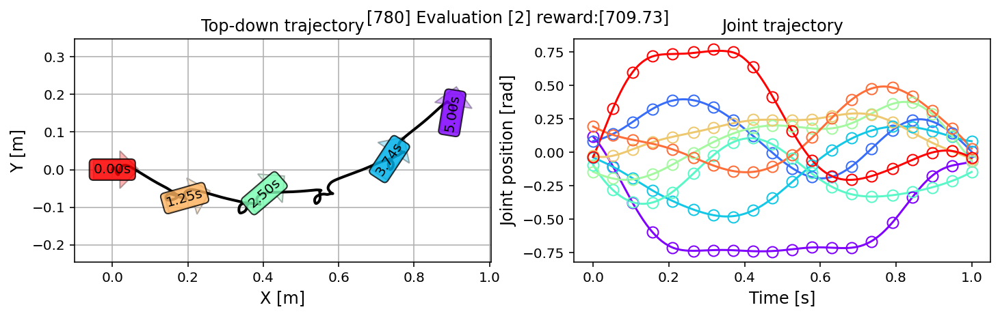

  [780/1000][Eval] reward_avg:[412.04]
[785/1000] wall:[965.26]sec. [3930] rollouts. Total loss:[0.976] (recon:[0.920] kl:[0.056])
[790/1000] wall:[970.98]sec. [3955] rollouts. Total loss:[1.146] (recon:[1.089] kl:[0.057])
[795/1000] wall:[976.77]sec. [3980] rollouts. Total loss:[0.879] (recon:[0.822] kl:[0.058])
[800/1000] wall:[982.46]sec. [4005] rollouts. Total loss:[1.022] (recon:[0.966] kl:[0.057])


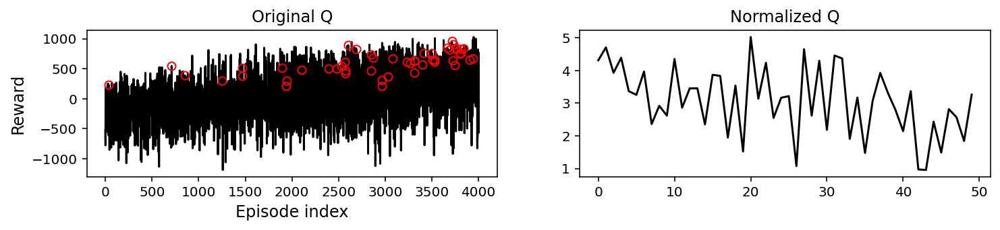

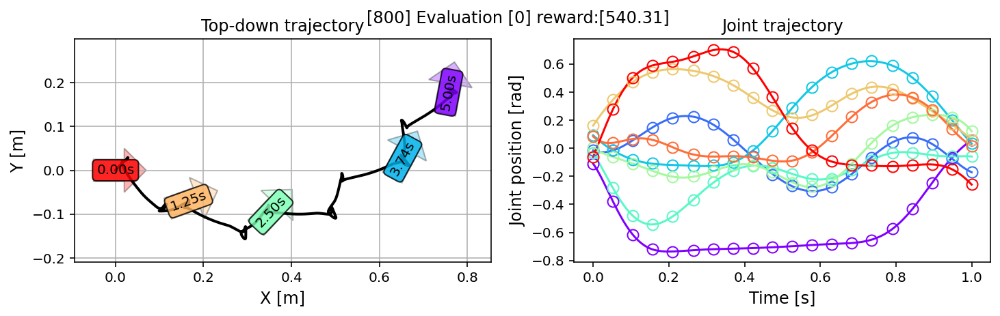

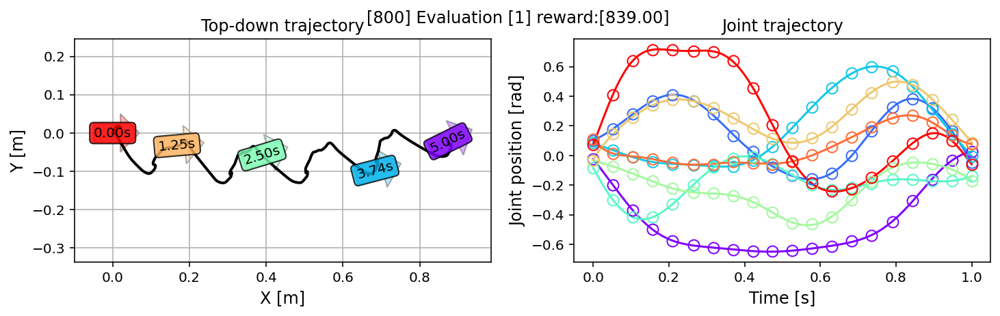

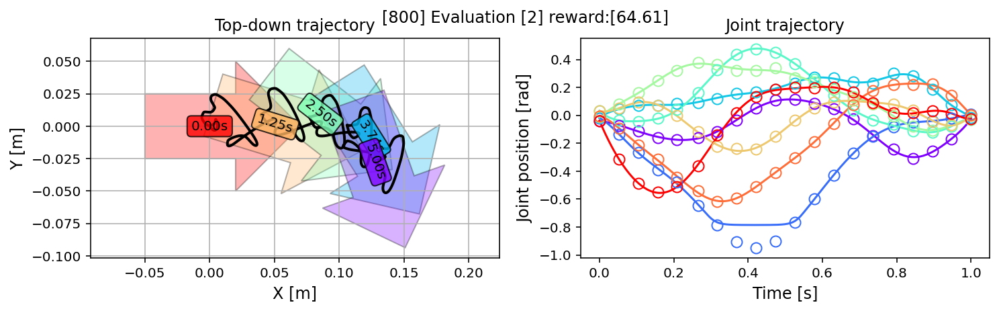

  [800/1000][Eval] reward_avg:[481.31]
[805/1000] wall:[989.38]sec. [4030] rollouts. Total loss:[0.995] (recon:[0.937] kl:[0.058])
[810/1000] wall:[995.32]sec. [4055] rollouts. Total loss:[0.901] (recon:[0.843] kl:[0.058])
[815/1000] wall:[1001.11]sec. [4080] rollouts. Total loss:[0.923] (recon:[0.866] kl:[0.057])
[820/1000] wall:[1006.78]sec. [4105] rollouts. Total loss:[0.840] (recon:[0.782] kl:[0.058])


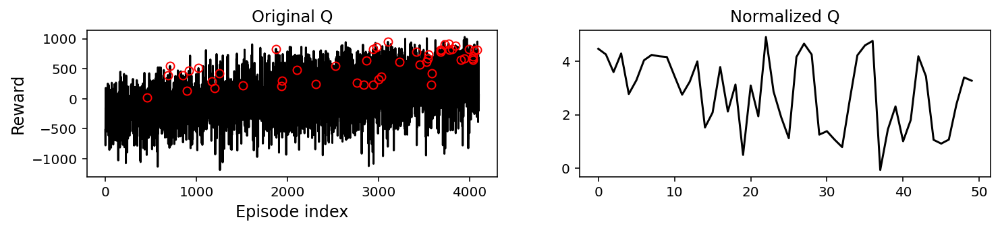

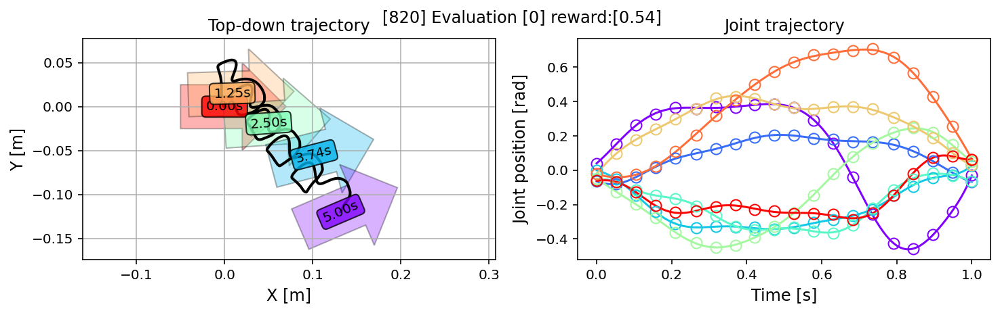

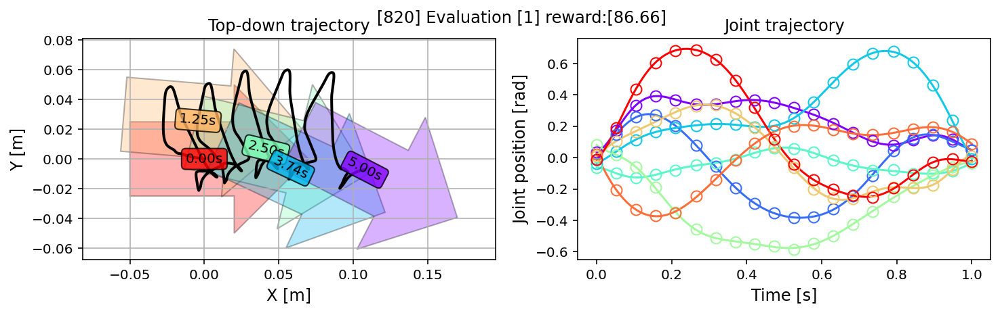

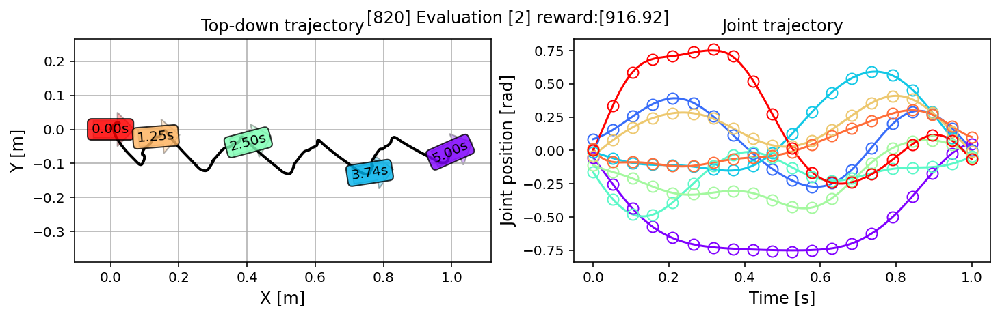

  [820/1000][Eval] reward_avg:[334.71]
[825/1000] wall:[1013.84]sec. [4130] rollouts. Total loss:[1.065] (recon:[1.008] kl:[0.056])
[830/1000] wall:[1019.52]sec. [4155] rollouts. Total loss:[1.014] (recon:[0.957] kl:[0.058])
[835/1000] wall:[1025.42]sec. [4180] rollouts. Total loss:[0.985] (recon:[0.926] kl:[0.058])
[840/1000] wall:[1031.20]sec. [4205] rollouts. Total loss:[1.020] (recon:[0.963] kl:[0.057])


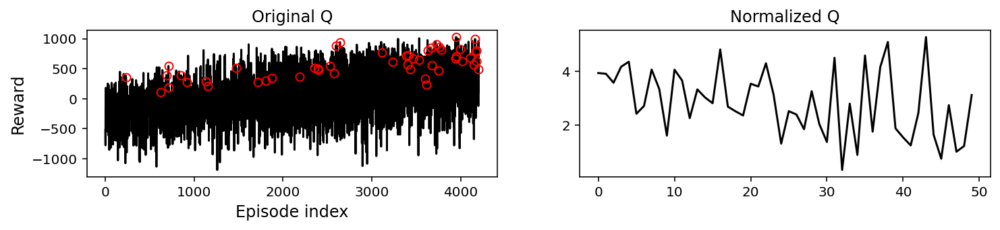

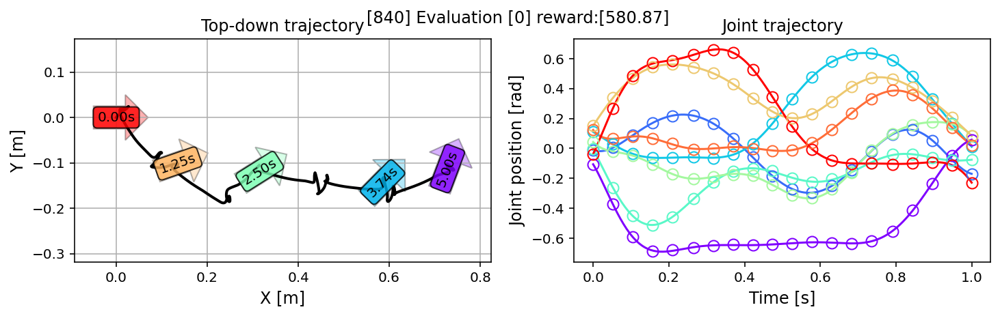

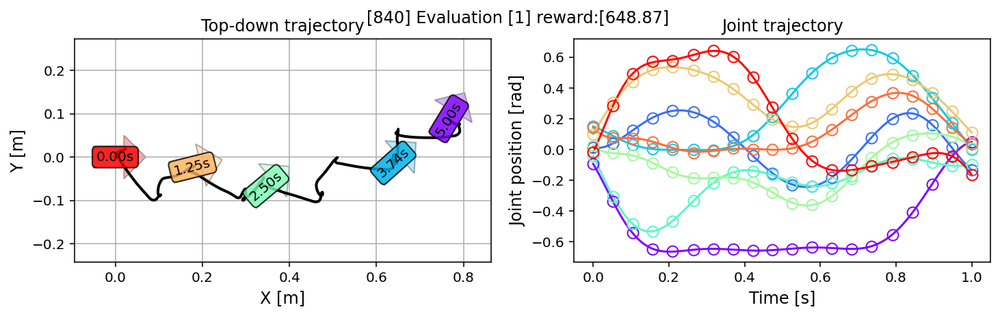

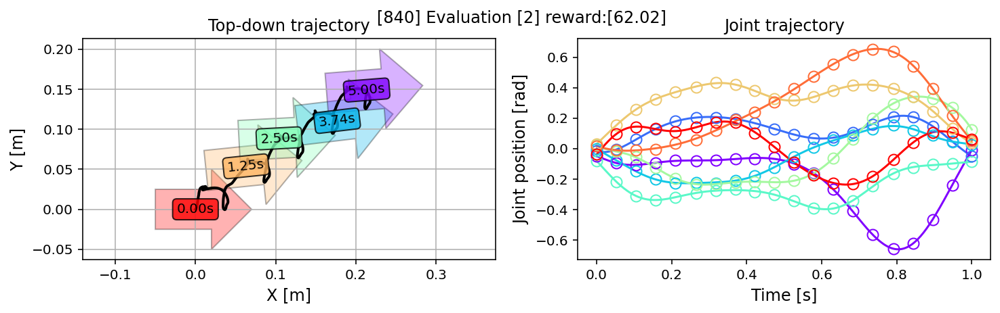

  [840/1000][Eval] reward_avg:[430.59]
[845/1000] wall:[1038.07]sec. [4230] rollouts. Total loss:[1.067] (recon:[1.010] kl:[0.057])
[850/1000] wall:[1043.76]sec. [4255] rollouts. Total loss:[1.023] (recon:[0.965] kl:[0.058])
[855/1000] wall:[1049.52]sec. [4280] rollouts. Total loss:[1.030] (recon:[0.974] kl:[0.056])
[860/1000] wall:[1055.34]sec. [4305] rollouts. Total loss:[1.192] (recon:[1.135] kl:[0.057])


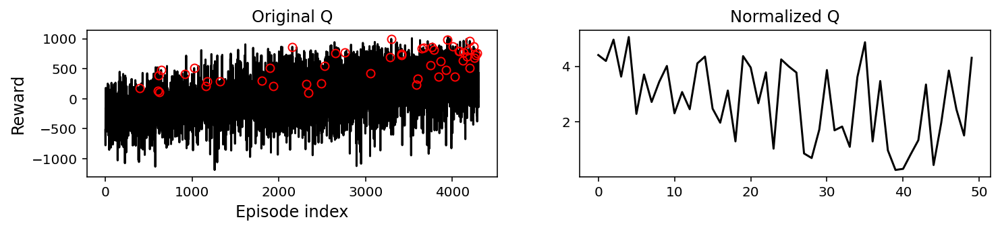

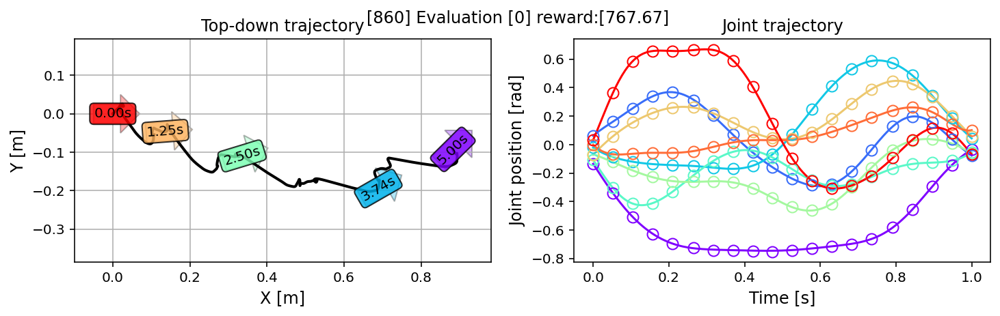

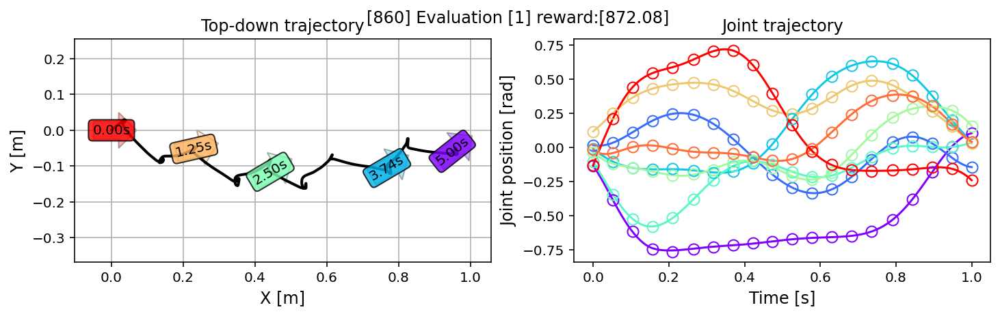

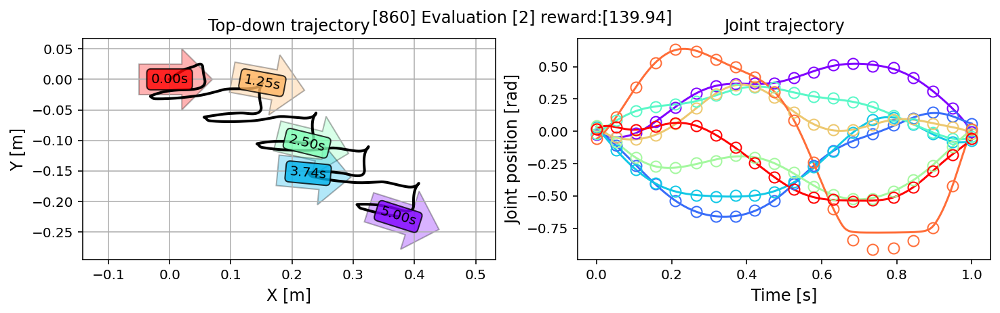

  [860/1000][Eval] reward_avg:[593.23]
[865/1000] wall:[1062.24]sec. [4330] rollouts. Total loss:[0.952] (recon:[0.895] kl:[0.057])
[870/1000] wall:[1068.06]sec. [4355] rollouts. Total loss:[1.128] (recon:[1.071] kl:[0.057])
[875/1000] wall:[1073.85]sec. [4380] rollouts. Total loss:[1.069] (recon:[1.012] kl:[0.057])
[880/1000] wall:[1079.66]sec. [4405] rollouts. Total loss:[1.060] (recon:[1.003] kl:[0.057])


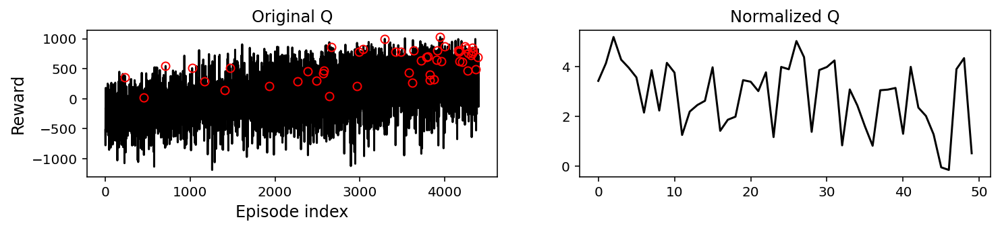

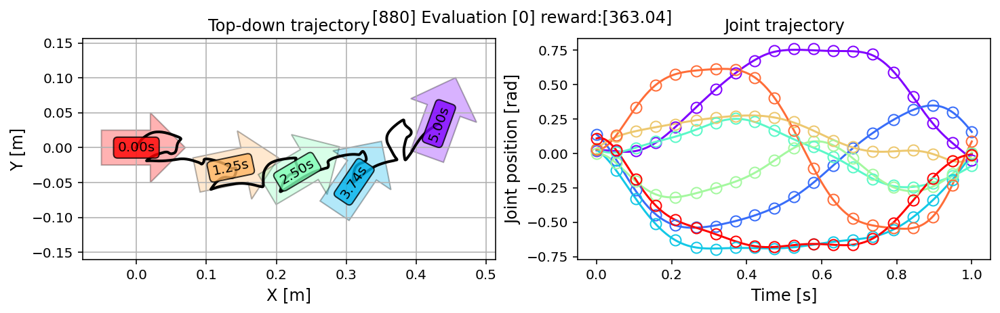

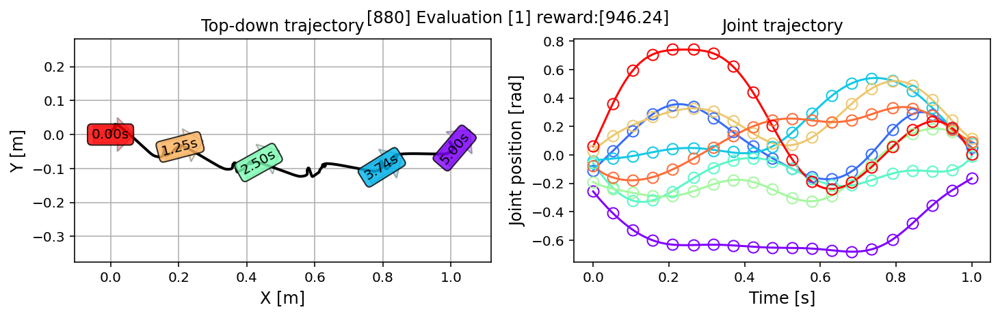

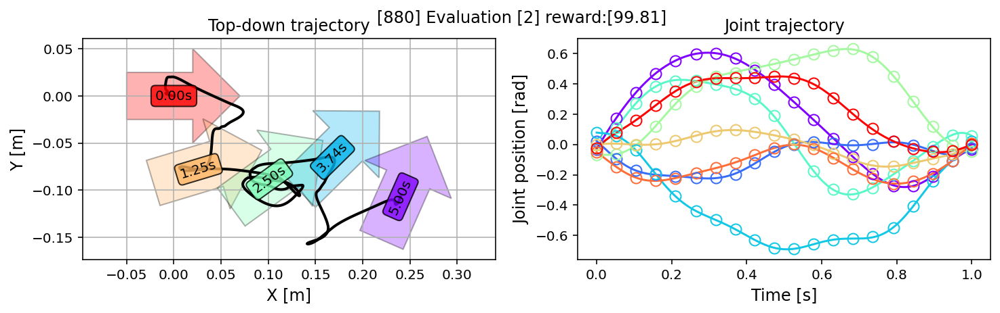

  [880/1000][Eval] reward_avg:[469.70]
[885/1000] wall:[1086.72]sec. [4430] rollouts. Total loss:[1.031] (recon:[0.974] kl:[0.057])
[890/1000] wall:[1092.63]sec. [4455] rollouts. Total loss:[1.134] (recon:[1.078] kl:[0.057])
[895/1000] wall:[1098.58]sec. [4480] rollouts. Total loss:[1.122] (recon:[1.065] kl:[0.057])
[900/1000] wall:[1104.40]sec. [4505] rollouts. Total loss:[1.009] (recon:[0.952] kl:[0.057])


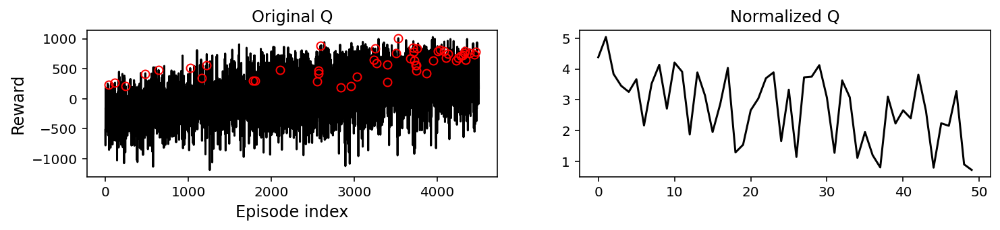

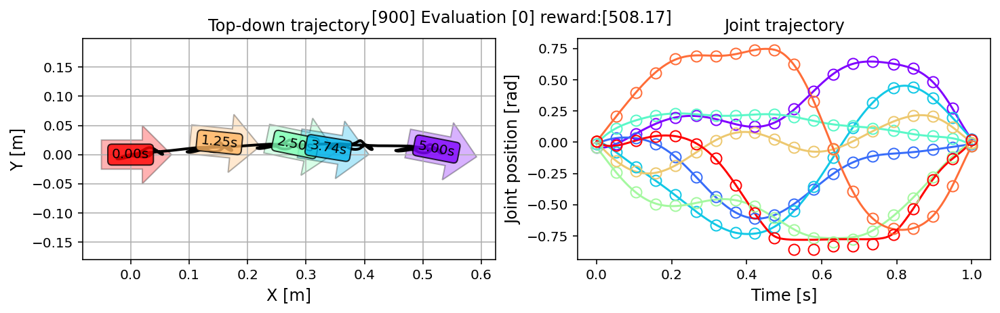

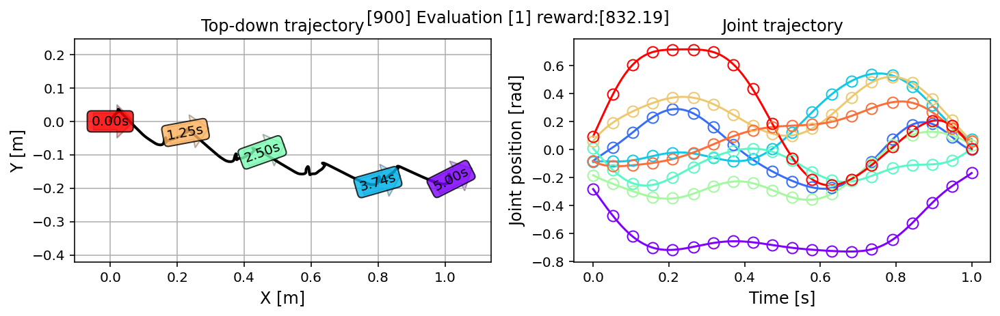

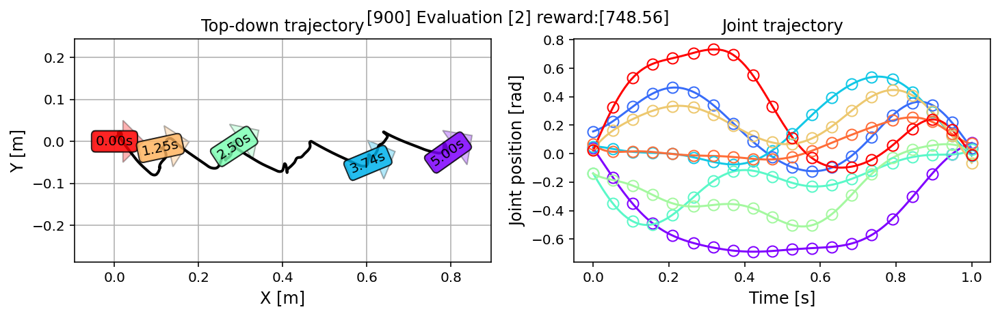

  [900/1000][Eval] reward_avg:[696.31]
[905/1000] wall:[1111.23]sec. [4530] rollouts. Total loss:[1.140] (recon:[1.083] kl:[0.056])
[910/1000] wall:[1116.96]sec. [4555] rollouts. Total loss:[0.999] (recon:[0.940] kl:[0.059])
[915/1000] wall:[1122.79]sec. [4580] rollouts. Total loss:[0.932] (recon:[0.875] kl:[0.057])
[920/1000] wall:[1128.73]sec. [4605] rollouts. Total loss:[0.969] (recon:[0.913] kl:[0.056])


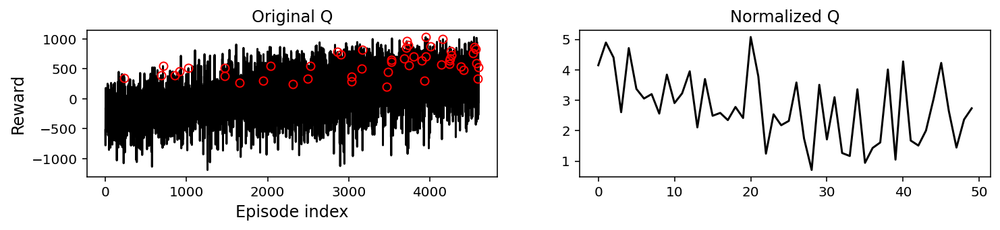

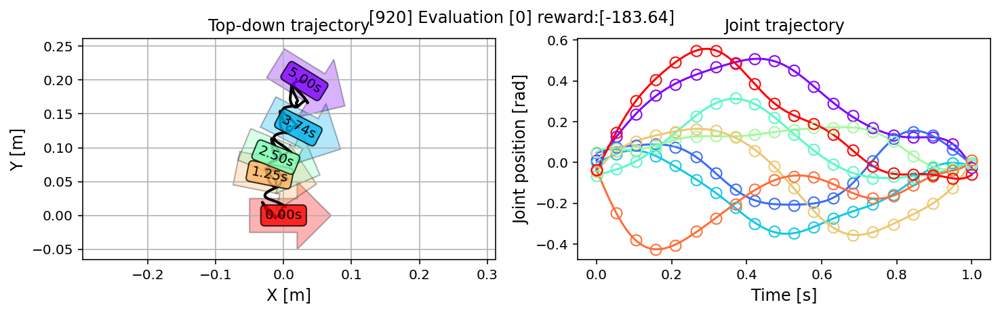

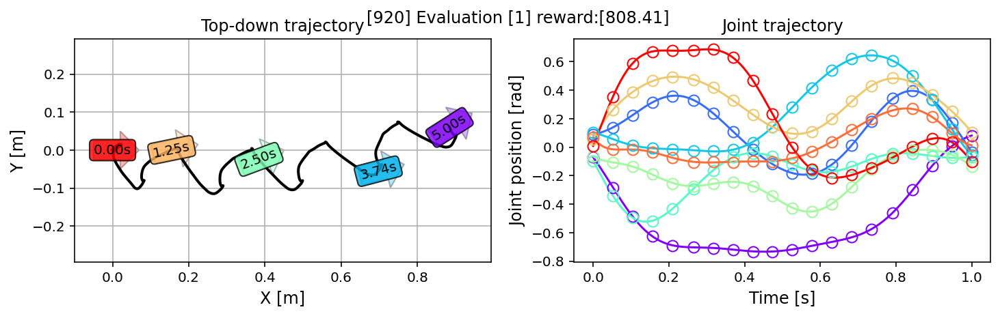

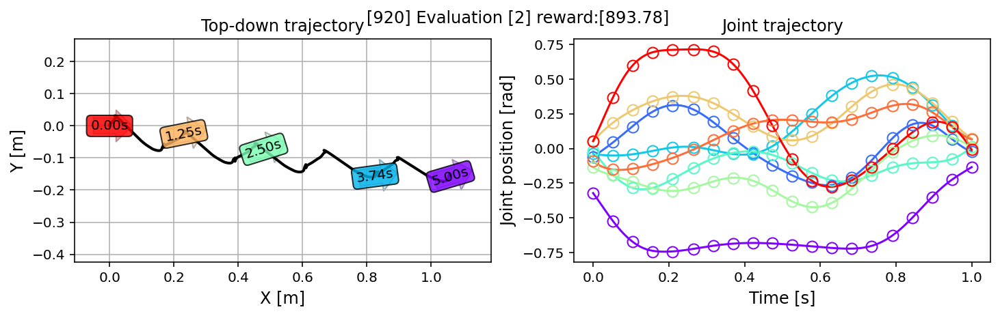

  [920/1000][Eval] reward_avg:[506.18]
[925/1000] wall:[1135.72]sec. [4630] rollouts. Total loss:[0.984] (recon:[0.927] kl:[0.057])
[930/1000] wall:[1141.43]sec. [4655] rollouts. Total loss:[1.039] (recon:[0.983] kl:[0.056])
[935/1000] wall:[1147.23]sec. [4680] rollouts. Total loss:[1.042] (recon:[0.985] kl:[0.057])
[940/1000] wall:[1153.08]sec. [4705] rollouts. Total loss:[1.092] (recon:[1.036] kl:[0.056])


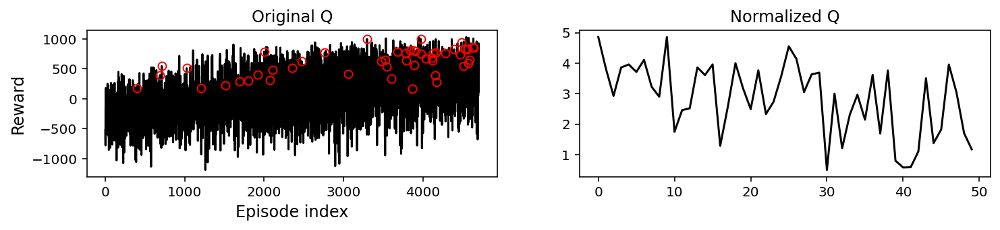

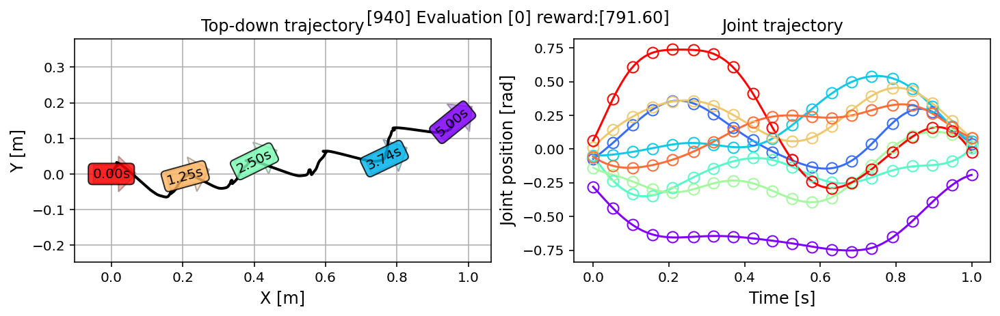

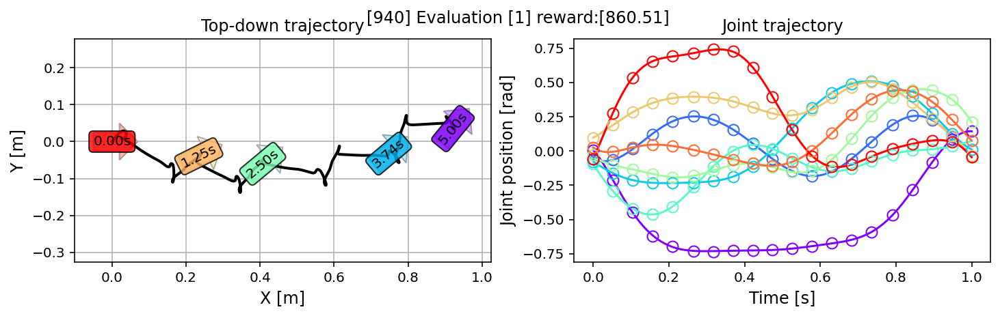

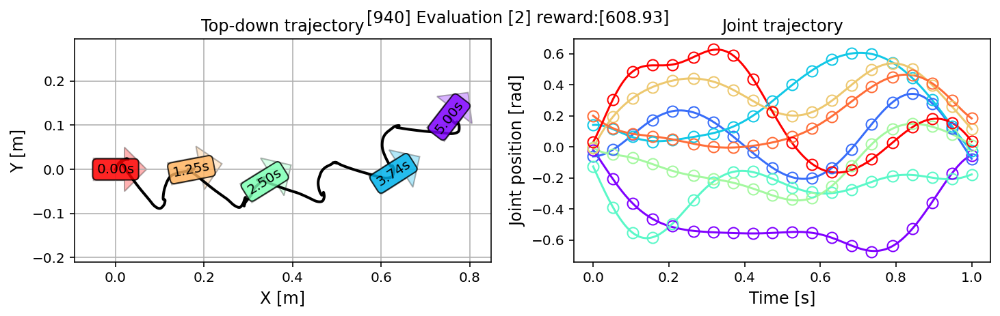

  [940/1000][Eval] reward_avg:[753.68]
[945/1000] wall:[1160.09]sec. [4730] rollouts. Total loss:[1.040] (recon:[0.984] kl:[0.057])
[950/1000] wall:[1165.82]sec. [4755] rollouts. Total loss:[1.106] (recon:[1.049] kl:[0.057])
[955/1000] wall:[1171.67]sec. [4780] rollouts. Total loss:[1.198] (recon:[1.141] kl:[0.057])
[960/1000] wall:[1177.45]sec. [4805] rollouts. Total loss:[0.930] (recon:[0.873] kl:[0.058])


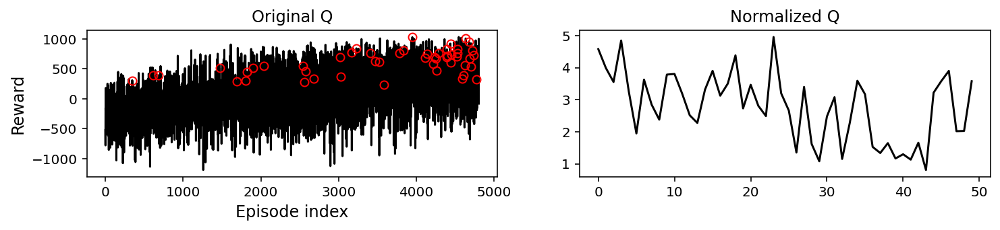

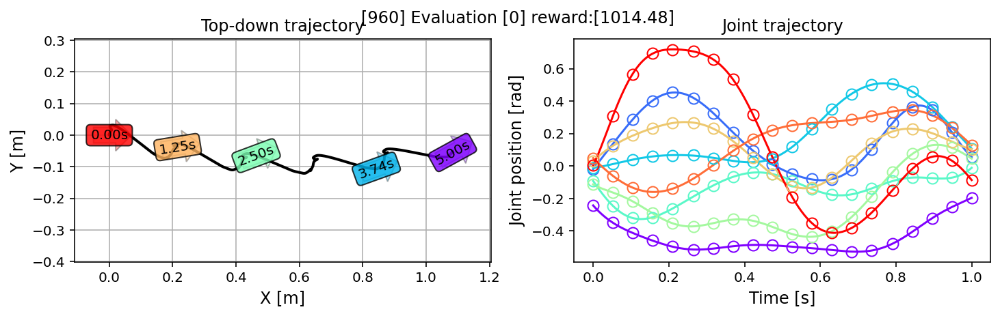

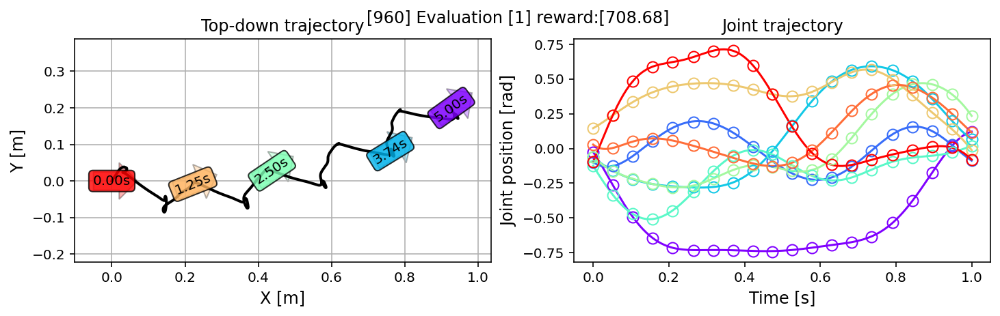

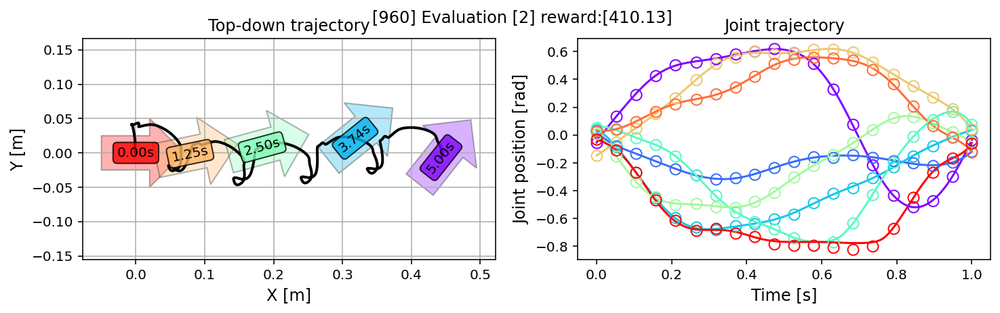

  [960/1000][Eval] reward_avg:[711.10]
[965/1000] wall:[1184.49]sec. [4830] rollouts. Total loss:[0.857] (recon:[0.800] kl:[0.058])
[970/1000] wall:[1190.23]sec. [4855] rollouts. Total loss:[0.993] (recon:[0.936] kl:[0.056])
[975/1000] wall:[1196.17]sec. [4880] rollouts. Total loss:[0.987] (recon:[0.929] kl:[0.058])
[980/1000] wall:[1202.21]sec. [4905] rollouts. Total loss:[1.022] (recon:[0.965] kl:[0.057])


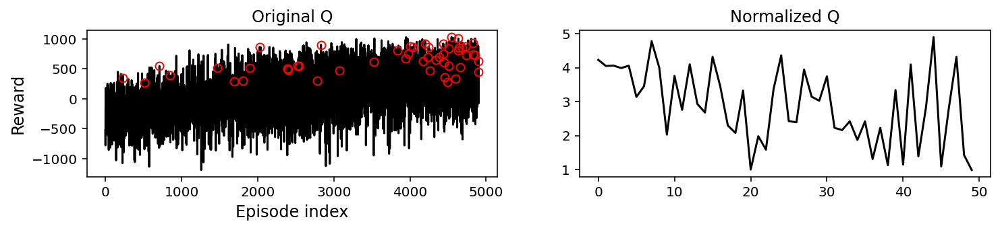

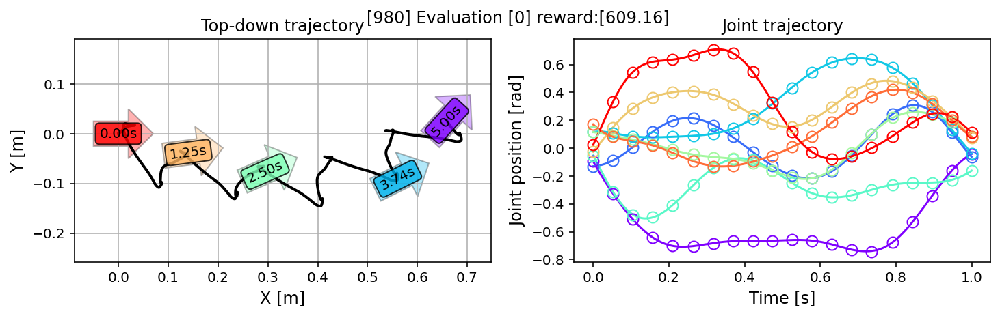

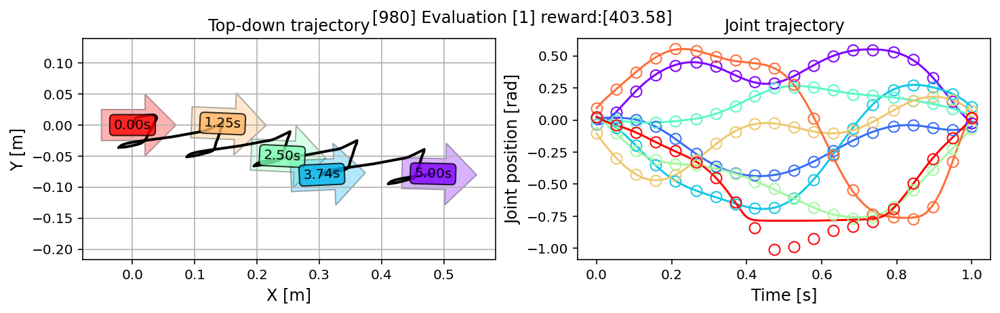

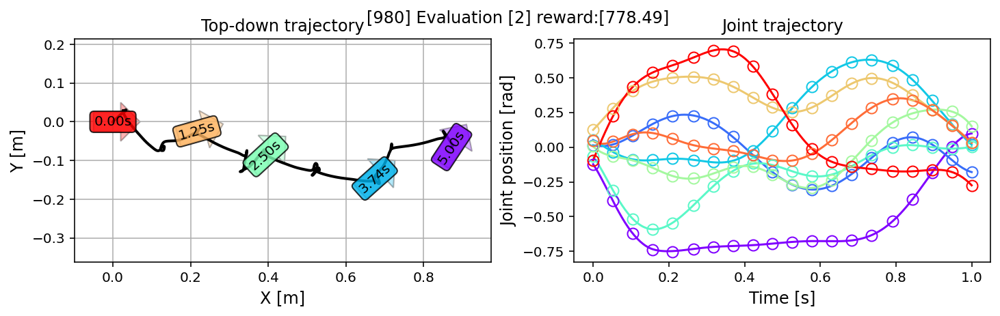

  [980/1000][Eval] reward_avg:[597.08]
[985/1000] wall:[1209.28]sec. [4930] rollouts. Total loss:[1.038] (recon:[0.981] kl:[0.057])
[990/1000] wall:[1215.27]sec. [4955] rollouts. Total loss:[1.123] (recon:[1.066] kl:[0.057])
[995/1000] wall:[1221.30]sec. [4980] rollouts. Total loss:[1.114] (recon:[1.058] kl:[0.055])
Done.


In [5]:
DLPG.init_params(seed=0)
tic = TicTocClass()
buffer = []
for update_idx in range(n_update):
    zero_to_one,one_to_zero = (update_idx/max(1,n_update-1)),1.0-(update_idx/max(1,n_update-1))
    for rollout_idx in range(n_rollout_per_update):
        exploration_rate = 0.5*one_to_zero
        if (np.random.rand()<=exploration_rate) or (update_idx==0): # exploration
            traj_joints,traj_secs = GRP_prior.sample_one_traj(
                rand_type='Gaussian',ss_x_min=ss_range[:,0],ss_x_max=ss_range[:,1],ss_margin=ss_margin)
        else:
            x_recon_np  = torch2np(DLPG.sample_x(c=None,n_sample=1,SKIP_Z_SAMPLE=True))
            x_anchor    = X_NZR.get_org_data(x_recon_np).reshape((n_anchor,env.n_torque))
            traj_joints = GRP_posterior.lev_interpolate(
                t_anchor=t_anchor,x_anchor=x_anchor,t_test=traj_secs,hyp={'g':1/10,'l':1/4,'w':1e-8},lev_val=0.95,
                x_min=ss_range[:,0],x_max=ss_range[:,1],margin=ss_margin)
        # Rollout
        res = snapbot_rollout(env,PID,traj_joints,n_traj_repeat=n_traj_repeat,DO_RENDER=False)
        reward = get_snapbot_reward(res['xyrad_list'],
                                    fwd_gain=fwd_gain,side_penalty=side_penalty,rot_penalty=rot_penalty)
        t_anchor,x_anchor = get_anchors_from_traj(traj_secs,traj_joints,n_anchor=n_anchor) # [20 x 1], [20 x 8]
        buffer.append({'t_anchor':t_anchor,'x_anchor':x_anchor,'reward':reward})
    # Accumulate buffer
    x_data,q_data = np.zeros(shape=(len(buffer),env.n_torque*n_anchor)),np.zeros(shape=(len(buffer)))
    for idx in range(len(buffer)):
        x_data[idx,:],q_data[idx] = buffer[idx]['x_anchor'].reshape((1,-1)),buffer[idx]['reward']
    # Normalize
    if (len(x_data)<=500): X_NZR = NormalizerClass(name='X',x=x_data)
    x_data_nzd = X_NZR.get_nzd_data(x_data)
    q_data_nzd = 2*whitening(q_data)
    # Select subset
    if len(x_data) > n_dpp_subset:
        _,idxs_ikdpp = ikdpp(xs_total=x_data_nzd,qs_total=0.1*q_data_nzd,n_select=n_dpp_subset,
                             n_trunc=100,hyp={'g':1.0,'l':10.0})
        x_data_nzd_trim,q_data_nzd_trim = x_data_nzd[idxs_ikdpp,:],q_data_nzd[idxs_ikdpp]
    else:
        x_data_nzd_trim,q_data_nzd_trim = x_data_nzd,q_data_nzd
    # Update DLPG
    x_data_nzd_torch,q_data_nzd_torch = np2torch(x_data_nzd_trim),np2torch(q_data_nzd_trim)
    loss_recon_sum,loss_kl_sum,n_batch_sum = 0.0,0.0,0
    for it in range(n_iter_per_update):
        if it >= (n_iter_per_update//2): beta = 0.01 
        else: beta = 0.0
        batch_idx = np.random.permutation(len(x_data_nzd_torch))[:batch_size]
        x_batch_torch,q_batch_torch = x_data_nzd_torch[batch_idx,:],q_data_nzd_torch[batch_idx]
        if Q_RENORMALIZE: q_batch_torch = 2*whitening_torch(q_batch_torch) # (optional)
        n_batch = x_batch_torch.shape[0]
        # Update
        total_loss_out,loss_info = DLPG.loss_total(
            x=x_batch_torch,c=None,q=q_batch_torch,LOSS_TYPE='L1+L2',
            recon_loss_gain=10.0,beta=beta,STOCHASTICITY=True)
        optm.zero_grad(); total_loss_out.backward(); optm.step() # update
        loss_recon_sum = loss_recon_sum + n_batch*loss_info['loss_recon_out']
        loss_kl_sum    = loss_kl_sum + n_batch*loss_info['loss_kl_out']
        n_batch_sum    = n_batch_sum + n_batch
    loss_recon_avg,loss_kl_avg = (loss_recon_sum/n_batch_sum),(loss_kl_sum/n_batch_sum)
    # Print
    if (update_idx%print_every_update)==0:
        print ("[%d/%d] wall:[%.2f]sec. [%d] rollouts. Total loss:[%.3f] (recon:[%.3f] kl:[%.3f])"%
               (update_idx,n_update,tic.toc(),len(buffer),
                loss_recon_avg+loss_kl_avg,loss_recon_avg,loss_kl_avg))
    # Evaluate
    if (update_idx%evaluate_every_update)==0:
        # Plot reward history
        plt.figure(figsize=(12,2))
        plt.subplot(1,2,1); ticks = np.arange(0,len(q_data),1); plt.plot(ticks,q_data,'-',color='k');
        plt.xlabel('Episode index',fontsize=12); plt.ylabel('Reward',fontsize=12)
        if len(x_data) > n_dpp_subset: plt.plot(ticks[idxs_ikdpp],q_data[idxs_ikdpp],'o',color='r',mfc='none');
        plt.title('Original Q',fontsize=12); plt.ylabel('Reward',fontsize=12)
        plt.subplot(1,2,2); plt.plot(q_data_nzd_trim,'-',color='k'); plt.title('Normalized Q',fontsize=12); 
        plt.show()
        # Evaluate
        reward_sum = 0.0
        for e_idx in range(n_rollout_per_eval):
            # Rollout
            x_recon_np  = torch2np(DLPG.sample_x(c=None,n_sample=1,SKIP_Z_SAMPLE=True)) # [1 x 160]
            x_anchor    = X_NZR.get_org_data(x_recon_np).reshape((n_anchor,env.n_torque))
            traj_joints = GRP_posterior.lev_interpolate(
                t_anchor=t_anchor,x_anchor=x_anchor,t_test=traj_secs,hyp={'g':1,'l':1/4,'w':1e-8},lev_val=1.0,
                x_min=ss_range[:,0],x_max=ss_range[:,1],margin=ss_margin)
            res_eval = snapbot_rollout(
                env,PID,traj_joints,n_traj_repeat=n_traj_repeat,DO_RENDER=DO_RENDER_WHILE_EVAL)
            reward   = get_snapbot_reward(
                res_eval['xyrad_list'],fwd_gain=fwd_gain,side_penalty=side_penalty,rot_penalty=rot_penalty)
            reward_sum = reward_sum + reward
            # Plot top-down torso and joint trajectories
            plot_topdown_trajectory_and_joint_trajectory(
                res_eval['sec_list'],res_eval['xyrad_list'],cm=plt.cm.rainbow_r,
                traj_secs=traj_secs,traj_joints=traj_joints,
                t_anchor=t_anchor,x_anchor=x_anchor,
                figsize=(12,3),title_str='[%d] Evaluation [%d] reward:[%.2f]'%(update_idx,e_idx,reward))
        reward_avg = reward_sum/n_rollout_per_eval
        print ("  [%d/%d][Eval] reward_avg:[%.2f]"%(update_idx,n_update,reward_avg))
print ("Done.")

In [10]:
# Rollout
x_recon_np  = torch2np(DLPG.sample_x(c=None,n_sample=1,SKIP_Z_SAMPLE=True)) # [1 x 160]
x_anchor    = X_NZR.get_org_data(x_recon_np).reshape((n_anchor,env.n_torque))
traj_joints = GRP_posterior.lev_interpolate(
    t_anchor=t_anchor,x_anchor=x_anchor,t_test=traj_secs,hyp={'g':1,'l':1/4,'w':1e-8},lev_val=1.0,
    x_min=ss_range[:,0],x_max=ss_range[:,1],margin=ss_margin)
res_eval = snapbot_rollout(
    env,PID,traj_joints,n_traj_repeat=n_traj_repeat,DO_RENDER=True)

Creating window glfw


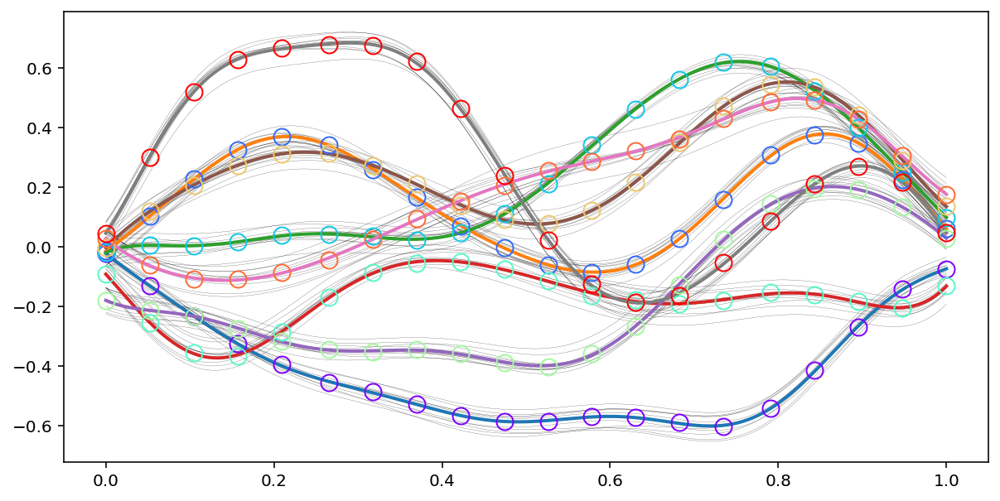

In [6]:
# Check how the leveraged interolation works 
x_recon_np  = torch2np(DLPG.sample_x(c=None,n_sample=1,SKIP_Z_SAMPLE=True))
x_anchor    = X_NZR.get_org_data(x_recon_np).reshape((n_anchor,env.n_torque))
traj_joints_list = []
for _ in range(10):
    traj_joints = GRP_posterior.lev_interpolate(
        t_anchor=t_anchor,x_anchor=x_anchor,t_test=traj_secs,hyp={'g':1/10,'l':1/4,'w':1e-8},lev_val=0.95,
        x_min=ss_range[:,0],x_max=ss_range[:,1],margin=ss_margin)
    traj_joints_list.append(traj_joints)
mean_traj   = GRP_posterior.mean_test
# Plot
plt.figure(figsize=(10,5))
for i_idx in range(10):
    traj_joints = traj_joints_list[i_idx]
    plt.plot(traj_secs,traj_joints,'-',lw=0.1,color='k')
plt.plot(traj_secs,mean_traj,'-',lw=2)
colors = get_colors(traj_joints.shape[1])
for i_idx in range(x_anchor.shape[1]):
    color = colors[i_idx]
    plt.plot(t_anchor,x_anchor[:,i_idx],'o',color=color,ms=10,mfc='none')
plt.show()